# TFG. Detección de anomalías en contaminación del aire. 
#### Lucía Carro Arcaya

## Carga de librerías

In [92]:
import os
import json
import math
import folium
import random
import calendar
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import tensorflow as tf
import matplotlib.pyplot as plt
from datetime import datetime
from pmdarima import auto_arima
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import make_scorer, f1_score, ConfusionMatrixDisplay, confusion_matrix
from sklearn.model_selection import ParameterGrid, TimeSeriesSplit, GridSearchCV
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import precision_score, recall_score, f1_score
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, RepeatVector
from tensorflow.keras.callbacks import EarlyStopping

import warnings
warnings.filterwarnings('ignore')

## Carga de datos preprocesados

In [2]:
datos_d_global = pd.read_csv("datos_procesados/datos_d_global.csv", index_col=0, parse_dates=True)
datos_h_global = pd.read_csv("datos_procesados/datos_h_global.csv", index_col=0, parse_dates=True)
datos_d_estacion = pd.read_csv("datos_procesados/datos_d_estacion.csv", index_col=0, parse_dates=True)
datos_h_estacion = pd.read_csv("datos_procesados/datos_h_estacion.csv", index_col=0, parse_dates=True)
datos_index = pd.read_csv("datos_procesados/datos_index.csv", index_col=0, parse_dates=True)
localizaciones = pd.read_csv("datos_procesados/localizaciones.csv", index_col=0, parse_dates=True)

In [3]:
datos_d_estacion = datos_d_estacion.drop(['NOValue', 'NOXValue', 'PM10CorrectionFactor' ,'PM10Value', 'PM10ValueFull', 'PM1Value'], axis = 1)

## Umbral de anomalías

### Umbrales estadísticos

Con el objetivo de identificar posibles valores atípicos en las series temporales de contaminantes atmosféricos (NO₂, PM₂.₅, O₃ y SO₂), se implementaron tres métodos estadísticos de detección de anomalías basados en umbrales dinámicos: la regla de los tres sigmas (Z-score), el percentil 95 y la regla de Hampel. Estos métodos fueron seleccionados por su capacidad de identificar observaciones significativamente diferentes del comportamiento habitual de los datos, sin necesidad de contar con límites normativos fijos, y por su amplio uso en análisis exploratorios robustos.

- Regla de los 3 sigmas (Z-score): Esta técnica se basa en la suposición de una distribución aproximadamente normal de los datos. Se considera anómalo cualquier valor que se desvíe en más de tres desviaciones estándar respecto a la media. Este umbral permite capturar eventos estadísticamente extremos, aunque puede verse afectado por la presencia de valores atípicos que influyen en la media y la desviación.

- Percentil 95: Este enfoque define como anómalos aquellos valores que se sitúan por encima del percentil 95 de la distribución de cada contaminante. Dado que este umbral depende únicamente del orden de los datos, es especialmente útil en series no gaussianas, aunque tiende a etiquetar como anómalos un número constante de observaciones (el 5% superior), lo que puede llevar a una sobreidentificación de outliers en contextos con variabilidad estacional natural.

- Regla de Hampel: A diferencia de los anteriores, este método se basa en estadísticas robustas: la mediana y el valor absoluto de las desviaciones respecto a la mediana (MAD, Median Absolute Deviation). Se consideran anomalías aquellos valores que se desvían en más de tres MADs de la mediana. Este enfoque es especialmente adecuado para series con distribuciones sesgadas o valores extremos, ya que no se ve afectado por outliers a la hora de calcular los parámetros de referencia.

- Regla del Boxplot (IQR): Esta técnica se basa en el cálculo del rango intercuartílico (IQR), que es la distancia entre el primer cuartil (Q1) y el tercer cuartil (Q3) de la distribución de los datos. Se considera anómalo cualquier valor que esté fuera del rango definido por los límites inferior y superior, calculados como:

    - Límite inferior = Q1 - 1.5 * IQR
    - Límite superior = Q3 + 1.5 * IQR
    
    Esta técnica es robusta frente a valores extremos, ya que no depende de la media o la desviación estándar, y se adapta bien a distribuciones no normales, siendo especialmente útil para detectar outliers en datos con colas largas o distribuciones sesgadas.

Cada uno de estos métodos se aplicó tanto a nivel global (conjuntando todos los datos de todas las estaciones) como a nivel individual por estación, con el fin de capturar anomalías relativas al comportamiento típico local de cada zona de medición. Esto resulta clave para discriminar correctamente los picos anómalos que podrían pasar desapercibidos si se usara un único umbral común a toda la ciudad.

El empleo de distintos enfoques permite comparar la sensibilidad y especificidad de cada método, con vistas a elegir el más adecuado para construir modelos supervisados de clasificación de eventos anómalos.

In [4]:
# Bloque 1: Detección mediante umbrales estadísticos (3 sigmas, percentil 95, regla de Hampel)

# Copiar los DataFrames originales para no modificarlos directamente
df_global = datos_d_global.copy()
df_estacion = datos_d_estacion.copy()

# Lista de columnas de contaminantes a analizar
contaminantes = ['NO2Value', 'PM25Value', 'O3Value', 'SO2Value']

# 1. Regla de los 3 sigmas (media ± 3 * desviación estándar)
# Calcula umbral global y por estación, y marca valores anómalos en nuevas columnas *_anom_sigma
for col in contaminantes:
    # Umbral global (sobre todos los datos)
    media = df_global[col].mean(skipna=True)
    std = df_global[col].std(skipna=True)
    if pd.isna(media) or pd.isna(std):
        # Si no hay datos válidos, marca todos como no anómalos (False)
        df_global[f'{col}_anom_sigma'] = False
    else:
        df_global[f'{col}_anom_sigma'] = ((df_global[col] - media).abs() > 3 * std)
    # Umbral por estación (grupo por estación)
    # Suponemos que existe una columna 'Station' o equivalente para identificar la estación
    df_estacion[f'{col}_anom_sigma'] = False  # Inicializa la columna como False por defecto
    for estacion in df_estacion['entityId'].unique():
        mask = df_estacion['entityId'] == estacion
        media_est = df_estacion.loc[mask, col].mean(skipna=True)
        std_est = df_estacion.loc[mask, col].std(skipna=True)
        if pd.isna(media_est) or pd.isna(std_est):
            # Si no hay datos válidos en esta estación, mantener False (no marcar anomalías)
            continue
        # Marca True si valor se desvía más de 3*std de la media de su estación
        df_estacion.loc[mask, f'{col}_anom_sigma'] = ((df_estacion.loc[mask, col] - media_est).abs() > 3 * std_est)

# 2. Percentil 95 como umbral superior
# Calcula el percentil 95 global y por estación, marca valores anómalos en columnas *_anom_percentil
for col in contaminantes:
    # Umbral global (percentil 95 de todos los datos)
    if df_global[col].dropna().empty:
        umbral_95 = np.nan
    else:
        umbral_95 = df_global[col].quantile(0.95, interpolation='linear')
    if pd.isna(umbral_95):
        df_global[f'{col}_anom_percentil'] = False
    else:
        df_global[f'{col}_anom_percentil'] = df_global[col] > umbral_95
    # Umbral por estación (percentil 95 dentro de cada estación)
    df_estacion[f'{col}_anom_percentil'] = False  # Inicializa la columna
    for estacion in df_estacion['entityId'].unique():
        mask = df_estacion['entityId'] == estacion
        datos_est = df_estacion.loc[mask, col].dropna()
        if datos_est.empty:
            umbral_95_est = np.nan
        else:
            umbral_95_est = datos_est.quantile(0.95, interpolation='linear')
        if pd.isna(umbral_95_est):
            # Sin datos en esta estación, continuar
            continue
        df_estacion.loc[mask, f'{col}_anom_percentil'] = df_estacion.loc[mask, col] > umbral_95_est

# 3. Regla de Hampel (mediana ± 3 * MAD)
# Calcula mediana y MAD global y por estación, marca valores anómalos en columnas *_anom_hampel
for col in contaminantes:
    # Umbral global (mediana ± 3*MAD)
    mediana = df_global[col].median(skipna=True)
    mad = (df_global[col] - mediana).abs().median(skipna=True)
    if pd.isna(mediana) or pd.isna(mad):
        df_global[f'{col}_anom_hampel'] = False
    else:
        umbral_sup = mediana + 3 * mad
        umbral_inf = mediana - 3 * mad
        df_global[f'{col}_anom_hampel'] = (df_global[col] > umbral_sup) | (df_global[col] < umbral_inf)
    # Umbral por estación (mediana ± 3*MAD por estación)
    df_estacion[f'{col}_anom_hampel'] = False  # Inicializa la columna
    for estacion in df_estacion['entityId'].unique():
        mask = df_estacion['entityId'] == estacion
        mediana_est = df_estacion.loc[mask, col].median(skipna=True)
        mad_est = (df_estacion.loc[mask, col] - mediana_est).abs().median(skipna=True)
        if pd.isna(mediana_est) or pd.isna(mad_est):
            continue
        umbral_sup_est = mediana_est + 3 * mad_est
        umbral_inf_est = mediana_est - 3 * mad_est
        df_estacion.loc[mask, f'{col}_anom_hampel'] = (df_estacion.loc[mask, col] > umbral_sup_est) | (df_estacion.loc[mask, col] < umbral_inf_est)

# 4. Regla del Boxplot (IQR: Q1 - 1.5*IQR, Q3 + 1.5*IQR)
# Detecta valores anómalos usando los límites de Tukey (regla del IQR)
for col in contaminantes:
    # Umbral global
    Q1 = df_global[col].quantile(0.25)
    Q3 = df_global[col].quantile(0.75)
    IQR = Q3 - Q1
    if pd.isna(Q1) or pd.isna(Q3):
        df_global[f'{col}_anom_iqr'] = False
    else:
        lim_inf = Q1 - 1.5 * IQR
        lim_sup = Q3 + 1.5 * IQR
        df_global[f'{col}_anom_iqr'] = (df_global[col] < lim_inf) | (df_global[col] > lim_sup)

    # Umbral por estación
    df_estacion[f'{col}_anom_iqr'] = False
    for estacion in df_estacion['entityId'].unique():
        mask = df_estacion['entityId'] == estacion
        Q1_est = df_estacion.loc[mask, col].quantile(0.25)
        Q3_est = df_estacion.loc[mask, col].quantile(0.75)
        IQR_est = Q3_est - Q1_est
        if pd.isna(Q1_est) or pd.isna(Q3_est):
            continue
        lim_inf_est = Q1_est - 1.5 * IQR_est
        lim_sup_est = Q3_est + 1.5 * IQR_est
        df_estacion.loc[mask, f'{col}_anom_iqr'] = (df_estacion.loc[mask, col] < lim_inf_est) | (df_estacion.loc[mask, col] > lim_sup_est)

In [5]:
def comparar_metodos_anomalias(df, variable, titulo_base="Global"):
    metodos = {
        'anom_sigma': 'Z-Score (3σ)',
        'anom_percentil': 'Percentil 0.95',
        'anom_hampel': 'Regla de Hampel',
        'anom_iqr': 'Regla del Boxplot'
    }

    fig, axes = plt.subplots(2, 2, figsize=(15, 8), sharex=True)
    axes = axes.flatten()

    for i, (col_suffix, metodo_name) in enumerate(metodos.items()):
        col_anom = f"{variable}_{col_suffix}"
        if col_anom not in df.columns:
            axes[i].set_visible(False)
            continue

        axes[i].plot(df.index, df[variable], label='Valor diario', color='lightgray', zorder=1)
        anom = df[df[col_anom]]
        axes[i].scatter(anom.index, anom[variable], color='red', label='Anomalía', s=25, zorder=2)

        axes[i].set_title(f"{metodo_name}", fontsize=11)
        axes[i].set_ylabel("µg/m³")
        axes[i].grid(True, linestyle='--', alpha=0.4)
        if i >= 2:
            axes[i].set_xlabel("Fecha")

    fig.suptitle(f"{variable} - Comparación de métodos de detección ({titulo_base})", fontsize=14)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Tras ejecutar este bloque, df_global y df_estacion contendrán las nuevas columnas de anomalías estadísticas.


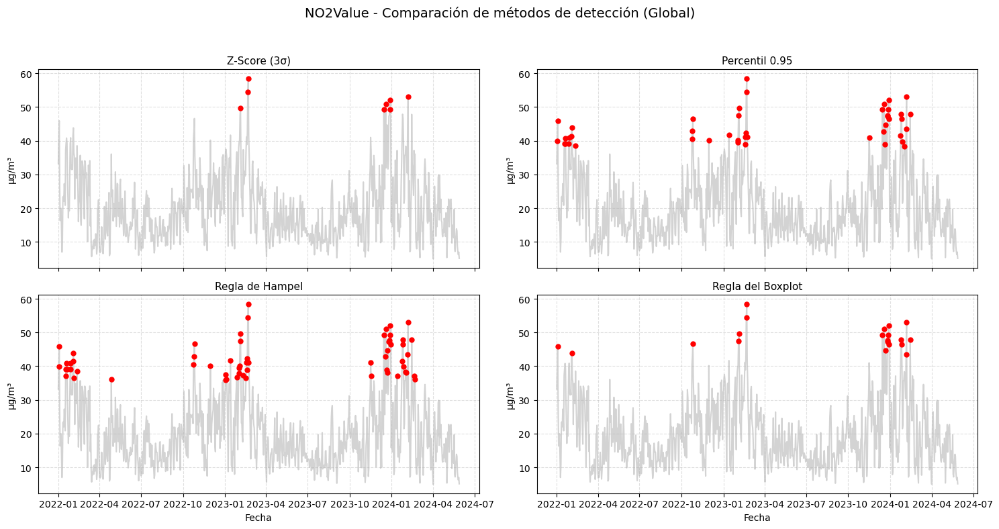

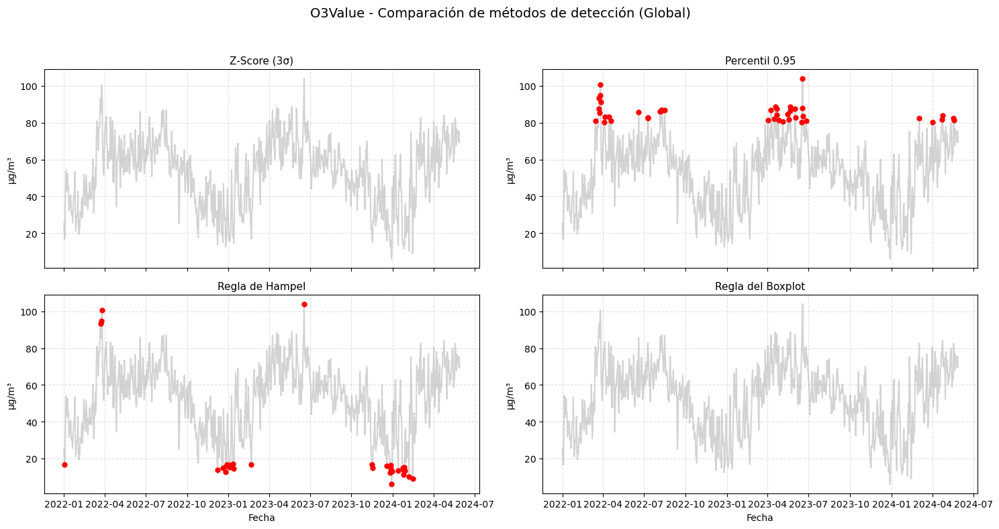

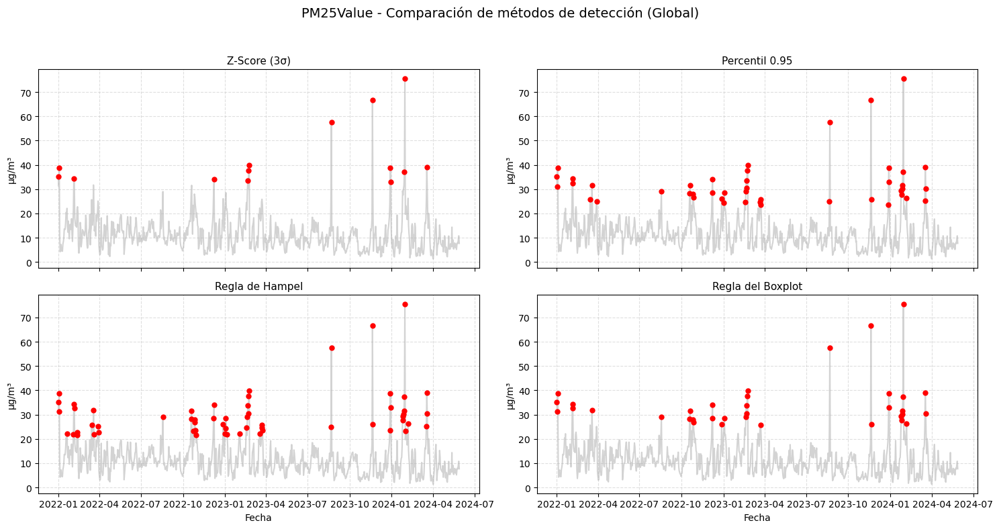

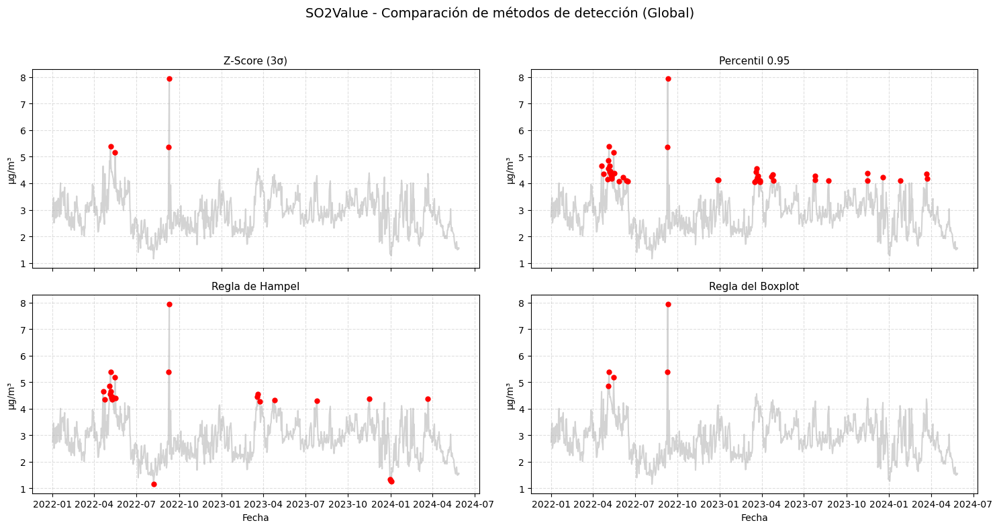

In [6]:
comparar_metodos_anomalias(df_global, 'NO2Value', titulo_base="Global")
comparar_metodos_anomalias(df_global, 'O3Value', titulo_base="Global")
comparar_metodos_anomalias(df_global, 'PM25Value', titulo_base="Global")
comparar_metodos_anomalias(df_global, 'SO2Value', titulo_base="Global")


In [7]:
def visualizar_anomalias_estacion(df, contaminantes, estaciones):
    metodos = {
        '3 Sigmas': 'anom_sigma',
        'Percentil 95': 'anom_percentil',
        'Hampel': 'anom_hampel',
        'Boxplot': 'anom_iqr'
    }

    df['dateObserved'] = pd.to_datetime(df['dateObserved'])  # Convertir a datetime
    df.set_index('dateObserved', inplace=True)

    for estacion in estaciones:
        df_est = df[df['entityId'] == estacion]

        for var in contaminantes:
            if var not in df_est.columns or df_est[var].dropna().shape[0] < 20:
                continue

            fig, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True)
            axes = axes.flatten()

            for i, (nombre_metodo, sufijo) in enumerate(metodos.items()):
                col_anom = f"{var}_{sufijo}"
                ax = axes[i]

                ax.plot(df_est.index, df_est[var], color='lightgray', label='Valor observado', zorder=1)

                if col_anom in df_est.columns:
                    anomalias = df_est[df_est[col_anom]]
                    ax.scatter(anomalias.index, anomalias[var], color='red', s=25, label='Anomalía', zorder=2)

                ax.set_title(nombre_metodo)
                ax.set_ylabel("μg/m³")
                ax.grid(True, linestyle='--', alpha=0.5)
                if i >= 2:
                    ax.set_xlabel("Fecha")
                    plt.sca(ax)
                    plt.xticks(rotation=45)


            fig.suptitle(f"{var} - Estación: {estacion}", fontsize=14)
            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()

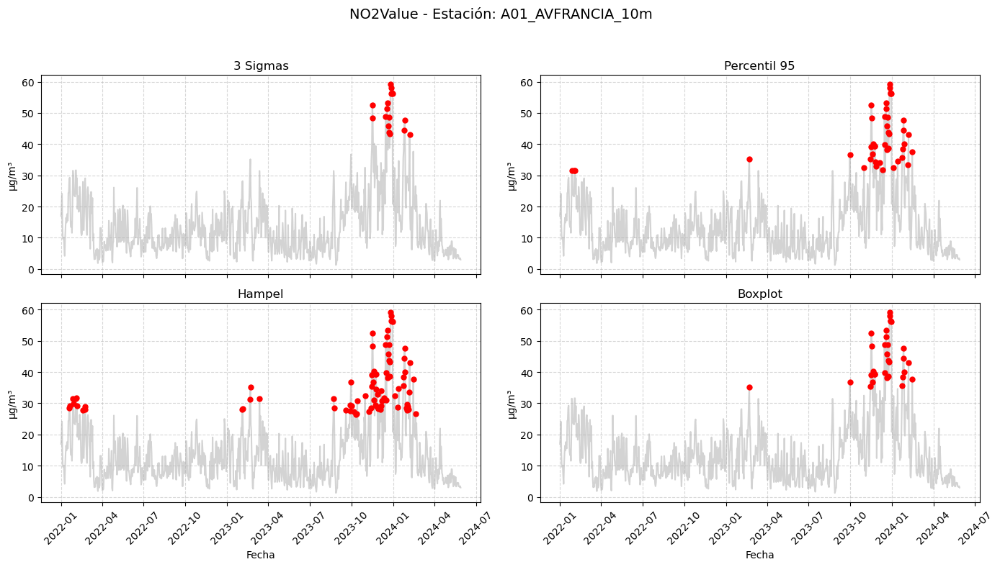

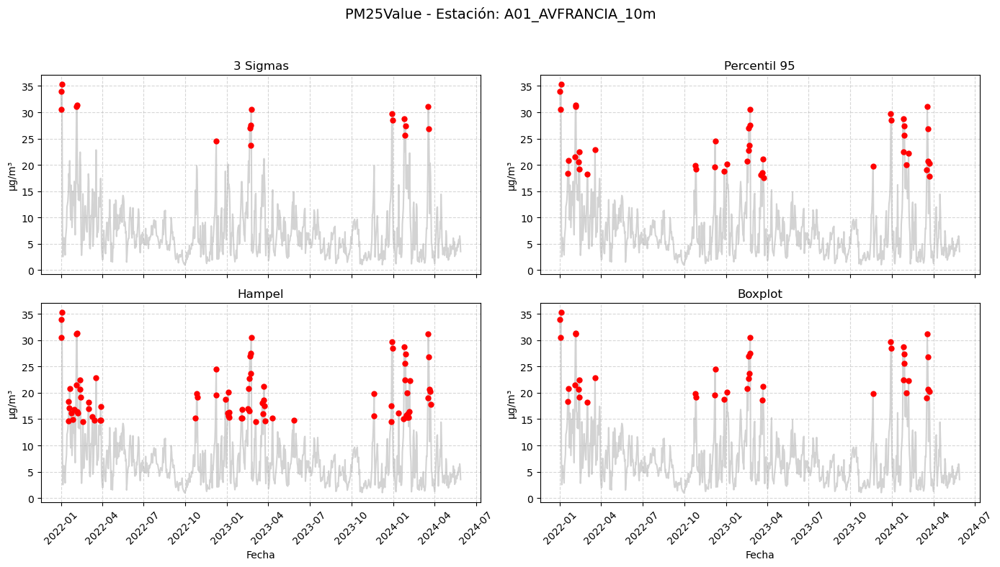

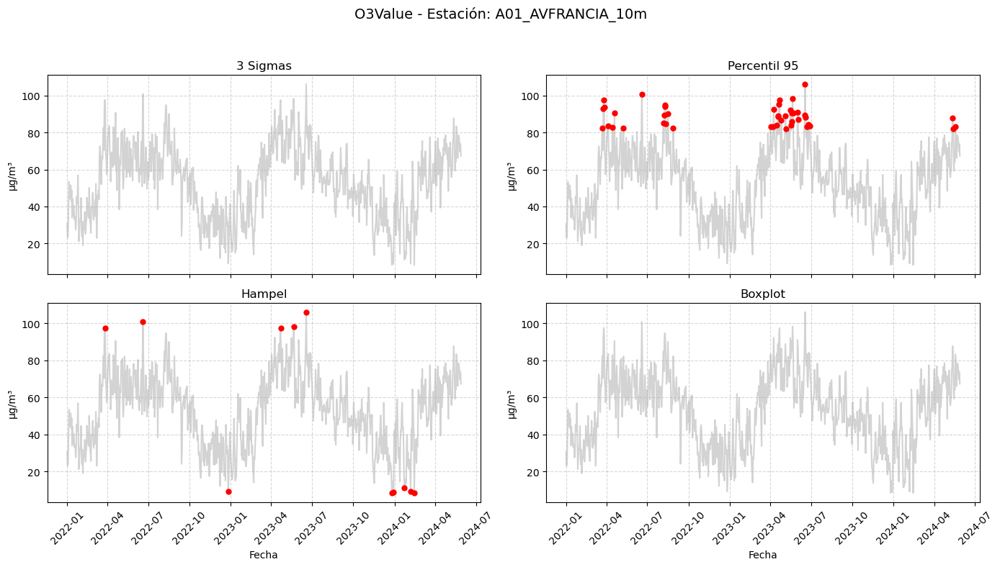

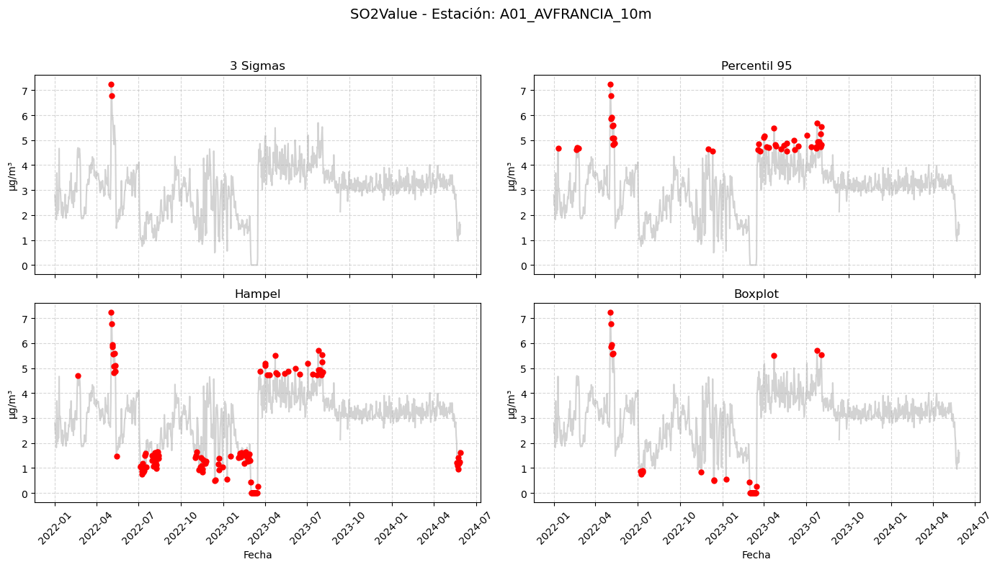

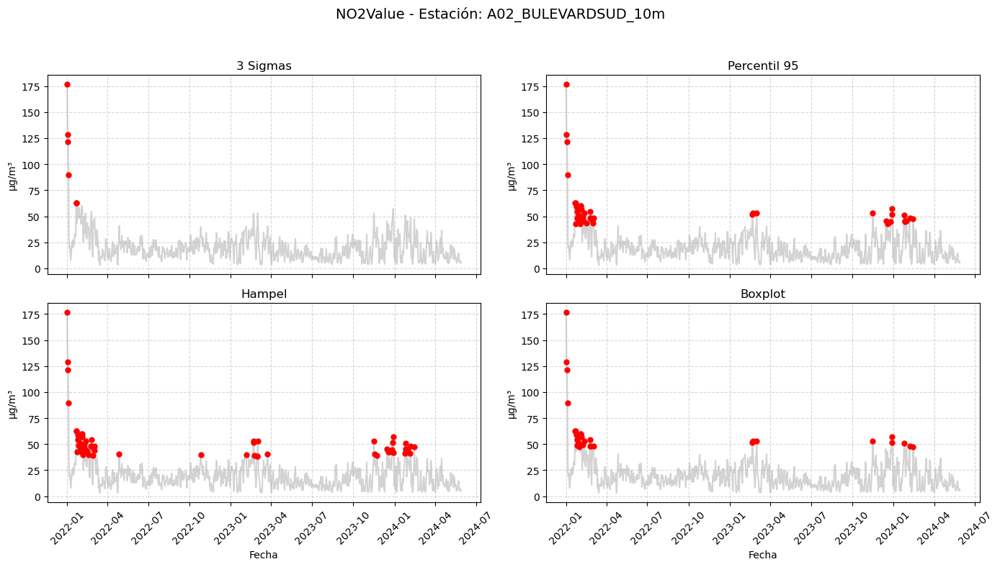

...

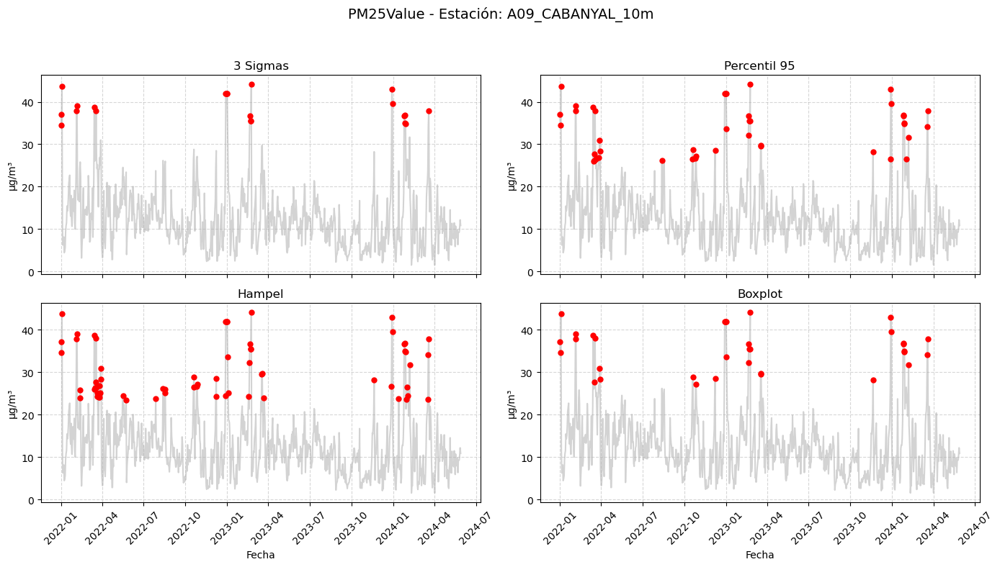

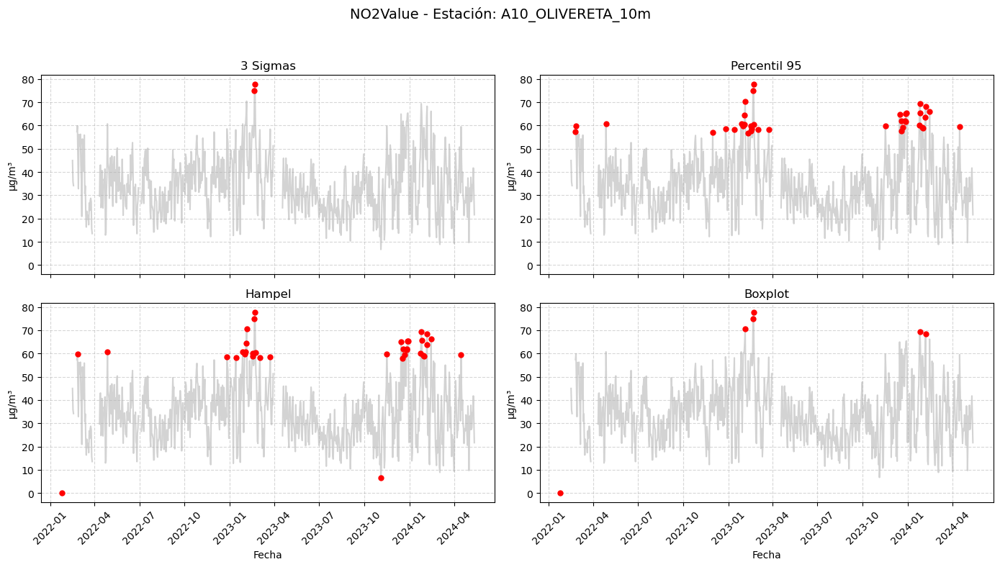

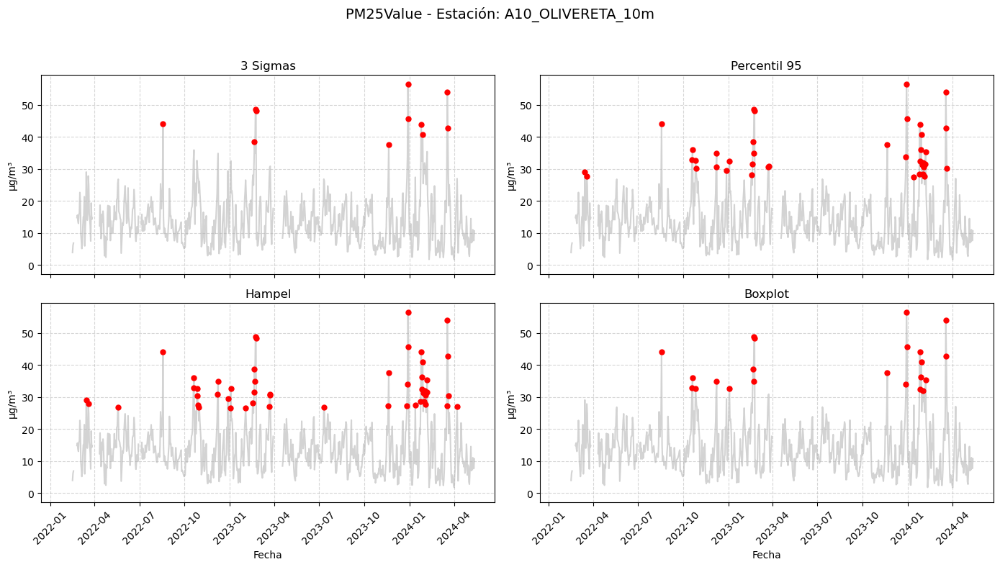

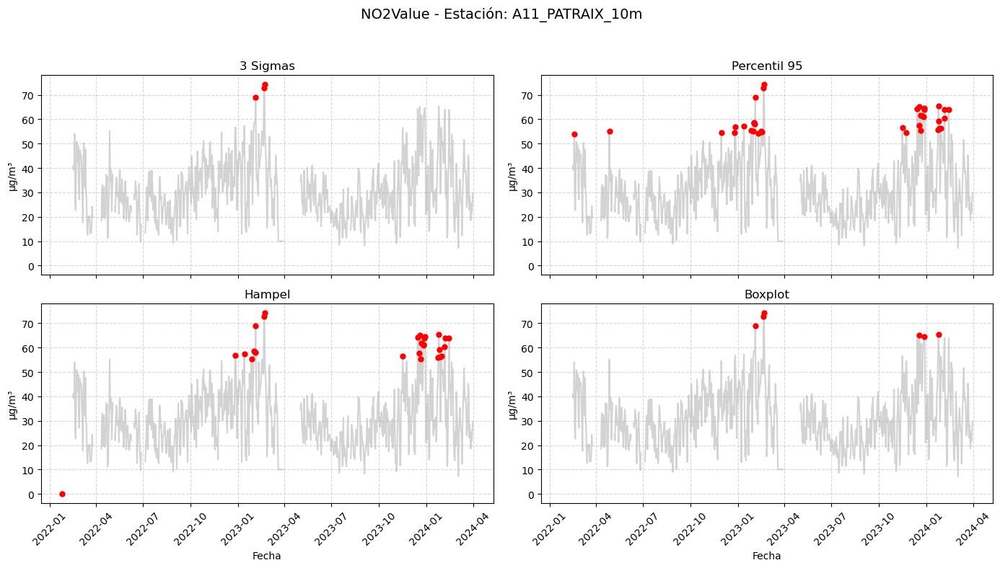

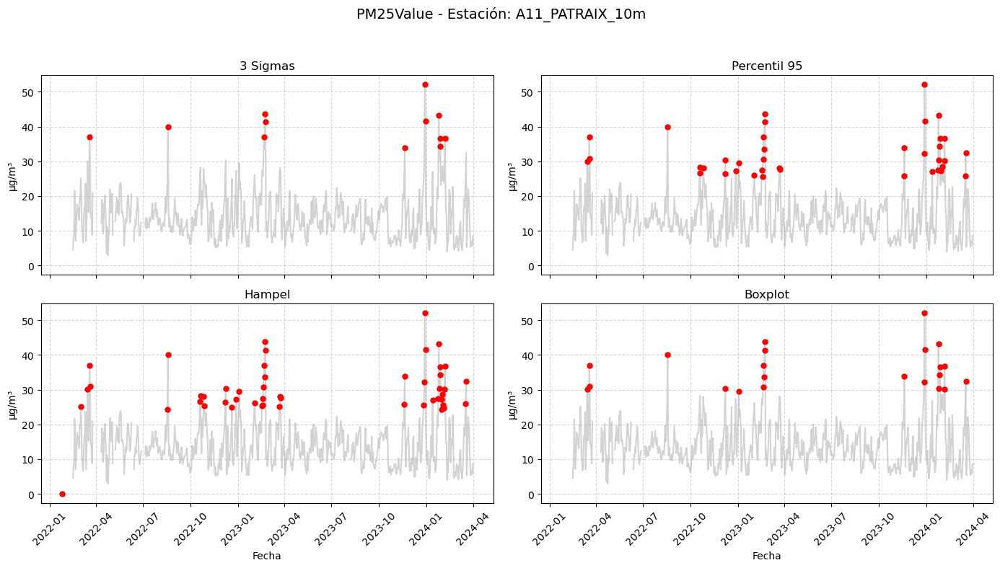

In [8]:
contaminantes = ['NO2Value', 'PM25Value', 'O3Value', 'SO2Value']
estaciones = df_estacion['entityId'].unique() 
visualizar_anomalias_estacion(df_estacion, contaminantes, estaciones)

### Comité de anomalías

In [9]:
# 1. Aplicación a datos globales
comite_cols = [
    'anom_sigma', 'anom_percentil', 'anom_hampel', 'anom_iqr'
]

# Inicializa el diccionario para almacenar el conteo de anomalías por modelo
contadores_globales = {col: {modelo: 0 for modelo in comite_cols} for col in contaminantes}

# Establecer un umbral más estricto para evitar marcar valores incorrectos como anómalos
umbral_anomalia = 3  # Este valor puede ser ajustado según el modelo

# Recorremos los contaminantes y etiquetamos las anomalías
for col in contaminantes:
    col_anom_comite = f'{col}_anom_comite'
    df_global[col_anom_comite] = False  # Inicializamos todos como no anómalos

    for idx, row in df_global.iterrows():
        num_anom = 0
        for anom in comite_cols:
            # Para cada modelo, comprobamos si el valor es anómalo (True/False) y verificamos si pasa el umbral
            if row[f'{col}_{anom}']:  # Si el modelo marca como anómalo
                num_anom += 1

        # Solo marcamos como anómalo si al menos el 75% de los modelos coinciden
        if num_anom >= 3:  # Cambié el umbral a 3 de 4 modelos
            df_global.at[idx, col_anom_comite] = True

        # También contabilizamos las anomalías detectadas por cada modelo
        for anom in comite_cols:
            if row[f'{col}_{anom}']:  # Si el modelo considera anómalo
                contadores_globales[col][anom] += 1

In [10]:
# 2. Aplicación a datos por estación
comite_cols = [
    'anom_sigma', 'anom_percentil', 'anom_hampel', 'anom_iqr'
]

# Contadores por modelo
contadores_estacion = {estacion: {col: {modelo: 0 for modelo in comite_cols} for col in contaminantes} for estacion in df_estacion['entityId'].unique()}
# Contador del comité por estación
contadores_comite_estacion = {estacion: {col: 0 for col in contaminantes} for estacion in estaciones}
# Diccionario para recoger las posiciones que marca el comité
comite_indices_estacion = {est: {col: [] for col in contaminantes}for est in estaciones}

# Establecer umbral más estricto para evitar marcar valores incorrectos como anómalos
umbral_anomalia = 3  # Cambié a 3 para indicar que al menos 3 modelos deben marcar como anómalos

# Recorrer contaminantes y etiquetar anomalías por estación
for col in contaminantes:
    col_anom_comite = f'{col}_anom_comite'
    df_estacion[col_anom_comite] = False  # Inicializamos todos como no anómalos para cada estación

# Recorrer cada estación para evaluar anomalías
for estacion in estaciones:
    # Filtrar los datos por estación
    mask = df_estacion['entityId'] == estacion
    df_actual = df_estacion[mask].copy()

    for col in contaminantes:
        flag = f'{col}_anom_comite'
        df_actual[flag] = False

        for idx, row in df_actual.iterrows():
            num_anom = sum(row[f'{col}_{anom}'] for anom in comite_cols)

            # Solo marcamos como anómalo si al menos el 75% de los modelos coinciden
            if num_anom >= umbral_anomalia:
                df_estacion.at[idx, flag] = True
                contadores_comite_estacion[estacion][col] += 1
                comite_indices_estacion[estacion][col].append(idx)

            # También contabilizamos las anomalías detectadas por cada modelo para cada estación
            for anom in comite_cols:
                if row[f'{col}_{anom}']:  # Si el modelo marca como anómalo
                    contadores_estacion[estacion][col][anom] += 1

    for col in contaminantes:
        df_estacion.loc[mask, f'{col}_anom_comite'] = df_actual[f'{col}_anom_comite']

In [11]:
# 3. Crear tabla resumen de anomalías por modelo y contaminante
# Conteo global de anomalías por modelo y contaminante
tabla_anomalias_global = pd.DataFrame(contadores_globales)
tabla_anomalias_global.index.name = 'Modelo'

# Conteo por estación de anomalías por modelo y contaminante
# Crear tablas resumen de anomalías por modelo y contaminante, considerando la estación
# Convertir el diccionario contadores_estacion en un formato adecuado para un DataFrame
tabla_anomalias_estacion = {}
for estacion, conteos in contadores_estacion.items():
    df_estacion_resumen = pd.DataFrame(conteos)
    # Crear un DataFrame para cada estación
    df_estacion_resumen.index.name = 'Modelo'  # Asignar el nombre a las filas (modelos)
    tabla_anomalias_estacion[estacion] = df_estacion_resumen

# Conteo de anomalías por comité en global y por estación
# Para el comité, vamos a contar cuántas veces un contaminante fue etiquetado como anómalo (calculado en el código anterior)
comite_global = {col: df_global[f'{col}_anom_comite'].sum() for col in contaminantes}

# Mostrar la tabla con anomalías y la cantidad de anomalías por comité
print("Conteo de anomalías detectadas por cada modelo (global):")
print(tabla_anomalias_global)

print("\nConteo de anomalías detectadas por cada modelo (por estación):")
for estacion, df in tabla_anomalias_estacion.items():
    print(f"\nConteo de anomalías para la estación {estacion}:")
    print(df)

print("\nNúmero de anomalías etiquetadas por el comité (global):")
print(comite_global)

print("\nNúmero de anomalías etiquetadas por el comité (por estación):")
df_comite = pd.DataFrame(contadores_comite_estacion).T
df_comite.index.name = 'Estación'

print(df_comite)

Conteo de anomalías detectadas por cada modelo (global):
                NO2Value  PM25Value  O3Value  SO2Value
Modelo                                                
anom_sigma             8         14        0         4
anom_percentil        44         44       44        44
anom_hampel           60         58       31        24
anom_iqr              20         35        0         5

Conteo de anomalías detectadas por cada modelo (por estación):

Conteo de anomalías para la estación A01_AVFRANCIA_10m:
                NO2Value  PM25Value  O3Value  SO2Value
Modelo                                                
anom_sigma            17         17        0         2
anom_percentil        43         44       44        44
anom_hampel           81         84       11       124
anom_iqr              32         41        0        33

Conteo de anomalías para la estación A02_BULEVARDSUD_10m:
                NO2Value  PM25Value  O3Value  SO2Value
Modelo                                          

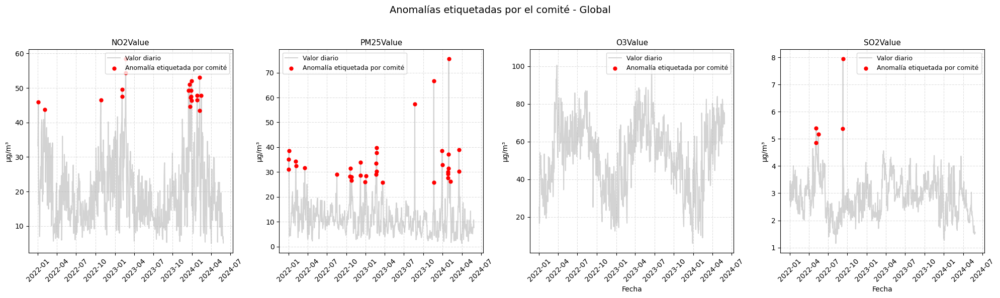

In [12]:
# 1. Visualización de anomalías etiquetadas por el comité (global)
fig, axes = plt.subplots(1, 4, figsize=(20, 6), sharex=True)

# Recorrer los contaminantes y graficar en cada subplot
for i, col in enumerate(contaminantes):
    # Filtra las filas donde el comité etiquetó como anómalo
    anom_global = df_global[df_global[f'{col}_anom_comite']]
    ax = axes[i]

    # Serie completa de valores
    ax.plot(df_global.index, df_global[col], label='Valor diario', color='lightgray', zorder=1)

    # Puntos de anomalía etiquetada por el comité
    ax.scatter(anom_global.index, anom_global[col], color='red', label='Anomalía etiquetada por comité', s=25, zorder=3)

    # Estética
    ax.set_title(f"{col}", fontsize=11)
    ax.set_ylabel("µg/m³")
    ax.grid(True, linestyle='--', alpha=0.4)
    if i >= 2:
        ax.set_xlabel("Fecha")
    plt.sca(ax)
    plt.xticks(rotation=45)
    ax.legend(fontsize=9)

# Título para todo el gráfico
plt.suptitle("Anomalías etiquetadas por el comité - Global", fontsize=14, ha='center')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


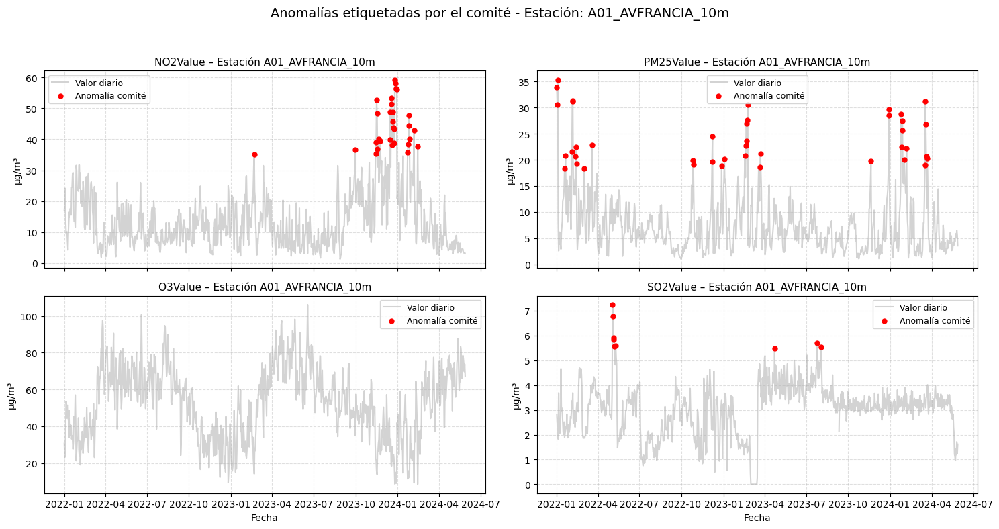

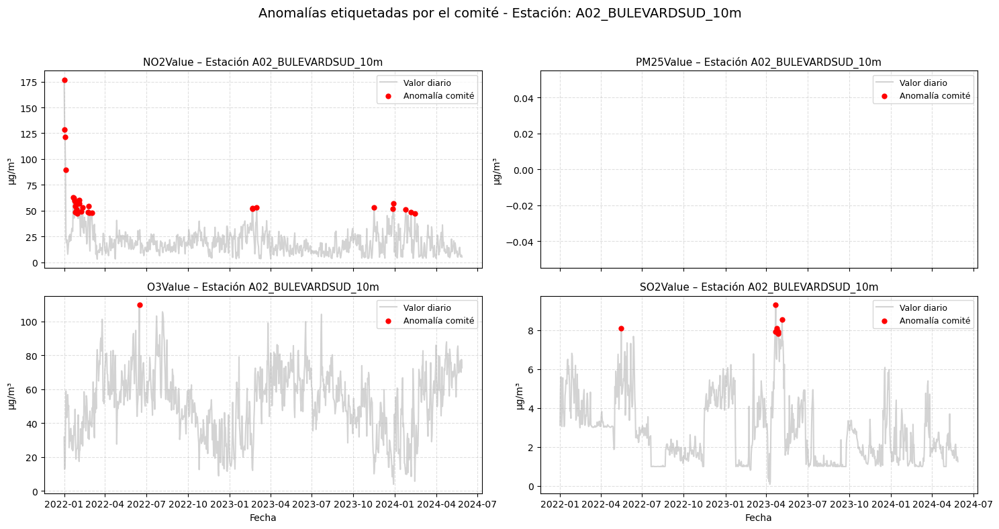

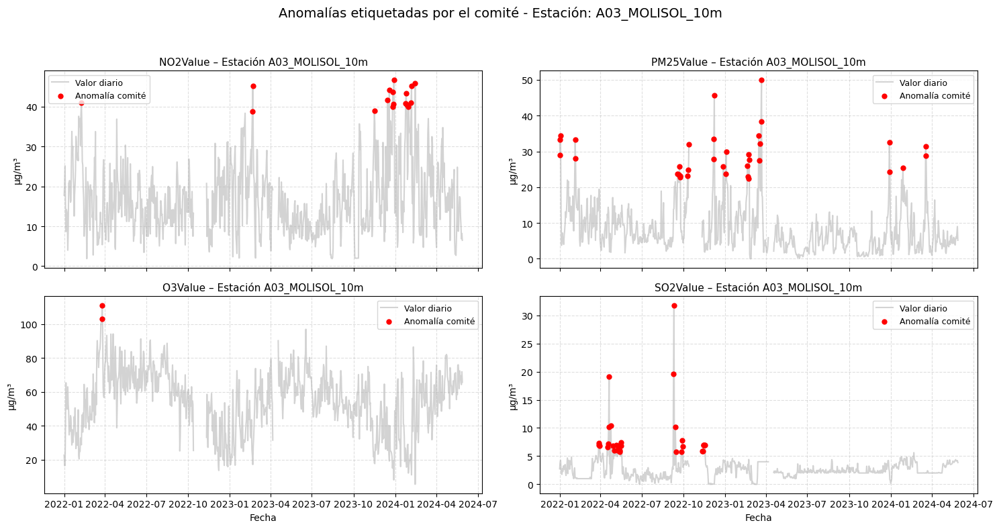

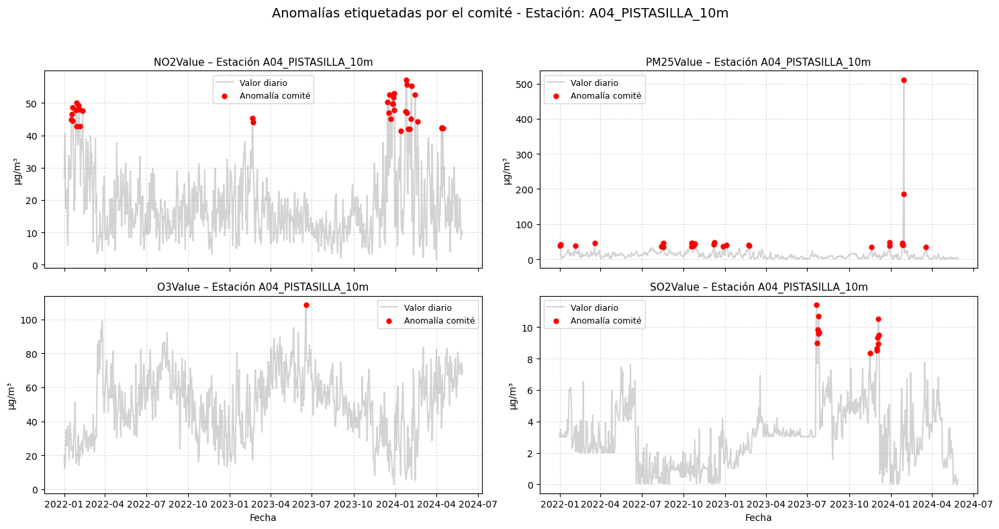

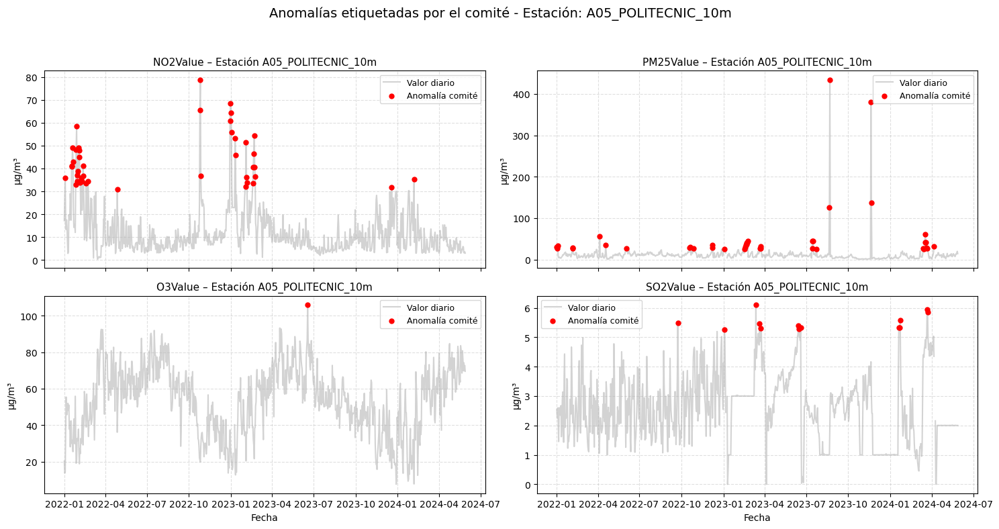

...

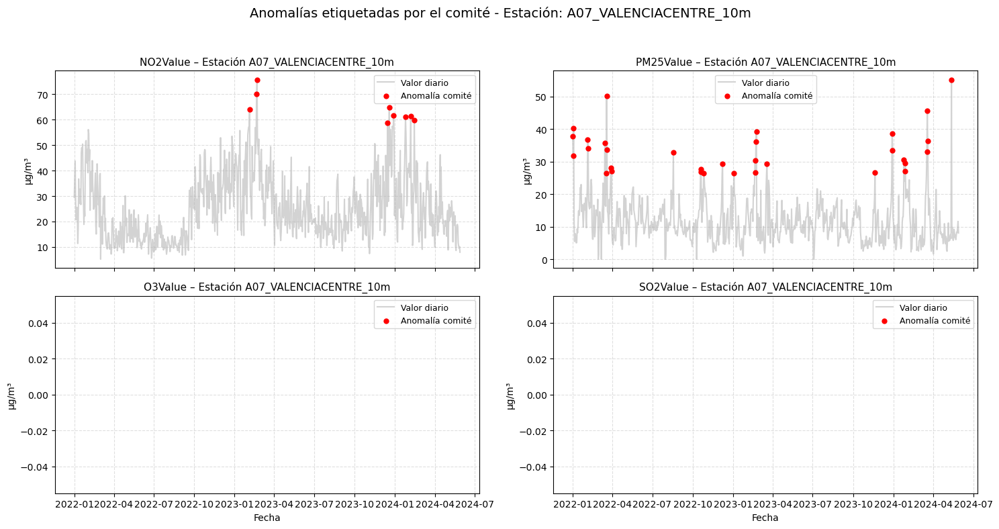

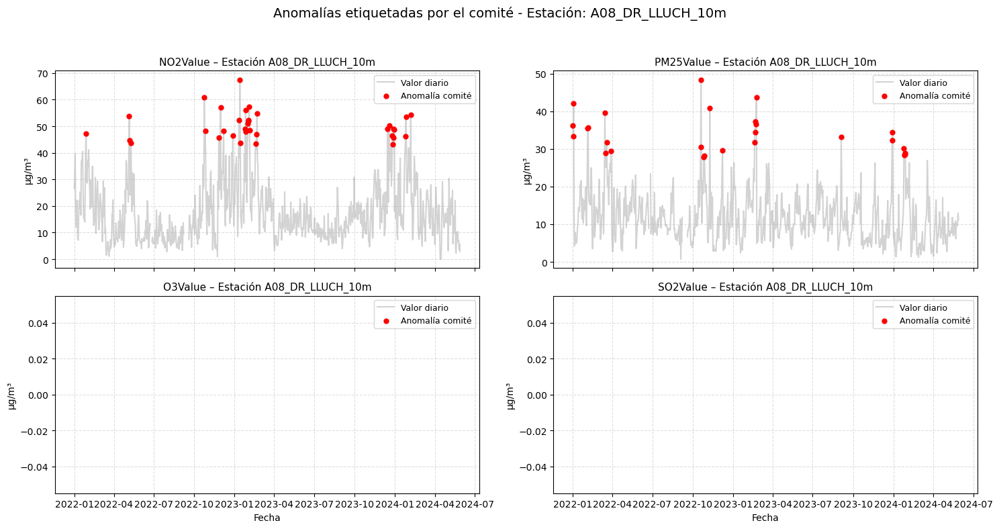

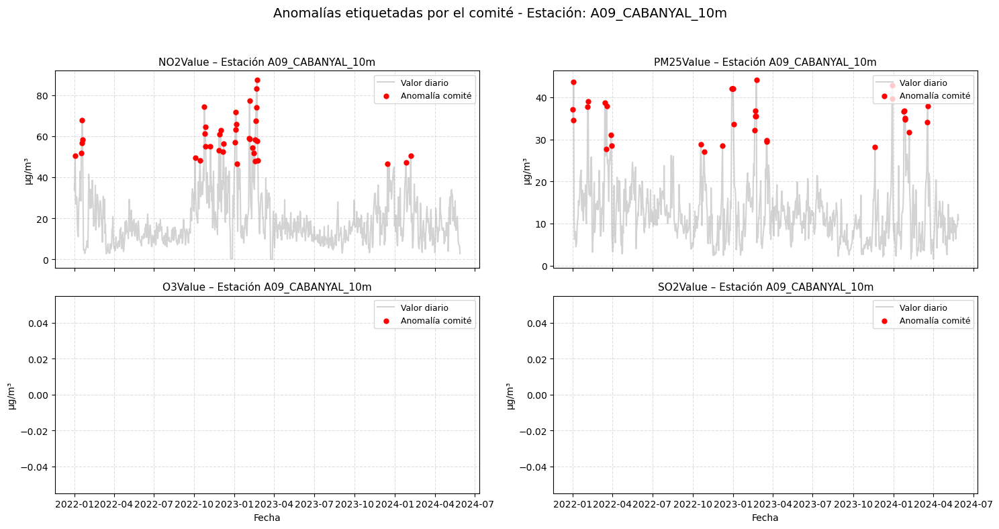

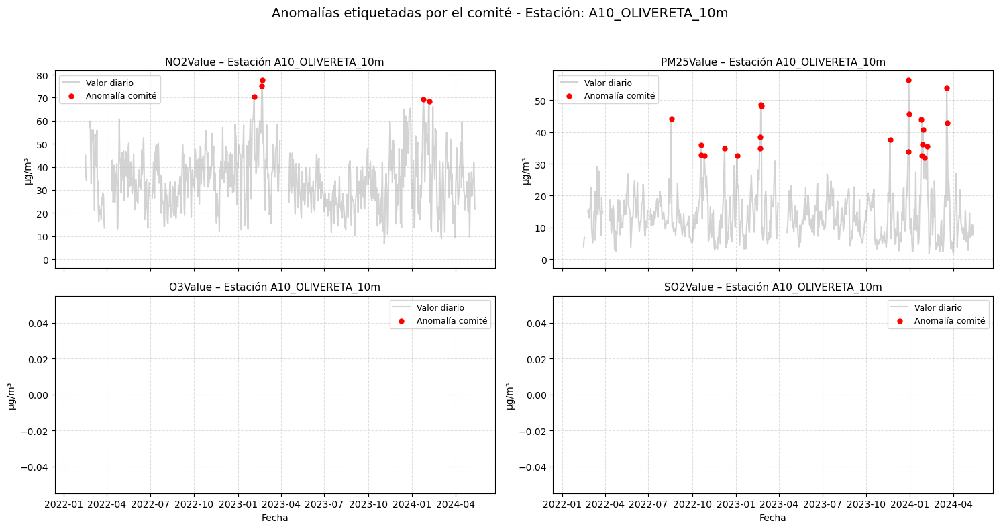

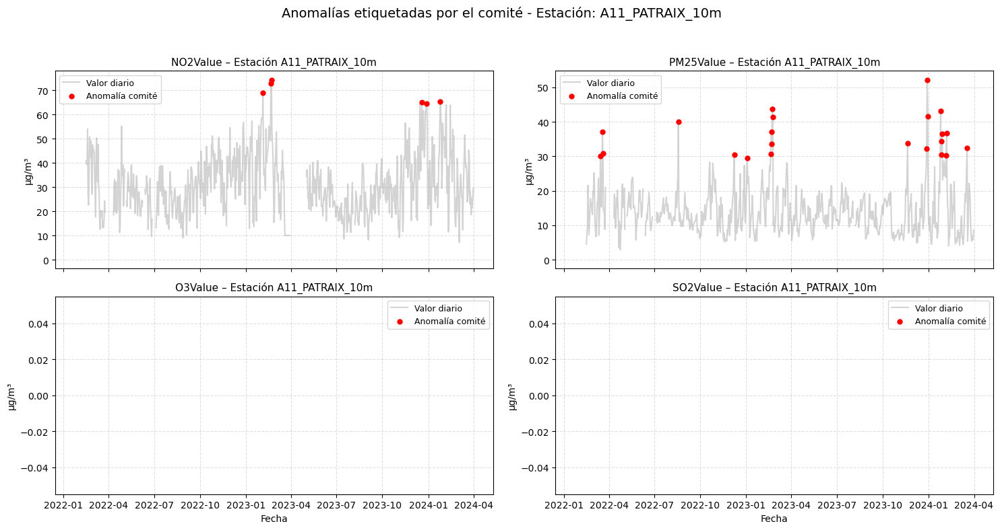

In [13]:
# 2. Visualización de anomalías etiquetadas por el comité por estación
for estacion in df_estacion['entityId'].unique():
    # Filtra los datos de la estación
    df_actual = df_estacion[df_estacion['entityId'] == estacion].copy()
    
    # Crear subplots para los 4 contaminantes (2 filas, 2 columnas)
    fig, axes = plt.subplots(2, 2, figsize=(15, 8), sharex=True)
    axes = axes.flatten()

    # Recorrer los contaminantes y graficar en cada subplot
    for i, col in enumerate(contaminantes):
        ax = axes[i]
        flag = f"{col}_anom_comite"
        
        # Serie completa de valores
        ax.plot(df_actual.index, df_actual[col],
                color='lightgray', label='Valor diario', zorder=1)
        
        #  Puntos de anomalía etiquetada por el comité
        fechas = comite_indices_estacion[estacion][col]
        valores = df_actual.loc[fechas, col]

        ax.scatter(fechas, valores, 
                   color='red', label='Anomalía comité', s=25, zorder=3)

        # Estética
        ax.set_title(f"{col} – Estación {estacion}", fontsize=11)
        ax.set_ylabel("µg/m³")
        if i >= 2:
            ax.set_xlabel("Fecha")
        ax.grid(True, linestyle='--', alpha=0.4)
        ax.legend(fontsize=9)
        
    plt.suptitle(f"Anomalías etiquetadas por el comité - Estación: {estacion}", fontsize=14, ha='center')
    plt.tight_layout(rect=[0,0,1,0.95])
    plt.show()

### Umbrales legales

La detección de anomalías se realiza utilizando valores diarios agregados a partir de datos horarios originales. Sin embargo, muchos de los umbrales legales establecidos en la legislación española y europea están definidos para intervalos más cortos, como 1 hora o 8 horas. Por ello, ha sido necesario adaptar dichos umbrales para que tengan sentido en el contexto de series temporales de frecuencia diaria.

- Dióxido de nitrógeno (NO2)
    - Umbral legal original: 200 µg/m³ como valor límite horario, no superable más de 18 veces por año.
    - Problema: Este valor es horario, pero los datos usados están promediados diariamente, lo que suaviza los picos.
    - Adaptación propuesta: 100 µg/m³ diarios. Este valor intermedio busca captar días donde hubo varias horas con niveles elevados, sin requerir un pico extremo de 1 hora.

- Ozono (O3)
    - Umbral legal original: 120 µg/m³ como media móvil de 8 horas, no superable más de 25 días/año (media trianual).
    - Problema: Las series usadas son medias de 24 horas, mientras que el ozono tiene una variabilidad diaria marcada (sube en las tardes).
    - Adaptación propuesta: 90 µg/m³ diarios, como valor indicativo de días con concentración anómala, sin requerir el cálculo de medias móviles 8h.

- Partículas (PM25)
    - Umbral legal original: umbral de activación 25 µg/m³, umbral de información 35 µg/m³ y umbral de alerta 50 µg/m³, todos como promedio 24h.
    - Adaptación propuesta: 30 µg/m³, ya que el objetivo es detectar anomalías (no necesariamente alertar a la población) y este valor permite captar días “anómalos” sin ser excesivamente conservador.

- Dióxido de azufre (SO2)
    - Umbral legal original: 125 µg/m³ como media diaria, no superable más de 3 veces/año.
    - Adaptación propuesta: No se modifica. Se mantiene 125 µg/m³ diarios, ya que el umbral legal ya está definido para esa escala temporal.

In [14]:
# Bloque 2: Detección mediante umbrales legales diarios (según legislación española y orientaciones OMS)

# Umbrales legales diarios para cada contaminante (µg/m³)
umbrales_legales = {
    'NO2Value': 100,  
    'O3Value': 90,   
    'PM25Value': 30, 
    'SO2Value': 125 
}

# Crear columnas booleanas indicando si se supera el umbral legal para cada contaminante
for col, umbral in umbrales_legales.items():
    df_global[f'{col}_anom_legal'] = df_global[col] > umbral
    df_estacion[f'{col}_anom_legal'] = df_estacion[col] > umbral

# Las columnas *_anom_legal tendrán True si el valor supera el umbral legal diario, False en caso contrario.

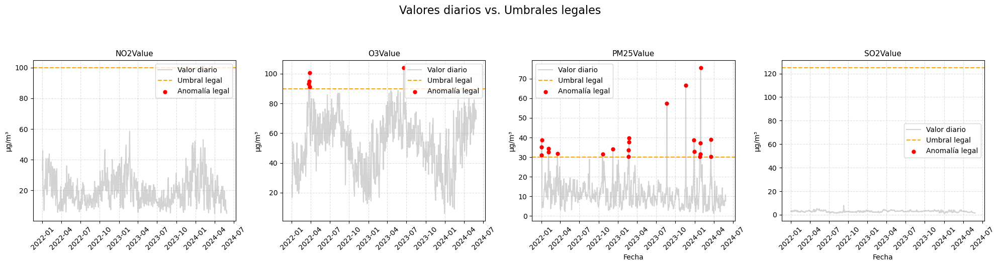

In [15]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5), sharex=True)

# Recorrer contaminantes y sus subgráficos
for i, col in enumerate(umbrales_legales.keys()):
    df_global.index = pd.to_datetime(df_global.index)
    ax = axes[i]

    # Serie completa
    ax.plot(df_global.index, df_global[col], label='Valor diario', color='lightgray', zorder=1)

    # Línea del umbral legal
    ax.axhline(umbrales_legales[col], color='orange', linestyle='--', label='Umbral legal', zorder=2)

    # Puntos de anomalía legal
    anom = df_global[df_global[f"{col}_anom_legal"]]
    ax.scatter(anom.index, anom[col], color='red', label='Anomalía legal', s=25, zorder=3)

    # Estética
    ax.set_title(f"{col}", fontsize=11)
    ax.set_ylabel("µg/m³")
    ax.grid(True, linestyle='--', alpha=0.4)
    if i >= 2:
        ax.set_xlabel("Fecha")
    plt.sca(ax)
    plt.xticks(rotation=45)
    ax.legend()

# Ajustar diseño
plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.suptitle('Valores diarios vs. Umbrales legales', y=1.05, fontsize=16)
plt.show()

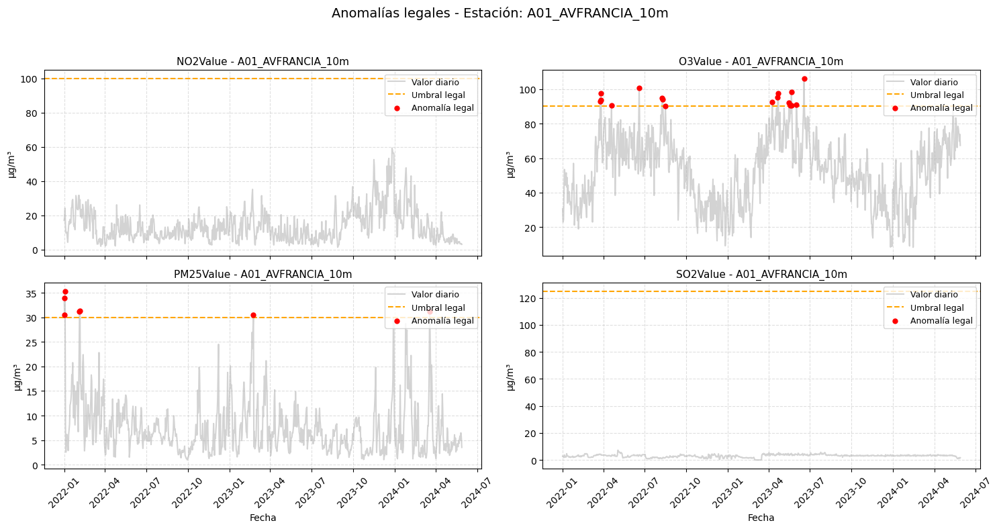

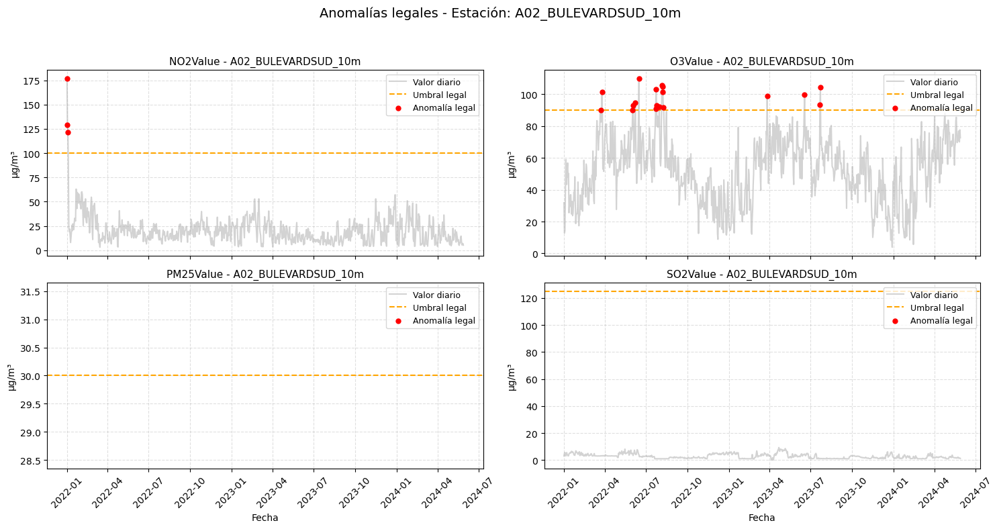

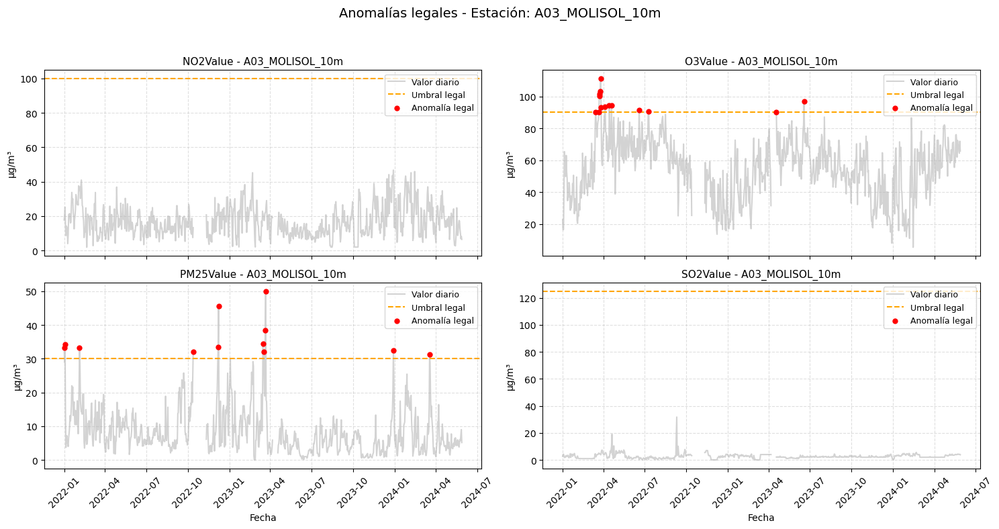

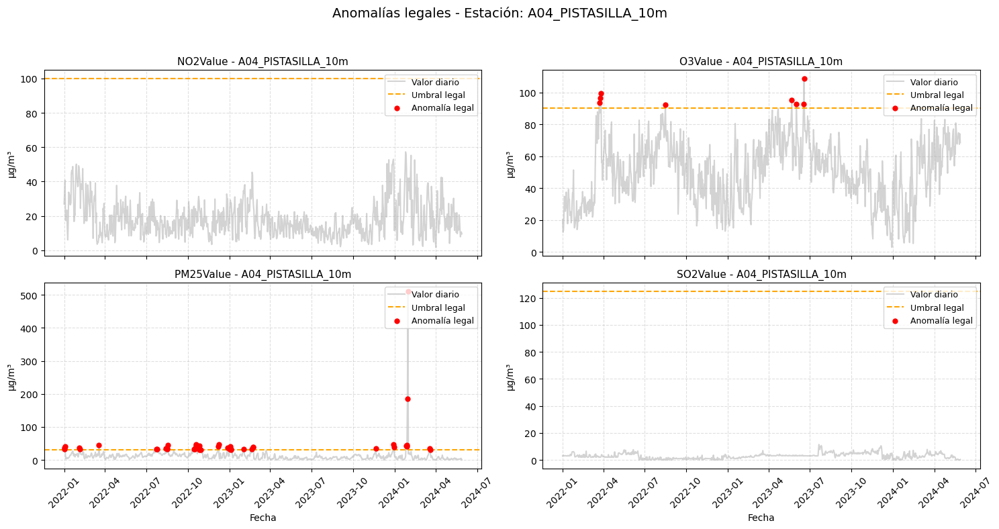

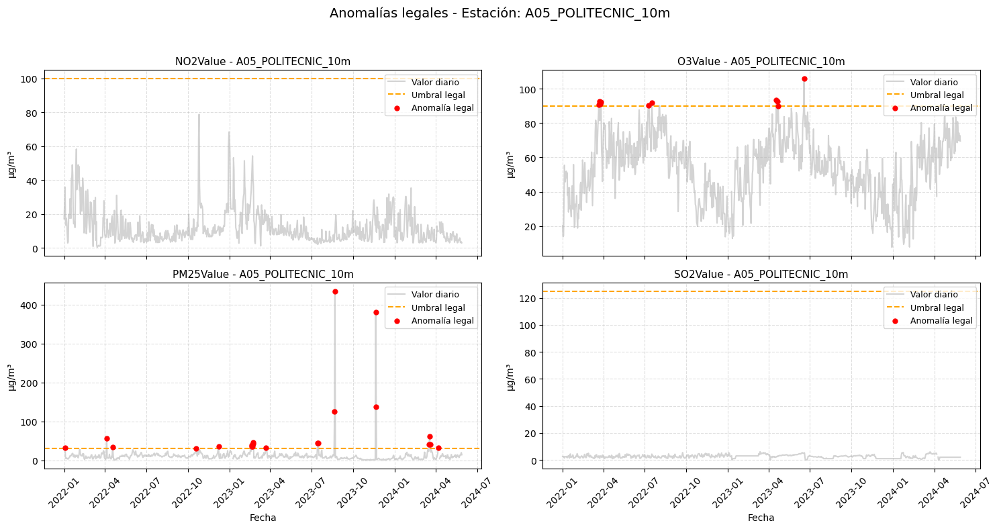

...

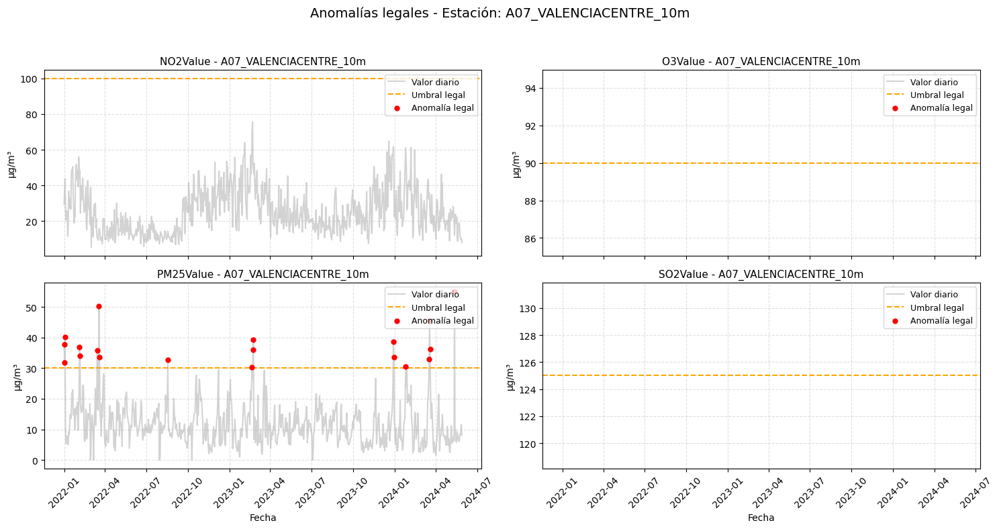

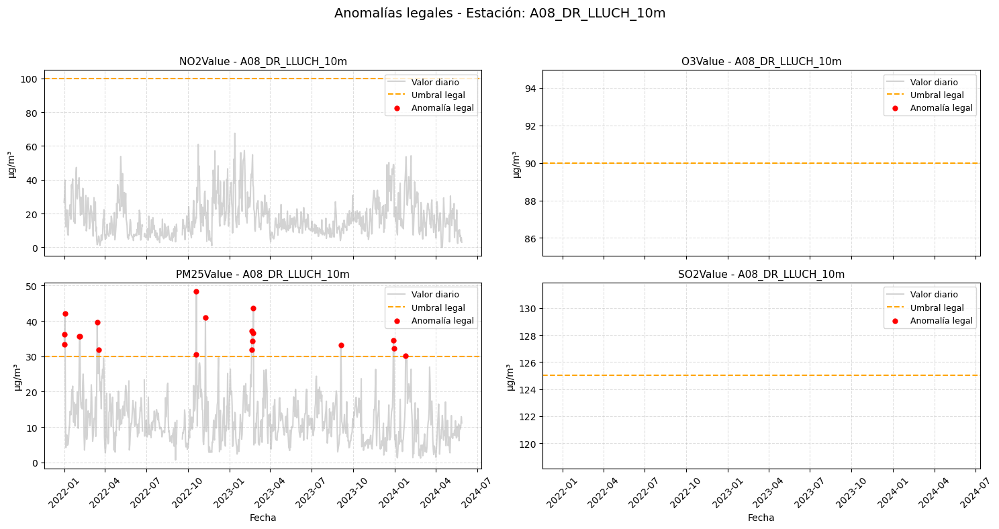

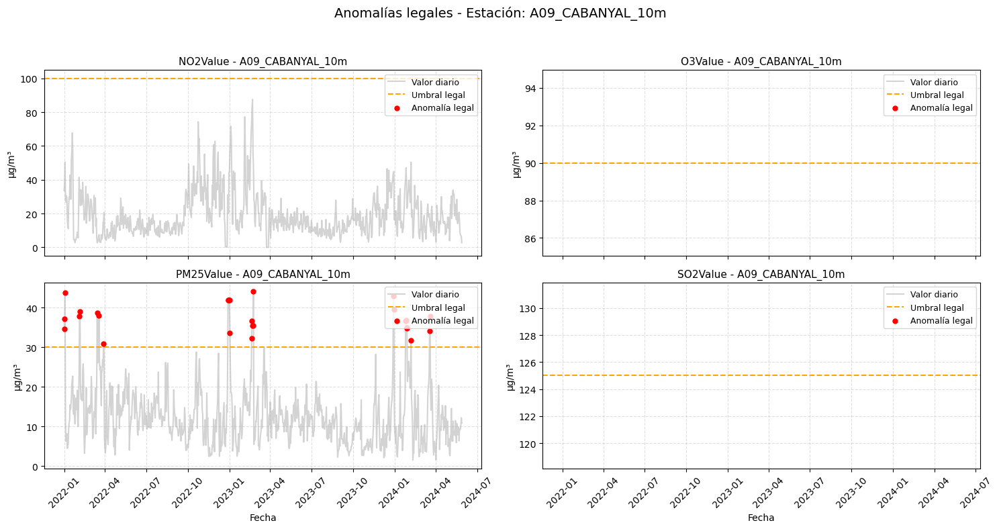

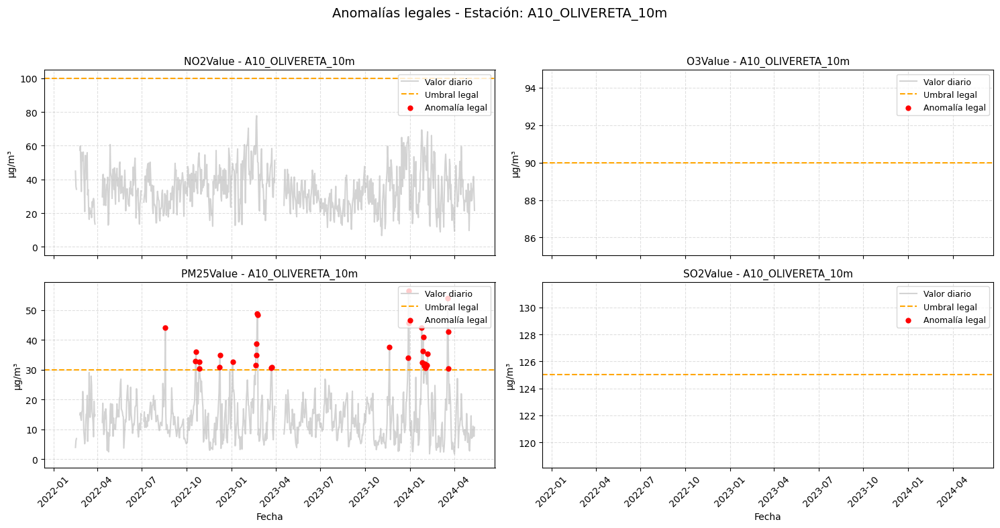

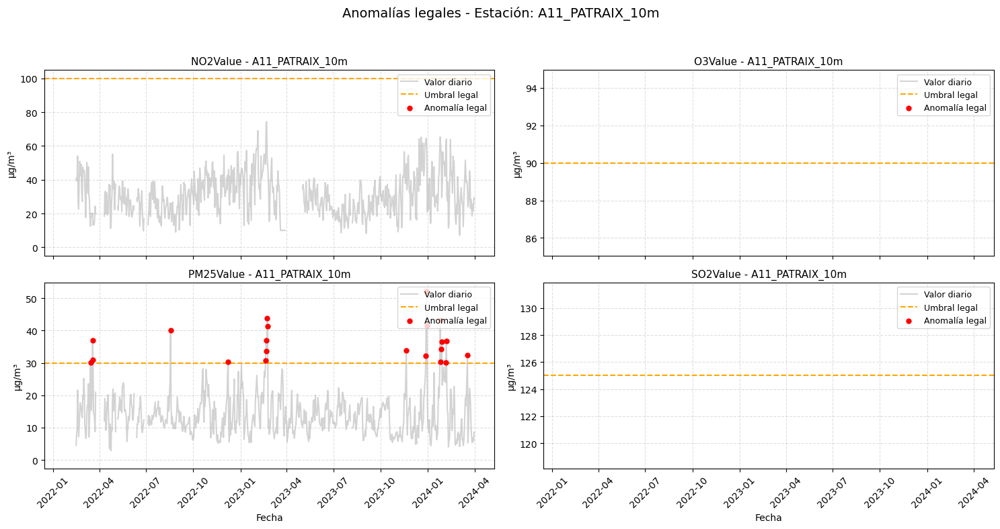

In [16]:
# Lista de estaciones disponibles en df_estacion
estaciones_disponibles = df_estacion['entityId'].unique()

# Recorremos cada estación
for estacion in estaciones_disponibles:
    df_actual.index = pd.to_datetime(df_actual.index)
    # Filtrar datos de la estación actual
    df_actual = df_estacion[df_estacion['entityId'] == estacion]

    # Crear subplots para los 4 contaminantes
    fig, axes = plt.subplots(2, 2, figsize=(15, 8), sharex=True)
    axes = axes.flatten()

    # Recorrer contaminantes para graficar
    for i, col in enumerate(umbrales_legales.keys()):
        col_anom = f"{col}_anom_legal"
        
        # Verificar que la columna y la columna de anomalías existan
        if col in df_actual.columns and col_anom in df_actual.columns:
            ax = axes[i]
            
            # Serie completa de valores para el contaminante
            ax.plot(df_actual.index, df_actual[col], label='Valor diario', color='lightgray', zorder=1)

            # Línea de umbral legal
            ax.axhline(umbrales_legales[col], color='orange', linestyle='--', label='Umbral legal', zorder=2)

            # Puntos de anomalía legal
            anom = df_actual[df_actual[col_anom]]
            ax.scatter(anom.index, anom[col], color='red', label='Anomalía legal', s=25, zorder=3)

            # Estética
            ax.set_title(f"{col} - {estacion}", fontsize=11)
            ax.set_ylabel("µg/m³")
            ax.grid(True, linestyle='--', alpha=0.4)
            if i >= 2:
                ax.set_xlabel("Fecha")
            plt.sca(ax)
            plt.xticks(rotation=45)
            ax.legend(loc='upper right', fontsize=9)

    # Título para la estación actual
    plt.suptitle(f"Anomalías legales - Estación: {estacion}", fontsize=14)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


## Análisis no supervisado (PCA y clustering)

### Preparación

Para llevar a cabo un análisis no supervisado con técnicas de reducción de dimensionalidad y agrupamiento, primero se agruparon los datos diarios por estación, calculando la media de cada contaminante. Se consideraron dos enfoques:

- Enfoque 1: se mantuvieron todas las estaciones, imputando los valores faltantes con la media.

- Enfoque 2: se descartaron las estaciones con más del 50% de valores ausentes y posteriormente se imputaron los valores restantes.

Este doble enfoque permite comparar el impacto del tratamiento de valores nulos en la estructura latente de los datos.

In [17]:
variables = ['NO2Value', 'PM25Value', 'O3Value', 'SO2Value']

# Agrupación por estación
df_grouped = datos_d_estacion.groupby('entityId')[variables].mean()

# Copias: una con todas las estaciones, otra filtrando >50% NaNs
df_grouped_all = df_grouped.copy()
df_grouped_filt = df_grouped[df_grouped.isnull().mean(axis=1) < 0.5]

# Imputar NaNs con la media (por columna)
df_grouped_all = df_grouped_all.fillna(df_grouped_all.mean())
df_grouped_filt = df_grouped_filt.fillna(df_grouped_filt.mean())

### Escalado y PCA

Dado que las magnitudes de los contaminantes difieren, se aplicó un escalado estándar (media cero, desviación estándar uno) antes de aplicar el Análisis de Componentes Principales (PCA).
Se ejecutó PCA por separado en los dos conjuntos (completo y filtrado), permitiendo reducir la dimensión de los datos conservando el máximo de varianza posible.

In [18]:
scaler = StandardScaler()
X_all = scaler.fit_transform(df_grouped_all)
X_filt = scaler.fit_transform(df_grouped_filt)

pca_all = PCA().fit(X_all)
pca_filt = PCA().fit(X_filt)

### Varianza explicada

En ambos casos, las primeras dos componentes explican en torno al 70-75% de la varianza total, lo que justifica su uso para visualización y clustering.
Se observa una distribución similar de varianza explicada en ambos enfoques, aunque con ligeras diferencias atribuibles a la cantidad de estaciones.

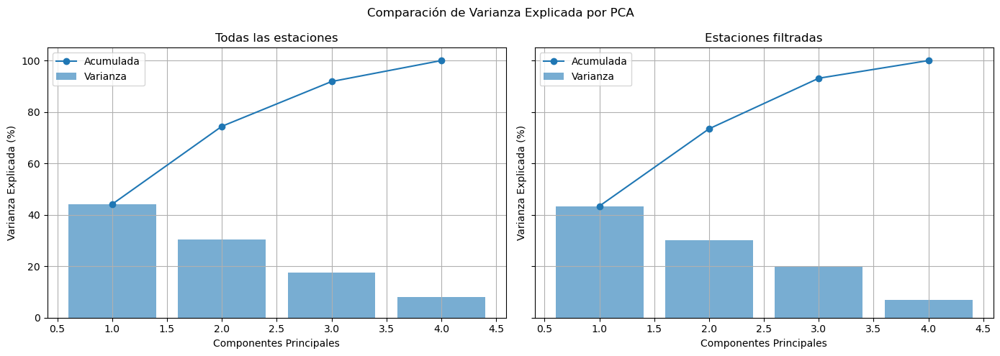

In [19]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)

for ax, pca_model, title in zip(
    axes,
    [pca_all, pca_filt],
    ["Todas las estaciones", "Estaciones filtradas"]
):
    var_exp = pca_model.explained_variance_ratio_
    ax.bar(range(1, len(var_exp)+1), var_exp * 100, alpha=0.6, label='Varianza')
    ax.plot(range(1, len(var_exp)+1), var_exp.cumsum() * 100, marker='o', label='Acumulada')
    ax.set_title(title)
    ax.set_xlabel('Componentes Principales')
    ax.set_ylabel('Varianza Explicada (%)')
    ax.legend()
    ax.grid(True)

plt.suptitle("Comparación de Varianza Explicada por PCA")
plt.tight_layout()
plt.show()

### Componentes

El análisis de las cargas (componentes de la matriz de PCA) muestra cómo cada contaminante contribuye a cada componente principal. Esta matriz permite interpretar el significado físico de las nuevas variables creadas por el PCA, ayudando a identificar qué dimensiones latentes están más relacionadas con cada tipo de contaminante.

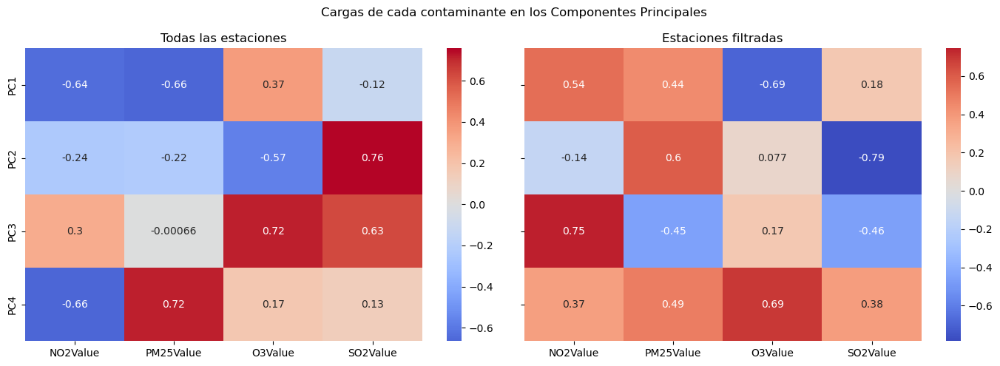

In [20]:
componentes_all = pd.DataFrame(pca_all.components_, columns=variables, index=[f'PC{i+1}' for i in range(pca_all.n_components_)])
componentes_filt = pd.DataFrame(pca_filt.components_, columns=variables, index=[f'PC{i+1}' for i in range(pca_filt.n_components_)])

fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)
sns.heatmap(componentes_all, annot=True, cmap="coolwarm", center=0, ax=axes[0])
axes[0].set_title("Todas las estaciones")
sns.heatmap(componentes_filt, annot=True, cmap="coolwarm", center=0, ax=axes[1])
axes[1].set_title("Estaciones filtradas")
plt.suptitle("Cargas de cada contaminante en los Componentes Principales")
plt.tight_layout()
plt.show()

En el enfoque que incluye todas las estaciones, se observa que la primera componente (PC1) está fuertemente influenciada por los valores negativos de NO₂ y PM2.5, con valores cercanos a -0.64 y -0.66 respectivamente, y en menor medida por O₃ en sentido positivo. Esto sugiere que PC1 representa un eje de contraste entre la contaminación asociada al tráfico (NO₂ y partículas finas) y los niveles de ozono. La segunda componente (PC2) está dominada positivamente por SO₂, y negativamente por O₃, lo que podría indicar un eje vinculado a fuentes industriales frente a ozono troposférico. La tercera y cuarta componente reflejan combinaciones más complejas con menor varianza explicada, pero con participación relevante de O₃ y SO₂.

Por su parte, en el enfoque filtrado (eliminando estaciones con más del 50% de valores nulos), las cargas de los componentes cambian de forma significativa, aunque se conservan algunas tendencias generales. Por ejemplo, en este caso, la primera componente (PC1) pasa a tener una fuerte influencia negativa del ozono (O₃: -0.69) y positiva de NO₂ y PM2.5. La segunda componente (PC2) presenta una fuerte carga negativa del SO₂, diferenciándose más claramente del resto de contaminantes. Esto sugiere que al eliminar estaciones con alta cantidad de datos ausentes, se refuerzan las diferencias en las fuentes de emisión (tráfico, industrial, formación secundaria) y se reduce la distorsión estadística.

### Elbow Method

Se empleó Elbow Method para estimar el número adecuado de clusters a aplicar con K-Means.
En el conjunto completo, el punto de inflexión se sitúa entre 4 y 5 clusters, mientras que en el conjunto filtrado se sugiere un valor de 3.

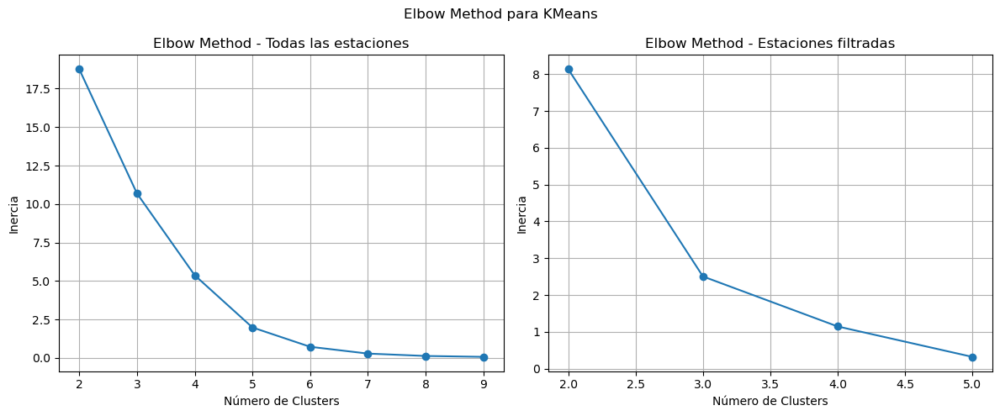

In [21]:
X_all_pca = PCA(n_components=2).fit_transform(X_all)
X_filt_pca = PCA(n_components=2).fit_transform(X_filt)

def elbow_plot(X, titulo):
    inertias = []
    k_range = range(2, min(len(X), 10))
    for k in k_range:
        km = KMeans(n_clusters=k, random_state=42).fit(X)
        inertias.append(km.inertia_)
    plt.plot(k_range, inertias, marker='o')
    plt.title(f"Elbow Method - {titulo}")
    plt.xlabel("Número de Clusters")
    plt.ylabel("Inercia")
    plt.grid(True)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
elbow_plot(X_all_pca, "Todas las estaciones")
plt.subplot(1, 2, 2)
elbow_plot(X_filt_pca, "Estaciones filtradas")
plt.suptitle("Elbow Method para KMeans")
plt.tight_layout()
plt.show()

### K-Means

Finalmente, se aplicó K-Means con el número de clusters óptimo (determinado previamente) sobre los datos proyectados en el espacio de las dos primeras componentes principales.
Los resultados muestran una separación clara de estaciones en función de sus niveles medios de contaminación.
En ambos casos, se observan agrupaciones consistentes, aunque el filtrado de estaciones tiende a formar clusters más compactos y separables.

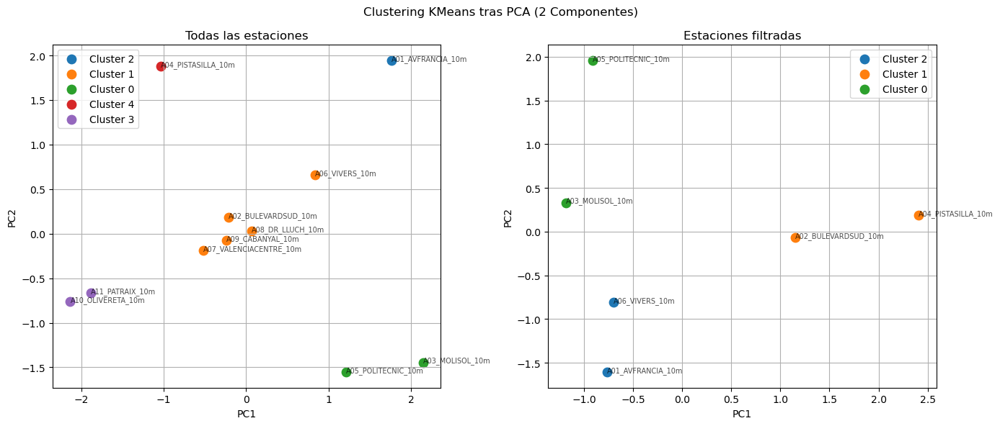

In [22]:
kmeans_all = KMeans(n_clusters=5, random_state=42).fit(X_all_pca)
kmeans_filt = KMeans(n_clusters=3, random_state=42).fit(X_filt_pca)

# DataFrame para visualización
df_vis_all = pd.DataFrame(X_all_pca, columns=['PC1', 'PC2'])
df_vis_all['Cluster'] = kmeans_all.labels_
df_vis_all['Estacion'] = df_grouped_all.index

df_vis_filt = pd.DataFrame(X_filt_pca, columns=['PC1', 'PC2'])
df_vis_filt['Cluster'] = kmeans_filt.labels_
df_vis_filt['Estacion'] = df_grouped_filt.index

fig, axes = plt.subplots(1, 2, figsize=(14, 6))
for ax, df_vis, title in zip(axes, [df_vis_all, df_vis_filt], ["Todas las estaciones", "Estaciones filtradas"]):
    for cluster_id in df_vis["Cluster"].unique():
        grupo = df_vis[df_vis["Cluster"] == cluster_id]
        ax.scatter(grupo["PC1"], grupo["PC2"], label=f'Cluster {cluster_id}', s=80)
        for _, row in grupo.iterrows():
            ax.text(row["PC1"], row["PC2"], row["Estacion"], fontsize=7, alpha=0.7)
    ax.set_title(title)
    ax.set_xlabel("PC1")
    ax.set_ylabel("PC2")
    ax.grid(True)
    ax.legend()

plt.suptitle("Clustering KMeans tras PCA (2 Componentes)")
plt.tight_layout()
plt.show()

## Selección de estaciones

Se seleccionan las estaciones Molí del Sol, Av. de Francia, Pista de Silla, Cabanyal y Valencia Centre porque combinan alta fiabilidad de datos, diversidad ambiental (zonas centro, costa, suburbano) y cobertura de diferentes perfiles de contaminación (tráfico, fondo, ozono, SO₂). Han mostrado anomalías claras (estadísticas y legales) y se sitúan en clusters distintos según el PCA, asegurando representatividad sin redundancia. 

## Modelado

### Generación de series temporales por estación y contaminante

En esta fase se preparan las series temporales individuales que servirán como entrada para los modelos de detección de anomalías. Para cada combinación de estación y contaminante, se construye un DataFrame con:
 
- Los valores diarios del contaminante, con índice temporal (dateObserved) en frecuencia diaria.

- Las etiquetas del comité de anomalíaa previamente calculadas mediante distintos criterios:

   - Regla de los 3 sigmas (Z-score).
   - Percentil 95.
   - Regla de Hampel (mediana ± 3 * MAD).
   - Umbrales legales de calidad del aire.

Este enfoque permite vincular cada observación con su clasificación como anómala o no bajo múltiples métodos, lo que resulta esencial para entrenar y comparar modelos supervisados y no supervisados.0

Además, se ha aplicado un umbral mínimo de observaciones (≥ 50) para garantizar que las series sean suficientemente informativas. El resultado es un conjunto estructurado y reutilizable de series temporales listas para el modelado, que mantienen tanto la información cuantitativa como las etiquetas de referencia para la validación del desempeño de los modelos.

In [23]:
def series_estacion_contaminante(df, estaciones, contaminantes):
    df = df.copy()
    df.index = pd.to_datetime(df.index)
    
    series_dict = {}
    
    for estacion in estaciones:
        df_est = df[df['entityId'] == estacion].copy()
        
        for cont in contaminantes:
            if cont not in df_est.columns:
                continue

            # Identifica etiquetas de anomalía disponibles
            etiquetas = [f"{cont}_anom_comite", f"{cont}_anom_legal"]
            columnas = [cont] + [e for e in etiquetas if e in df_est.columns]

            # Renombra y filtra valores nulos
            df_sub = df_est[columnas].rename(columns={cont: 'value'}).dropna(subset=['value'])
            df_sub = df_sub.asfreq('D')  # reindexa con frecuencia diaria
            df_sub['value'] = df_sub['value'].interpolate()

            if df_sub.shape[0] >= 50:
                series_dict[(estacion, cont)] = df_sub

    return series_dict


In [24]:
estaciones_sel = ['A01_AVFRANCIA_10m', 'A03_MOLISOL_10m', 'A04_PISTASILLA_10m', 'A09_CABANYAL_10m', 'A07_VALENCIACENTRE_10m']
contaminantes = ['NO2Value', 'PM25Value', 'O3Value', 'SO2Value']

# Generar las series
st_anomalias = series_estacion_contaminante(df_estacion, estaciones_sel, contaminantes)

Creamos ahora un DataFrame para cada contaminante de cada estación. 

In [25]:
# Diccionario con alias legibles para cada estación
nombres_estaciones = {
    'A01_AVFRANCIA_10m': 'avfrancia',
    'A03_MOLISOL_10m': 'molisol',
    'A04_PISTASILLA_10m': 'silla',
    'A07_VALENCIACENTRE_10m': 'centro',
    'A09_CABANYAL_10m': 'cabanyal'
}

# Alias legibles para contaminantes
alias_contaminantes = {
    'NO2Value': 'no2',
    'PM25Value': 'pm25',
    'O3Value': 'o3',
    'SO2Value': 'so2'
}

# Crear variables con los nombres deseados
for (estacion, contaminante), df in st_anomalias.items():
    if estacion in nombres_estaciones and contaminante in alias_contaminantes:
        nombre_variable = f"{nombres_estaciones[estacion]}_{alias_contaminantes[contaminante]}"
        globals()[nombre_variable] = df


### División train / test / validación

Esta función tiene como objetivo dividir una serie temporal en tres subconjuntos: entrenamiento (train), validación (val) y prueba (test), siguiendo una proporción de 70% / 15% / 15% respectivamente.

El resultado facilita tanto el entrenamiento del modelo (con los datos históricos), como la optimización de hiperparámetros (con la validación), y finalmente la evaluación objetiva del rendimiento (con el test).

In [26]:
def dividir_st(df, fecha_col='dateObserved'):
    df = df.sort_index()
    total_dias = len(df)
    
    n_train = int(0.7 * total_dias)
    
    df_train = df.iloc[:n_train]
    df_test = df.iloc[n_train:]
    
    return df_train, df_test

### Funciones para evaluar y comparar anomalías

- Precisión: proporción de verdaderos positivos entre todas las predicciones positivas del modelo. (¿Qué tan precisas son las anomalías que el modelo ha marcado como tales?)
- Recall: proporción de verdaderos positivos entre todas las anomalías reales existentes. (¿Cuántas de las anomalías reales ha logrado detectar el modelo?)
- F1: media entre precisión y recall. 

In [27]:
# Función para evaluar anomalías
def evaluar_anomalias(df, etiqueta_ref='anom_comite', col_modelo='anomaly'):
    if etiqueta_ref not in df.columns or col_modelo not in df.columns:
        return None
    
    y_true = df[etiqueta_ref].fillna(False).astype(bool)
    y_pred = df[col_modelo].fillna(False).astype(bool)

    tp = ((y_true == True) & (y_pred == True)).sum()
    return {
        'precision': precision_score(y_true, y_pred, zero_division=0),
        'recall': recall_score(y_true, y_pred, zero_division=0),
        'f1': f1_score(y_true, y_pred, zero_division=0),
        'n_comite': y_true.sum(),
        'n_detectadas': y_pred.sum(),
        'tp': tp
    }

In [28]:
def comparar_anomalias(df, etiqueta, col_modelo):
    # 1) Validar columnas
    faltan = [c for c in (col_modelo, etiqueta) if c not in df.columns]
    if faltan:
        print(f"  Saltando comparación: faltan columnas {faltan}")
        return {}

    # 2) Máscaras booleanas
    mask_modelo = df[col_modelo].fillna(False).astype(bool)
    mask_manual = df[etiqueta].fillna(False).astype(bool)

    # 3) Índices
    idx_modelo = df.index[mask_modelo]
    idx_manual = df.index[mask_manual]

    # 4) Coincidencias y discrepancias
    coinc = idx_modelo.intersection(idx_manual)
    fn    = idx_manual.difference(idx_modelo)
    fp    = idx_modelo.difference(idx_manual)

    # 5) Informe
    print(f"    Coinciden {len(coinc)} de {len(idx_manual)} anomalías manuales.")
    if len(idx_modelo) > 0:
        prec = len(coinc) / len(idx_modelo)
        print(f"    Precisión de coincidencias: {prec:.2f}")
    else:
        print("    El modelo no detectó ninguna anomalía.")

    # 6) Devolver subconjuntos
    return {
        'coincidencias':    df.loc[coinc].copy(),
        'falsos_negativos': df.loc[fn].copy(),
        'falsos_positivos': df.loc[fp].copy(),
    }


In [29]:
def evaluar_y_visualizar_anomalias(ruta_excel, col_modelo='anomaly', etiqueta_base='anom_comite'):
    xlsx = pd.ExcelFile(ruta_excel)
    hojas = xlsx.sheet_names

    resultados = []

    for hoja in hojas:
        df = xlsx.parse(hoja, index_col=0, parse_dates=True)

        partes = hoja.split('_')
        if len(partes) < 3:
            continue

        estacion = "_".join(partes[:2])
        contaminante_base = partes[2]
        contaminante = contaminante_base + 'Value'
        etiqueta = f"{contaminante}_{etiqueta_base}"

        print(f"Estación: {estacion} | Contaminante: {contaminante}")

        # Comparar anomalías (opcional)
        comparar_anomalias(df, etiqueta=etiqueta, col_modelo=col_modelo)

        # Evaluar
        resultado = evaluar_anomalias(df, etiqueta_ref=etiqueta, col_modelo=col_modelo)
        if resultado:
            resultado.update({
                'estacion': estacion,
                'contaminante': contaminante
            })
            resultados.append(resultado)

    # Si no hay resultados, salir
    if not resultados:
        print("No se encontraron resultados válidos para evaluar.")
        return

    # Convertir a DataFrame
    df_resultados = pd.DataFrame(resultados)

    columnas_esperadas = ['estacion', 'contaminante', 'n_comite', 'n_detectadas', 'tp',
                          'precision', 'recall', 'f1']
    if not all(col in df_resultados.columns for col in columnas_esperadas):
        print("El DataFrame de resultados no contiene todas las columnas necesarias.")
        print("Columnas disponibles:", df_resultados.columns.tolist())
        return

    df_resultados = df_resultados[columnas_esperadas]

    # Promedios por contaminante
    df_summary = df_resultados.groupby(['contaminante'])[['precision', 'recall', 'f1']].mean().reset_index()

    # Preparar para gráfico
    df_melt = df_summary.melt(id_vars=['contaminante'],
                              value_vars=['precision', 'recall', 'f1'],
                              var_name='métrica', value_name='valor')
    df_melt['grupo'] = df_melt['contaminante'] 
    
    # Gráfico
    plt.figure(figsize=(14, 6))
    ax = sns.barplot(data=df_melt, x='grupo', y='valor', hue='métrica', palette='Set2')

    for p in ax.patches:
        altura = p.get_height()
        if not pd.isna(altura):
            ax.annotate(f'{altura:.2f}', (p.get_x() + p.get_width() / 2., altura),
                        ha='center', va='bottom', fontsize=8)

    plt.title(f"Métricas promedio por contaminante ({col_modelo})")
    plt.ylabel("Valor")
    plt.ylim(0, 1.05)
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

### Función para visualizar las anomalías detectadas de cada uno de los modelos

In [30]:
def visualizar_anomalias(ruta_excel, estacion, contaminante,
                        col_anom_modelo='anomaly', modelo_label='ARIMA'):
    # Preparar nombres de hoja
    base = contaminante.replace("Value", "")
    hoja_train = f"{estacion}_{base}_train"
    hoja_test  = f"{estacion}_{base}_test"
    xlsx = pd.ExcelFile(ruta_excel)

    # Cargar datos
    df_train = xlsx.parse(hoja_train, index_col=0, parse_dates=True)
    df_test  = xlsx.parse(hoja_test,  index_col=0, parse_dates=True)
    est = estacion + '_10m'

    col_legal  = f"{contaminante}_anom_legal"
    col_comite = f"{contaminante}_anom_comite"
   
    fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=False)

    #Si añado gráfica de train
    #fig, axes = plt.subplots(3, 1, figsize=(14, 10), sharex=False)

    # TRAIN + TEST
    ax = axes[0]
    ax.set_title(f"{estacion} – {contaminante} | TRAIN + TEST")
    ax.plot(df_train['value'], label='Train real', color='orange')
    ax.plot(df_test ['value'], label='Test  real', color='red')
    if 'pred' in df_test.columns:
        ax.plot(df_test['pred'], label='Test pred', linestyle='--', color='purple')

    # Anomalías del modelo
    for df, label, color in zip([df_train, df_test], ['Train','Test'], ['red','purple']):
        if col_anom_modelo in df.columns:
            mask = df[col_anom_modelo].fillna(False).astype(bool)
            ix   = df.index[mask]
            ax.scatter(ix, df.loc[ix,'value'], marker='x', color=color,
                       label=f'Anom. {modelo_label} ({label})')

    # Anomalías legales
    df_all = pd.concat([df_train, df_test]).sort_index()
    if col_legal in df_all.columns:
        mask = df_all[col_legal].fillna(False).astype(bool) 
        ix   = df_all.index[mask]
        ax.scatter(ix, df_all.loc[ix,'value'],
                   facecolors='none', edgecolors='black',
                   marker='o', label='Anom. legal')

    # Anomalías del comité
    if col_comite in df_all.columns:
        fechas = comite_indices_estacion[est][contaminante]
        fechas_format = [ts.tz_convert(None) if ts.tzinfo else ts for ts in fechas]
        valores = df_all.loc[fechas_format, 'value']
        ax.scatter(fechas, valores, 
                   facecolors='none', edgecolors='steelblue',
                   marker='s', label='Anom. comité')

    ax.legend(loc='upper right')
    ax.grid(True)
    
    # TEST
    ax = axes[1]
    ax.set_title("TEST")
    ax.plot(df_test['value'], label='Test real', color='red')
    if 'pred' in df_test.columns:
        ax.plot(df_test['pred'], label='Test pred', linestyle='--', color='purple')

    # Modelo
    if col_anom_modelo in df_test.columns:
        mask = df_test[col_anom_modelo].fillna(False).astype(bool)
        ix   = df_test.index[mask]
        ax.scatter(ix, df_test.loc[ix,'value'],
                   marker='x', color='purple',
                   label=f'Anom. {modelo_label}')

    # Legal
    if col_legal in df_test.columns:
        mask = df_test[col_legal].fillna(False).astype(bool)
        ix   = df_test.index[mask]
        ax.scatter(ix, df_test.loc[ix,'value'],
                   facecolors='none', edgecolors='black',
                   marker='o', label='Anom. legal')

    # Comité
    if col_comite in df_test.columns:
        fechas = comite_indices_estacion[est][contaminante]
        fechas_format = [ts.tz_convert(None) if ts.tzinfo else ts for ts in fechas]
        index_test = df_test.index.intersection(fechas_format)
        valores = df_test.loc[index_test, 'value']
        ax.scatter(index_test, valores, 
                   facecolors='none', edgecolors='steelblue',
                   marker='s', label='Anom. comité')

    ax.legend()
    ax.grid(True)

    plt.tight_layout()
    plt.show()


### Métricas por estación y contaminante, junto con la matriz de confusión.

In [31]:
def plot_metrics_confusion(df, etiqueta_ref, col_modelo, title):
    """
    Dibuja (izq) barra Precision-Recall-F1 y (dcha) matriz de confusión
    en una sola figura de dos subplots.  Misma estética que usabas.
    """
    # datos
    y_true = df[etiqueta_ref].fillna(False).astype(int)
    y_pred = df[col_modelo].fillna(False).astype(int)

    prec = precision_score(y_true, y_pred, zero_division=0)
    rec  = recall_score   (y_true, y_pred, zero_division=0)
    f1   = f1_score       (y_true, y_pred, zero_division=0)
    cm   = confusion_matrix(y_true, y_pred, labels=[0, 1])

    # figura + axes
    fig, (ax_bar, ax_cm) = plt.subplots(
        1, 2, figsize=(7, 3), dpi=100, gridspec_kw={"wspace": 0.35}
    )

    # barra métricas
    sns.barplot(x=["precision", "recall", "f1"],
                y=[prec, rec, f1],
                palette="Set2",
                ax=ax_bar)
    ax_bar.set_ylim(0, 1)
    ax_bar.set_title(title, fontsize=10, pad=4)
    for i, v in enumerate([prec, rec, f1]):
        ax_bar.text(i, v + 0.03, f"{v:.2f}", ha="center")
    ax_bar.tick_params(axis="x", rotation=20)

    # matriz de confusión
    sns.heatmap(cm, annot=True, fmt="d", cbar=False, ax=ax_cm, cmap="Blues",
                xticklabels=["pred 0", "pred 1"],
                yticklabels=["true 0", "true 1"])
    ax_cm.set_title(title, fontsize=10, pad=4)
    ax_cm.set_xlabel("Predicción")
    ax_cm.set_ylabel("Verdad")

    plt.tight_layout()
    plt.show()

### ARIMA

Como aproximación inicial para la detección de anomalías en series temporales de calidad del aire, se ha empleado el modelo estadístico SARIMA (Seasonal ARIMA) como línea base. Este modelo ha sido ajustado de manera individual para cada combinación de estación de medición y contaminante (NO₂, O₃, PM2.5 y SO₂), realizando una búsqueda automática del mejor conjunto de parámetros mediante minimización del criterio AIC. El entrenamiento se realizó exclusivamente con los datos del conjunto de entrenamiento, excluyendo valores previamente marcados como anómalos mediante la regla de Hampel, lo que permitió un ajuste más robusto sobre patrones regulares del comportamiento de cada serie.

Una vez ajustado el modelo, se procedió a realizar predicciones sobre los conjuntos de validación y test. Las anomalías fueron detectadas a partir de los residuos del modelo, considerando como tales aquellos puntos cuya diferencia entre valor real y predicho excedía tres veces la desviación estándar (criterio clásico de anomalía estadística basado en 3σ). Esta detección se comparó con etiquetas previas consideradas como “verdad de referencia”, con el consenso del comité realizado.

In [32]:
def entrenar_auto_arima(df, contaminante, seasonal=True):
    # 1. División temporal
    df_train, df_test = dividir_st(df)

    # 2. Filtrado de anomalías en entrenamiento (Comité)
    col_anom = f"{contaminante}_anom_comite"
    df_train['value_clean'] = df_train['value']
    if col_anom in df_train.columns:
        mask = df_train[col_anom].fillna(False).astype(bool)
        df_train.loc[mask, 'value_clean'] = np.nan
        df_train['value_clean'] = df_train['value_clean'].interpolate(method='time').ffill(limit=2).bfill(limit=2)
    else:
        print(f"{col_anom} no disponible, no se filtran outliers.")

    # 3. Selección automática de mejor modelo SARIMA
    mejor_modelo = None
    mejor_aic = np.inf
    for m in [7, 14, 30]:
        try:
            modelo = auto_arima(df_train['value_clean'].dropna(),
                                seasonal=seasonal,
                                m=m,
                                stepwise=True,
                                suppress_warnings=True,
                                error_action='ignore')
            if modelo.aic() < mejor_aic:
                mejor_modelo = modelo
                mejor_aic = modelo.aic()
        except:
            continue

    if mejor_modelo is None:
        raise ValueError("No se pudo ajustar ningún modelo SARIMA válido.")

    modelo = mejor_modelo
    print(f"Modelo SARIMA: {modelo.order} x {modelo.seasonal_order} (AIC: {modelo.aic()})")

    # 4. Predicción sobre test
    pred_test = pd.Series(modelo.predict(n_periods=len(df_test)), index=df_test.index)

    # 5. Cálculo de residuos y detección de anomalías
    # Detectar anomalías en TEST con su propio umbral
    df_test['pred'] = pred_test
    df_test['residual'] = df_test['value'] - df_test['pred']
    std_test = df_test['residual'].std()
    df_test['anomaly'] = df_test['residual'].abs() > (3 * std_test)

    return modelo, df_train, df_test

In [33]:
os.makedirs("modelos/arima", exist_ok=True)

# Diccionario para guardar hojas
hojas_excel = {}

for estacion in estaciones_sel:
    for contaminante in ['NO2Value', 'O3Value', 'PM25Value', 'SO2Value']:
        clave = (estacion, contaminante)
        if clave not in st_anomalias:
            continue

        df = st_anomalias[clave]
        print(f"Estación: {estacion} | Contaminante: {contaminante}")
        _, df_train, df_test = entrenar_auto_arima(df=df, contaminante=contaminante)
        
        # Nombre de hoja válido
        hoja_train = f"{estacion}_{contaminante}_train".replace("Value", "").replace("_10m", "")[:31]
        hoja_test = f"{estacion}_{contaminante}_test".replace("Value", "").replace("_10m", "")[:31]

        df_train.index = df_train.index.tz_localize(None)
        df_test.index = df_test.index.tz_localize(None)
        
        hojas_excel[hoja_train] = df_train
        hojas_excel[hoja_test] = df_test

Estación: A01_AVFRANCIA_10m | Contaminante: NO2Value
Modelo SARIMA: (1, 1, 1) x (0, 0, 2, 7) (AIC: 3391.5918443823866)
Estación: A01_AVFRANCIA_10m | Contaminante: O3Value
Modelo SARIMA: (2, 1, 1) x (0, 0, 1, 30) (AIC: 4474.729348236335)
Estación: A01_AVFRANCIA_10m | Contaminante: PM25Value
Modelo SARIMA: (1, 1, 2) x (1, 0, 0, 7) (AIC: 2800.238000407444)
Estación: A01_AVFRANCIA_10m | Contaminante: SO2Value
Modelo SARIMA: (1, 1, 1) x (0, 0, 0, 7) (AIC: 1076.1205922711267)
Estación: A03_MOLISOL_10m | Contaminante: NO2Value
Modelo SARIMA: (0, 1, 5) x (0, 0, 2, 14) (AIC: 3643.405877476527)
Estación: A03_MOLISOL_10m | Contaminante: O3Value
Modelo SARIMA: (1, 1, 1) x (0, 0, 0, 7) (AIC: 4520.635909407055)
Estación: A03_MOLISOL_10m | Contaminante: PM25Value
Modelo SARIMA: (1, 1, 1) x (0, 0, 0, 7) (AIC: 3211.849008799595)
Estación: A03_MOLISOL_10m | Contaminante: SO2Value
Modelo SARIMA: (1, 0, 2) x (0, 0, 0, 7) (AIC: 2359.405151520135)
Estación: A04_PISTASILLA_10m | Contaminante: NO2Value
Modelo

In [34]:
# Guardar Excel
ruta_excel = "modelos/arima/anomalias_SARIMA.xlsx"
with pd.ExcelWriter(ruta_excel, engine='xlsxwriter') as writer:
    for hoja, df_hoja in hojas_excel.items():
        df_hoja.to_excel(writer, sheet_name=hoja)

Una vez guardado el resultado de los modelos ARIMA, vemos el resultado de estos. 

Estación: A01_AVFRANCIA | Contaminante: NO2Value
  Saltando comparación: faltan columnas ['anomaly']
Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 10 de 29 anomalías manuales.
    Precisión de coincidencias: 0.91
Estación: A01_AVFRANCIA | Contaminante: O3Value
  Saltando comparación: faltan columnas ['anomaly']
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 0 anomalías manuales.
    El modelo no detectó ninguna anomalía.
Estación: A01_AVFRANCIA | Contaminante: PM25Value
  Saltando comparación: faltan columnas ['anomaly']
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 7 de 23 anomalías manuales.
    Precisión de coincidencias: 1.00
Estación: A01_AVFRANCIA | Contaminante: SO2Value
  Saltando comparación: faltan columnas ['anomaly']
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 0 de 23 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A03_MOLISOL | Contaminante: NO2Value
  Saltando comparación: faltan 

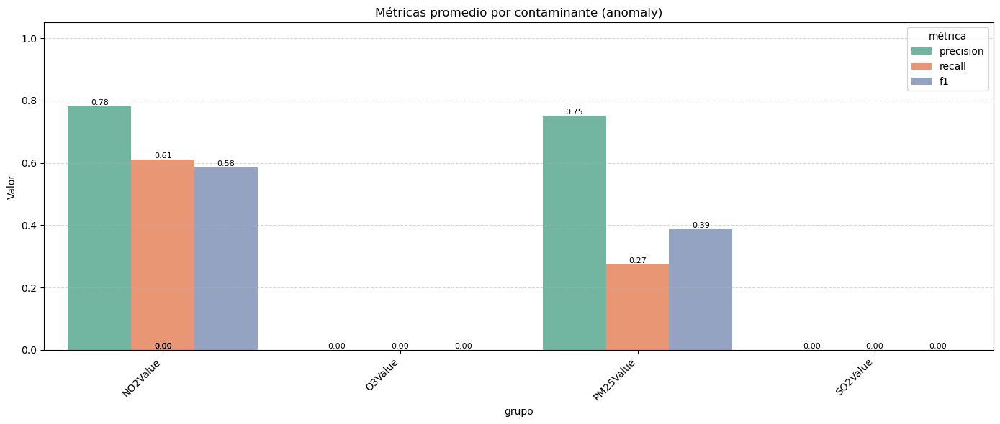

In [35]:
evaluar_y_visualizar_anomalias("modelos/arima/anomalias_SARIMA.xlsx", col_modelo='anomaly')

La evaluación se realizó calculando para cada estación y contaminante las métricas estándar: precisión, recall y F1-score, y visualizando también la cantidad de anomalías coincidentes entre el modelo y las etiquetas manuales. Los resultados muestran que el rendimiento del modelo varía considerablemente según el contaminante. En el caso de PM2.5, los resultados fueron positivos, con altos niveles de coincidencia entre el modelo y las etiquetas manuales, y F1-scores elevados tanto en validación como en test. En cambio, para contaminantes como O₃ y SO₂, el modelo apenas detectó anomalías, lo que se refleja en F1-scores nulos o muy bajos. En NO₂, los resultados son más heterogéneos: algunas estaciones alcanzan buena precisión en validación, pero la detección en test es muy escasa o inexistente.

En general, el modelo SARIMA ha demostrado tener una buena capacidad de detección en series con estacionalidad clara o comportamiento regular, como las de PM2.5, siendo especialmente preciso (cuando detecta anomalías, suele acertar). Sin embargo, su sensibilidad es limitada, ya que no logra detectar muchas de las anomalías etiquetadas previamente (recall bajo en varios casos). Esto lo convierte en una herramienta útil como línea base interpretativa, pero insuficiente para una detección más exhaustiva en todos los contaminantes o contextos.

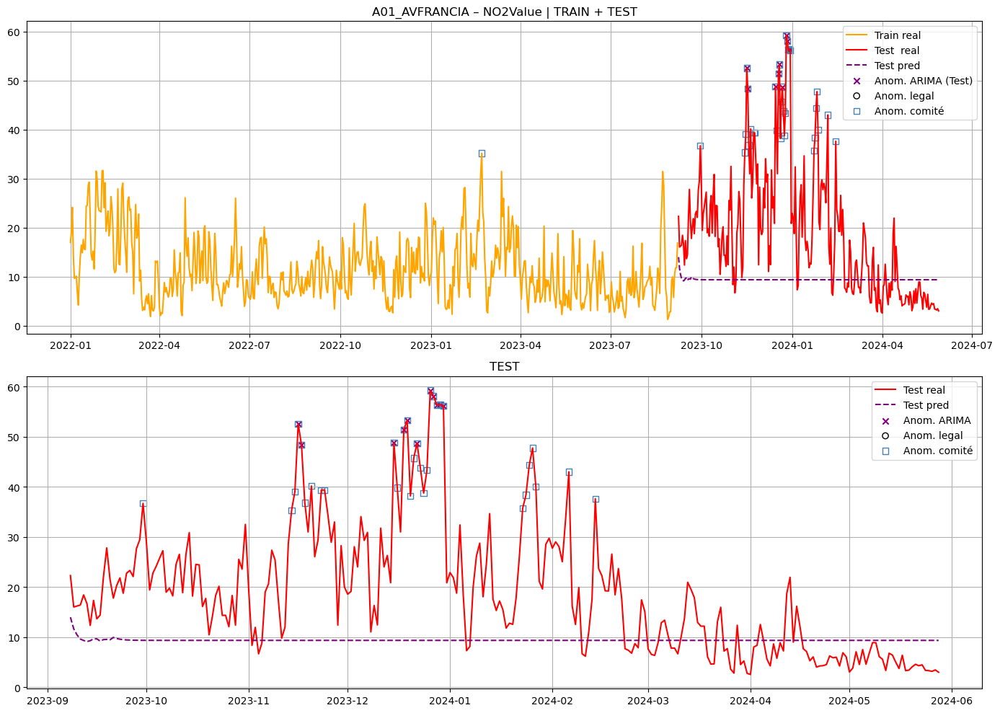

In [36]:
visualizar_anomalias(
    ruta_excel="modelos/arima/anomalias_SARIMA.xlsx",
    estacion="A01_AVFRANCIA",
    contaminante="NO2Value",
    col_anom_modelo='anomaly',
    modelo_label='ARIMA')

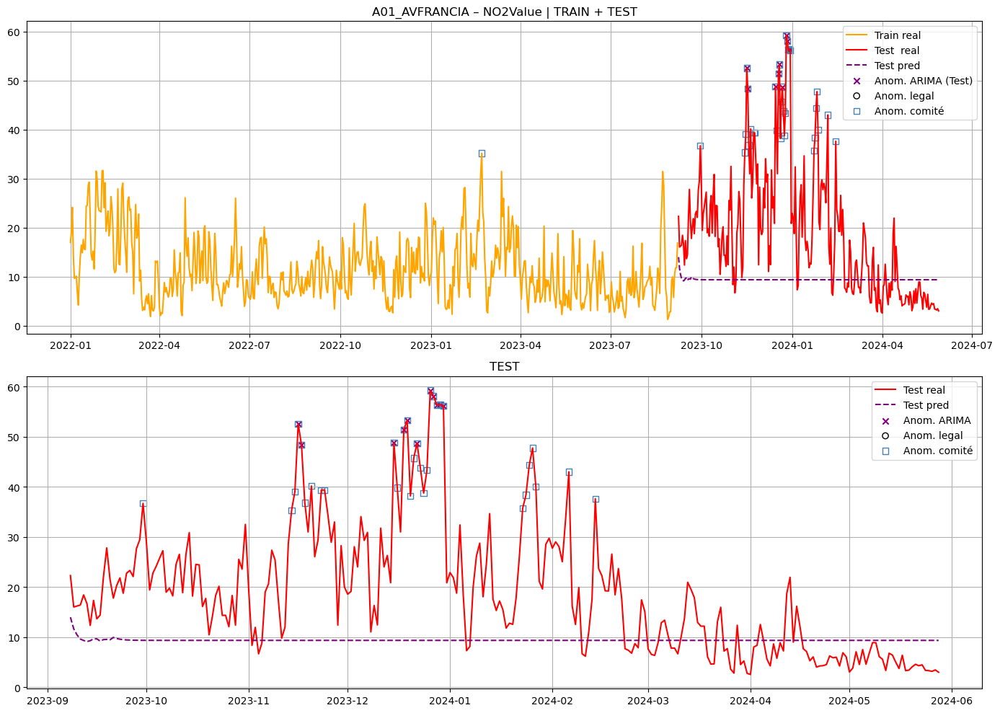

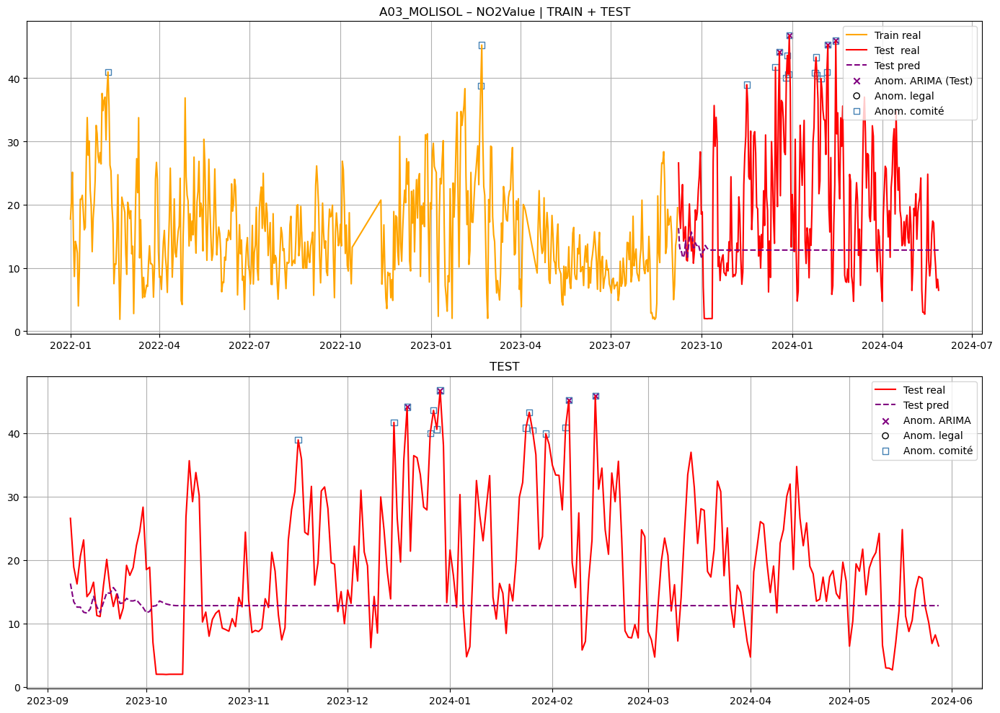

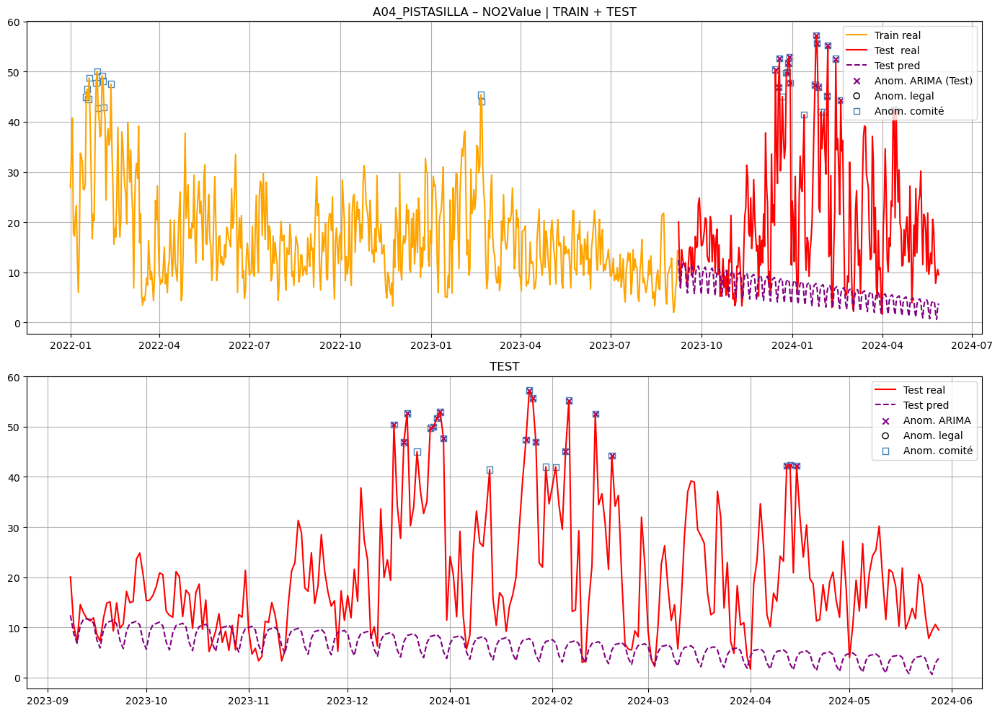

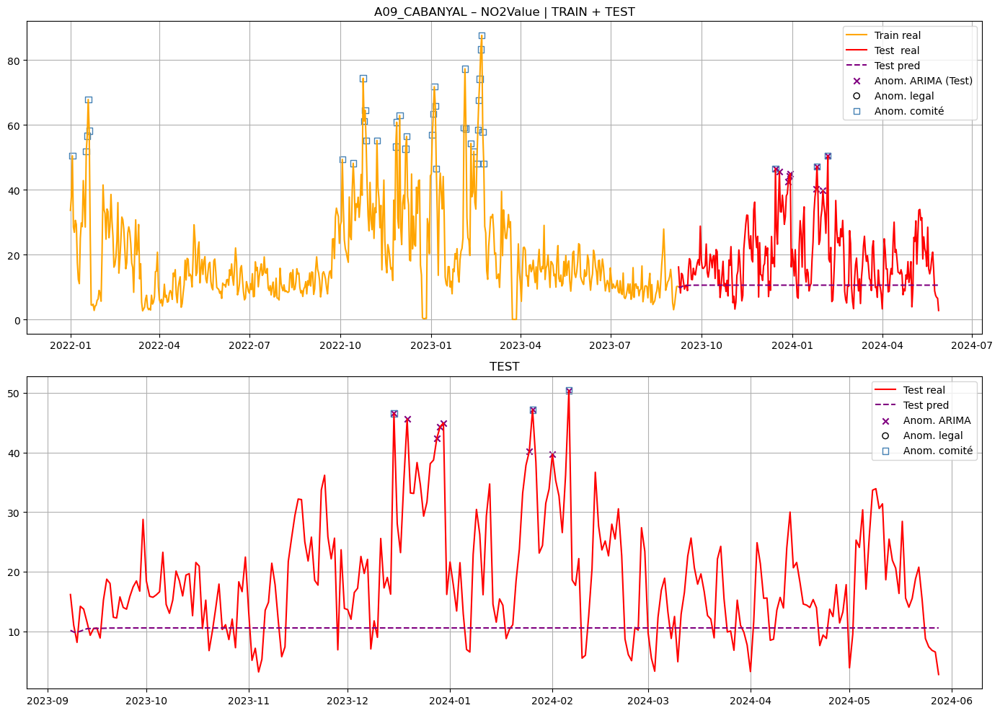

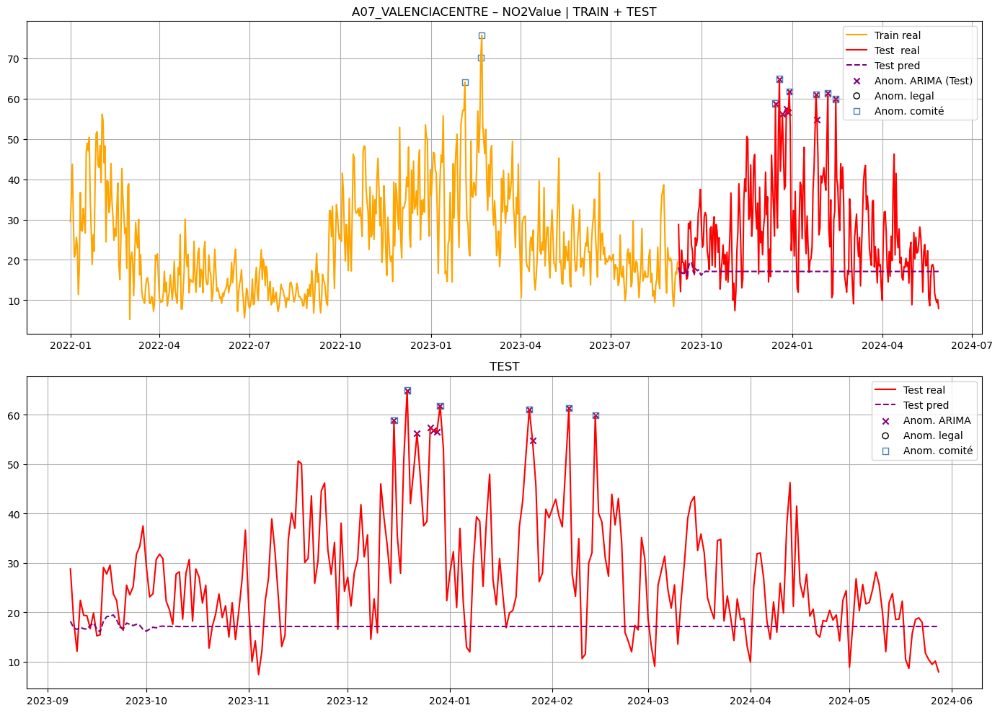

...

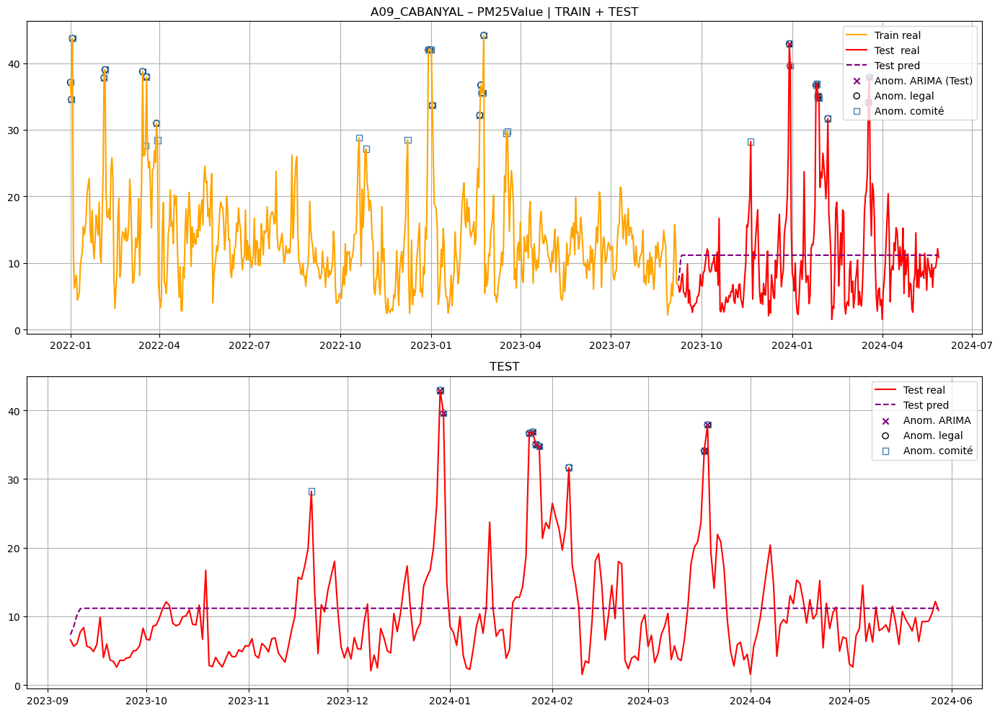

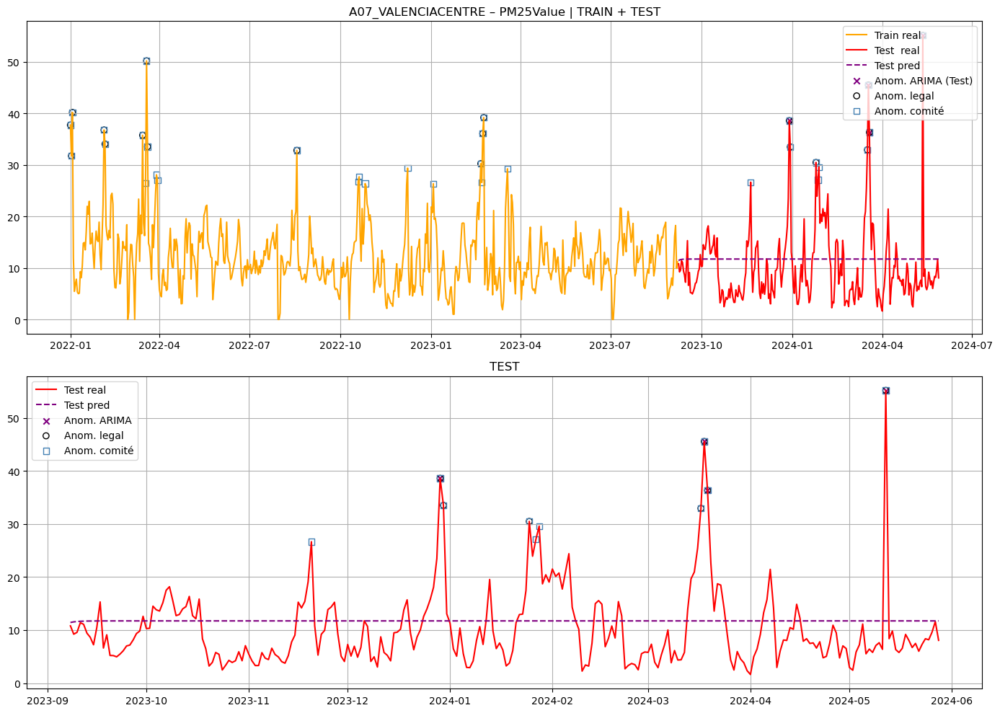

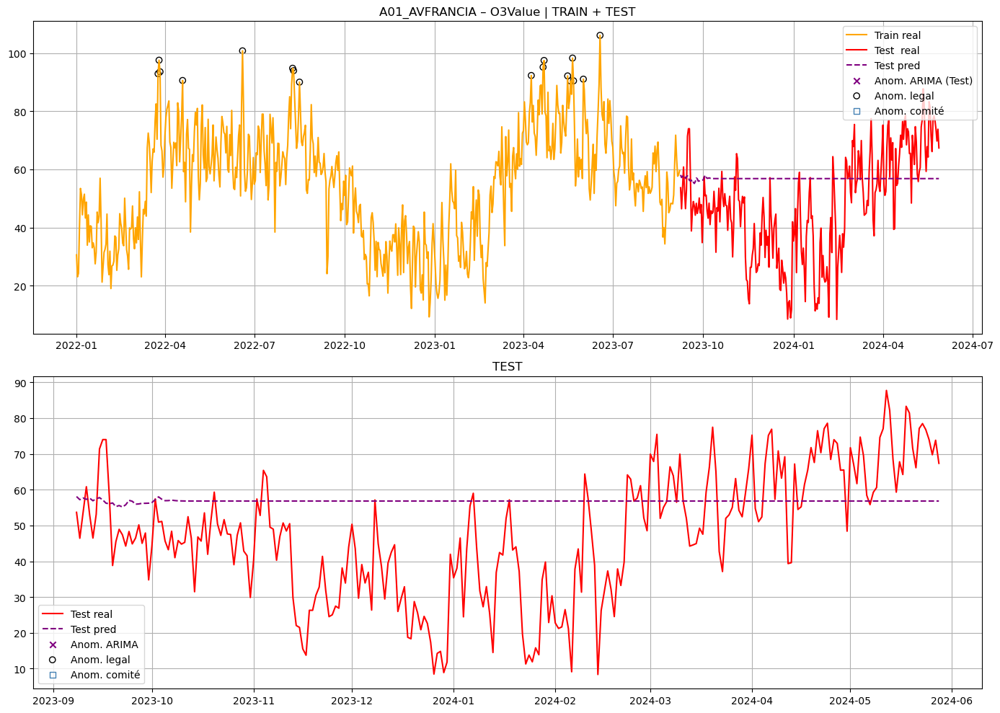

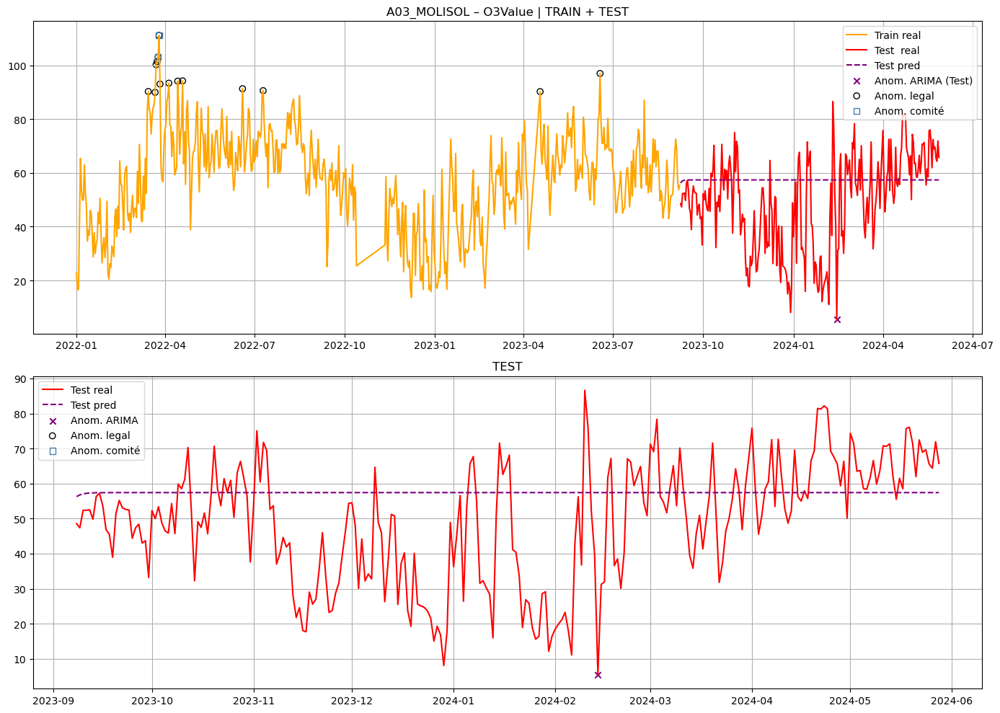

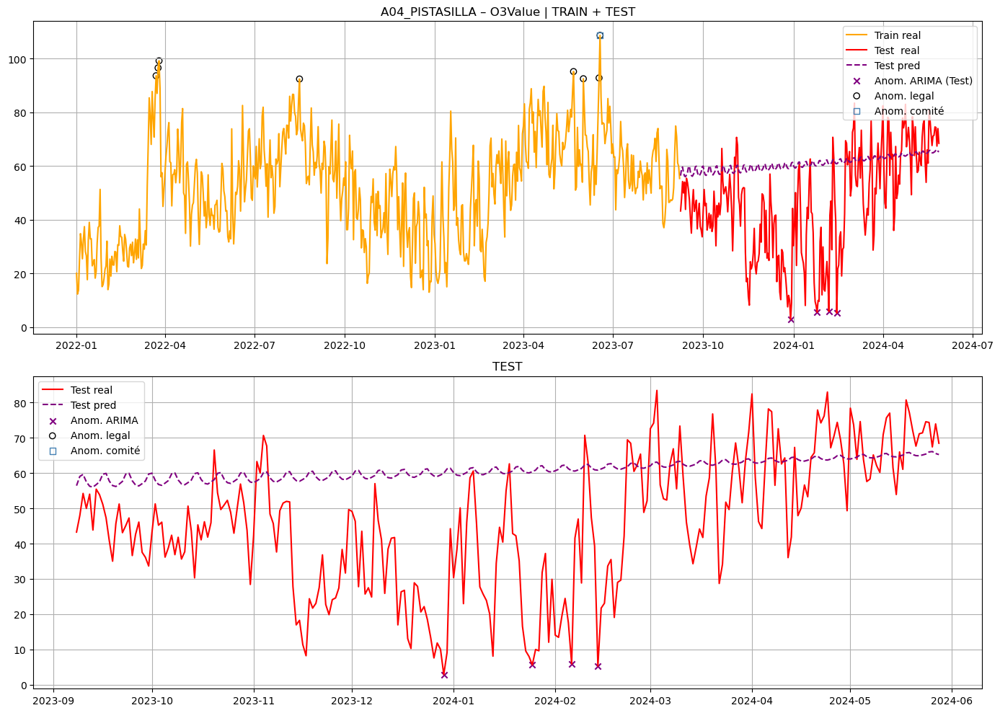

Error en A09_CABANYAL - O3Value: Worksheet named 'A09_CABANYAL_O3_train' not found
Error en A07_VALENCIACENTRE - O3Value: Worksheet named 'A07_VALENCIACENTRE_O3_train' not found


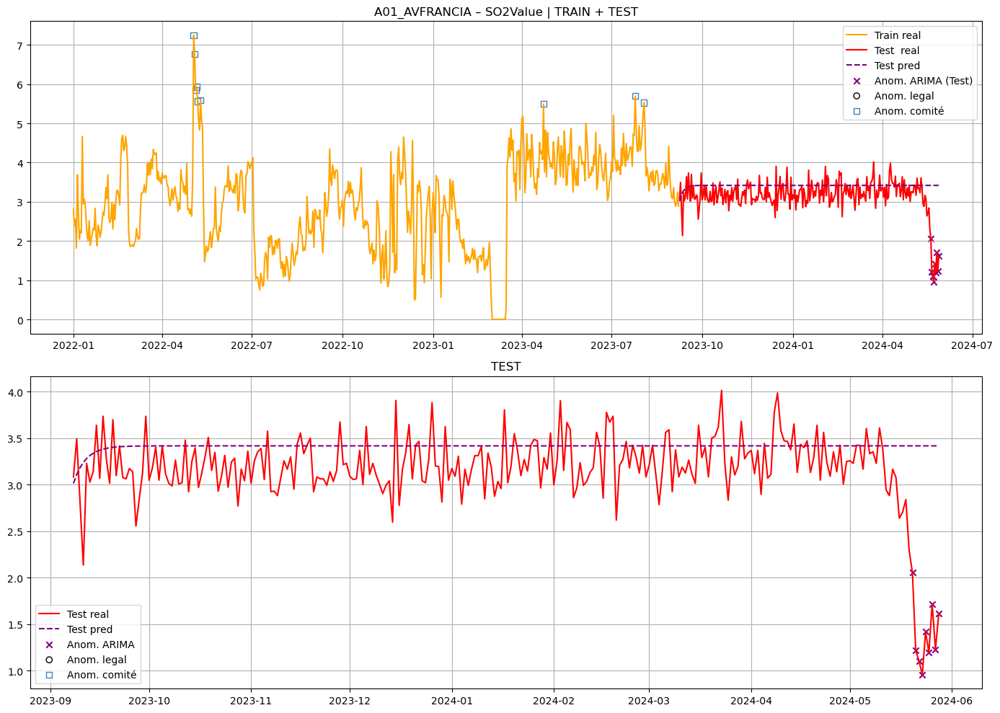

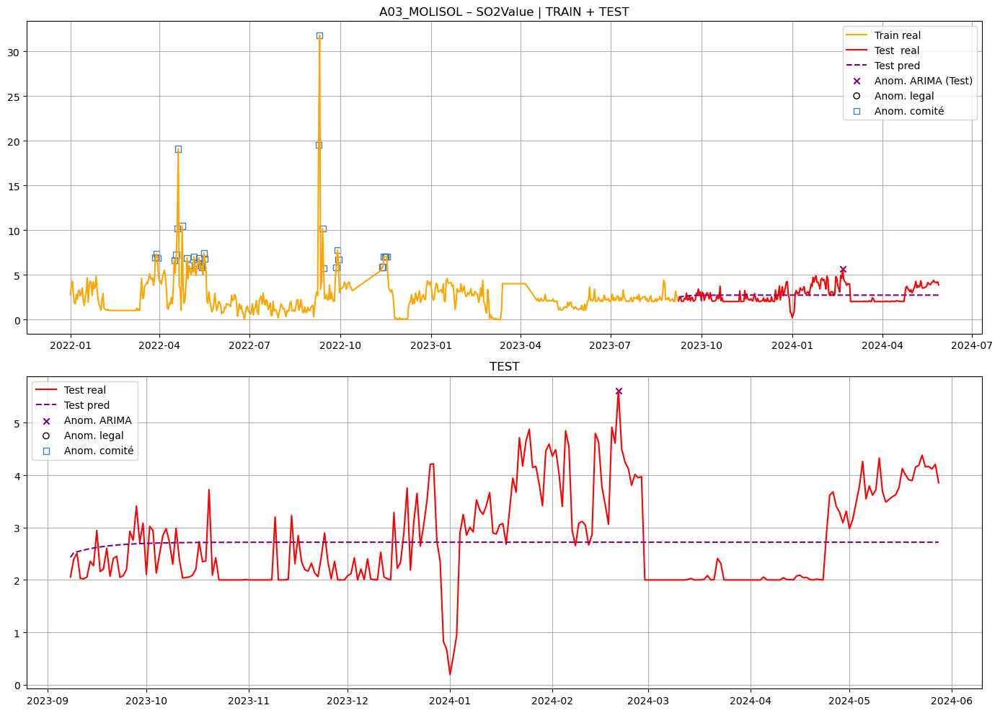

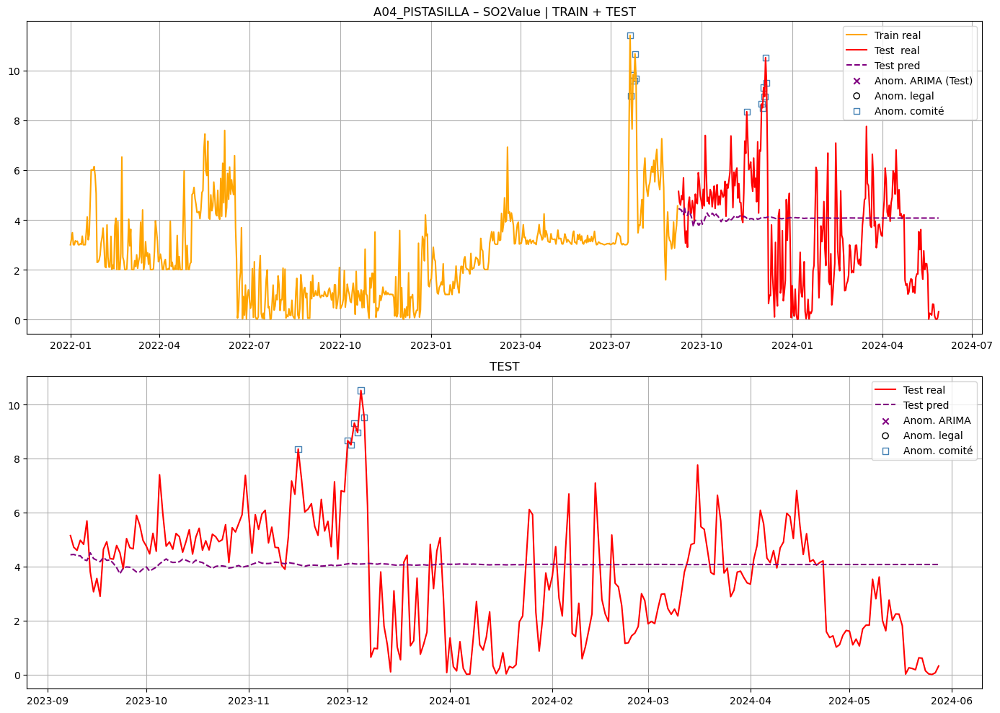

Error en A09_CABANYAL - SO2Value: Worksheet named 'A09_CABANYAL_SO2_train' not found
Error en A07_VALENCIACENTRE - SO2Value: Worksheet named 'A07_VALENCIACENTRE_SO2_train' not found


In [37]:
for contaminante in contaminantes:
    for estacion in estaciones_sel:
        estacion = estacion.replace("_10m", "")
        try:
            visualizar_anomalias(
                ruta_excel="modelos/arima/anomalias_SARIMA.xlsx",
                estacion=estacion,
                contaminante=contaminante,
                col_anom_modelo='anomaly',
                modelo_label='ARIMA'
            )
        except Exception as e:
            print(f"Error en {estacion} - {contaminante}: {e}")

Vemos las matrices de confusión y las métricas por estación y contaminante. 

PARA LAS ANOMALÍAS DEL COMITÉ

 A01_AVFRANCIA – NO2Value


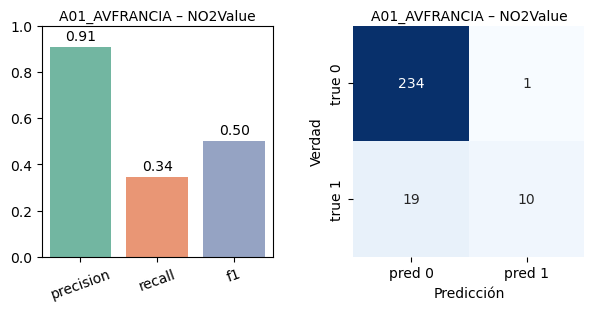


 A01_AVFRANCIA – O3Value


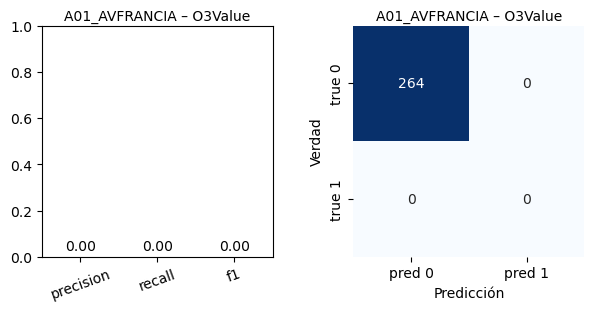


 A01_AVFRANCIA – PM25Value


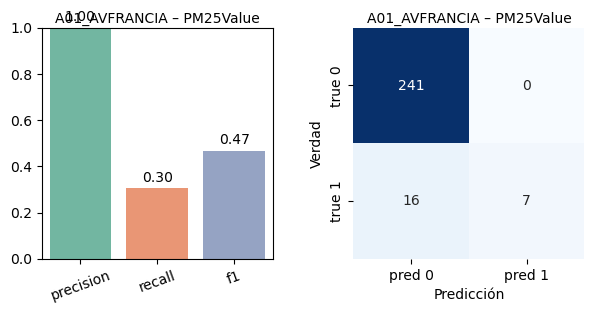


 A01_AVFRANCIA – SO2Value


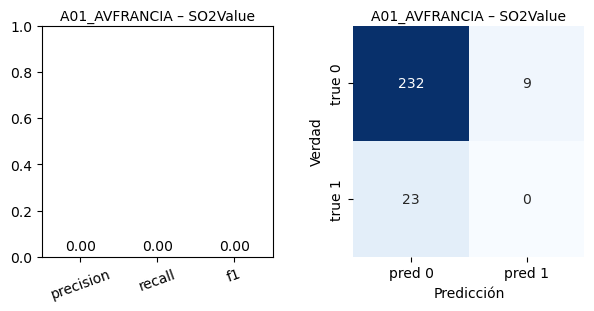


 A03_MOLISOL – NO2Value


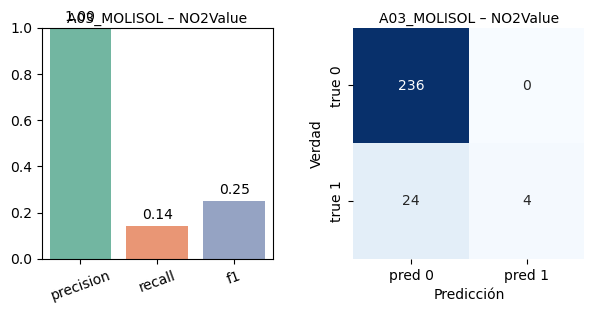


 A03_MOLISOL – O3Value


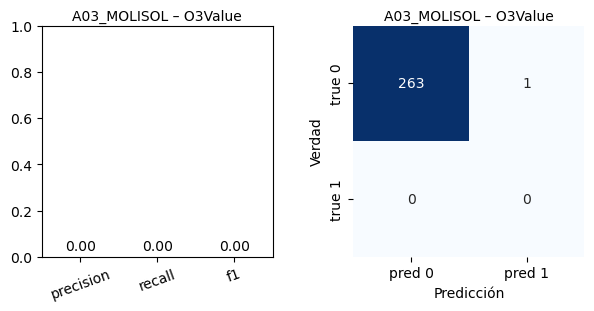


 A03_MOLISOL – PM25Value


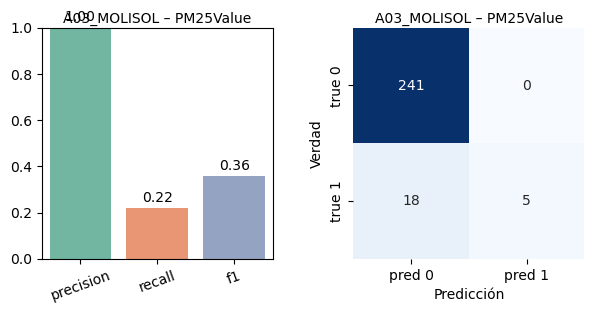


 A03_MOLISOL – SO2Value


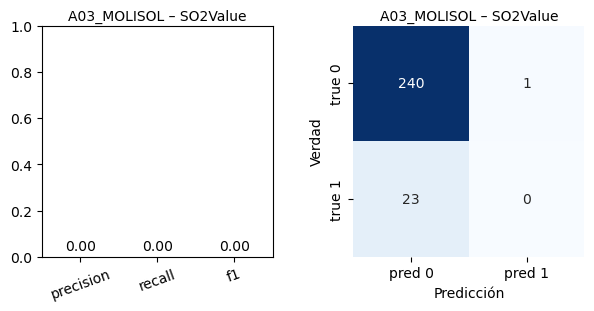


 A04_PISTASILLA – NO2Value


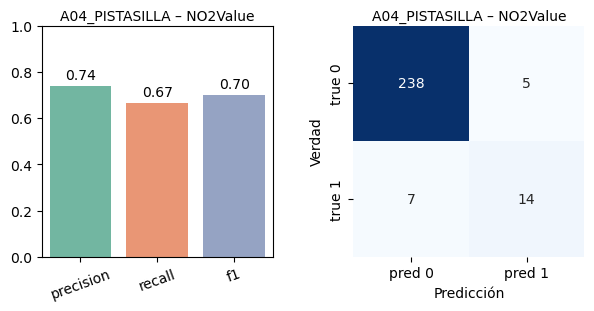


 A04_PISTASILLA – O3Value


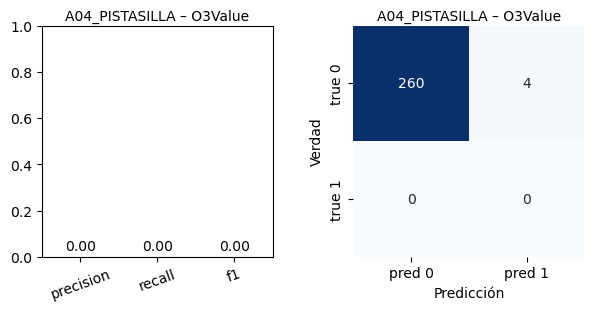


 A04_PISTASILLA – PM25Value


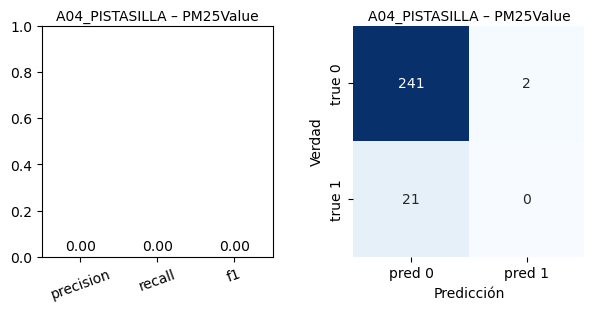


 A04_PISTASILLA – SO2Value


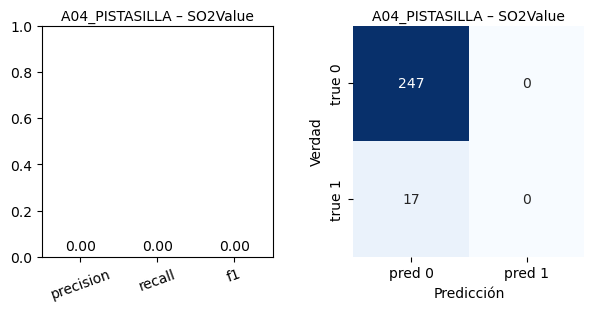


 A09_CABANYAL – NO2Value


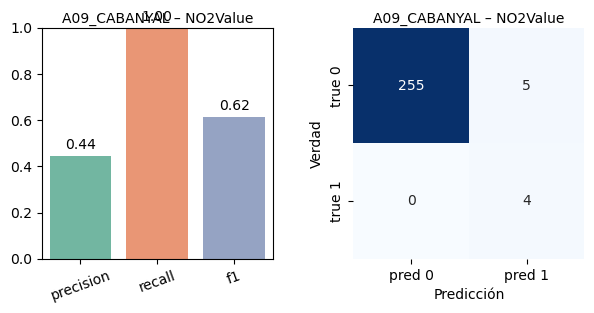


 A09_CABANYAL – PM25Value


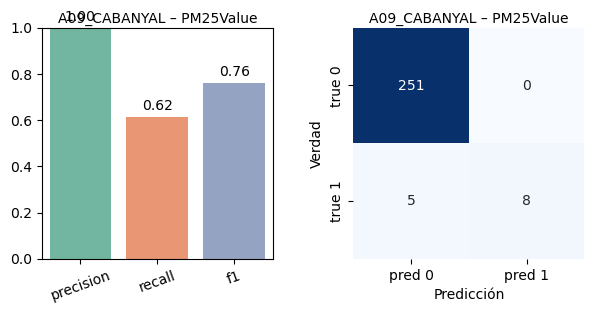


 A07_VALENCIACENTRE – NO2Value


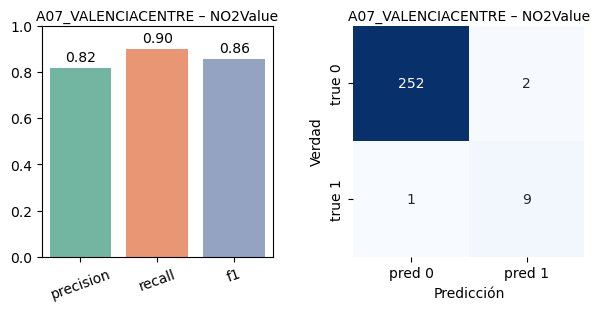


 A07_VALENCIACENTRE – PM25Value


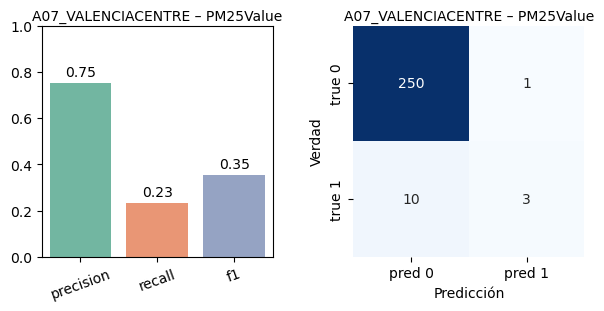

PARA LAS ANOMALÍAS LEGALES

 A01_AVFRANCIA – NO2Value


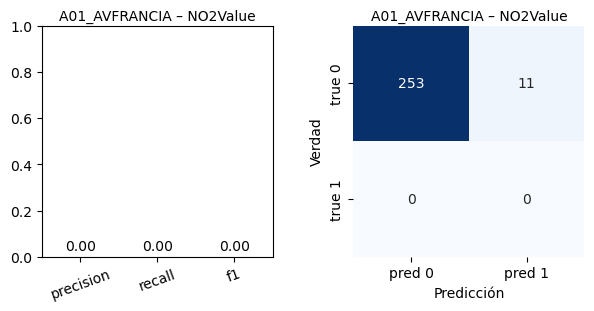


 A01_AVFRANCIA – O3Value


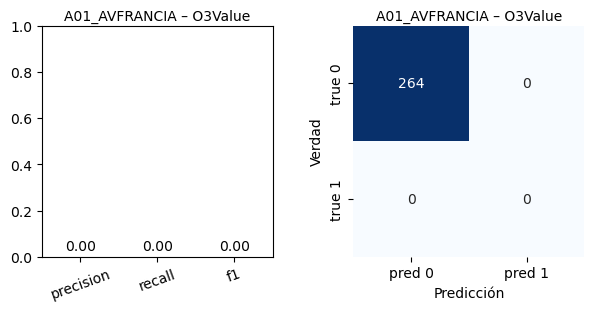


 A01_AVFRANCIA – PM25Value


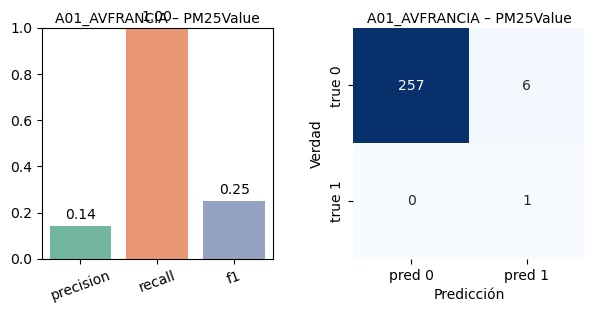


 A01_AVFRANCIA – SO2Value


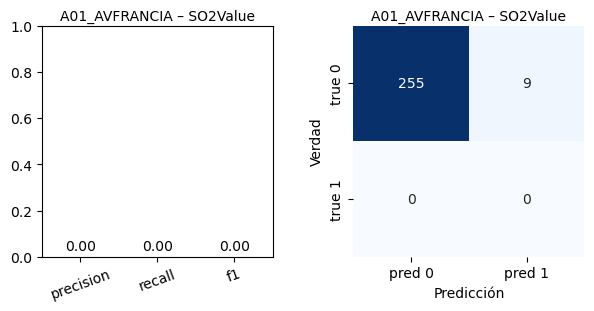


 A03_MOLISOL – NO2Value


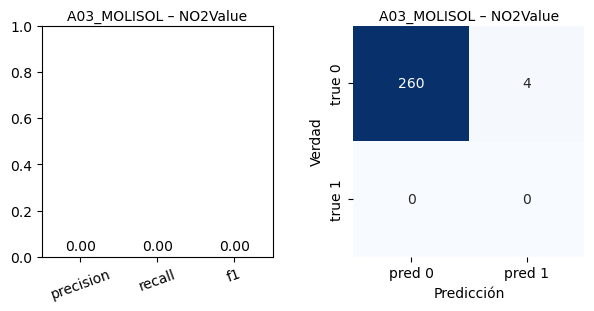


 A03_MOLISOL – O3Value


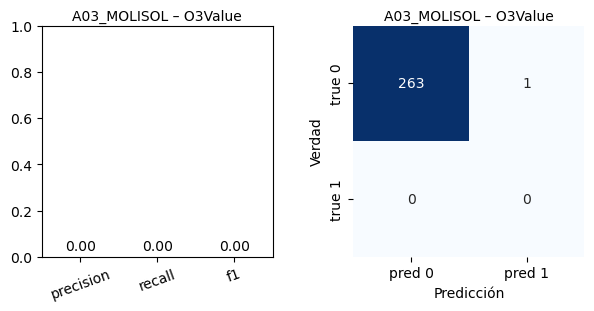


 A03_MOLISOL – PM25Value


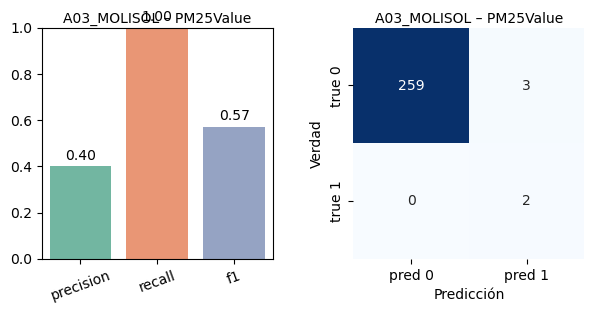


 A03_MOLISOL – SO2Value


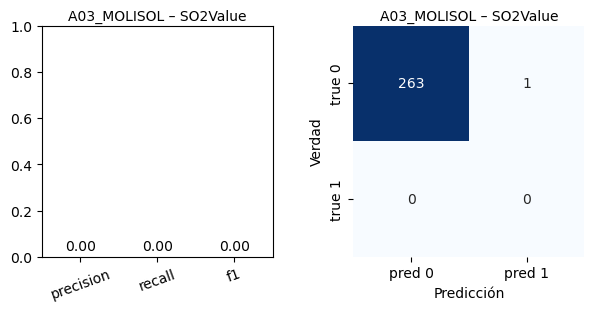


 A04_PISTASILLA – NO2Value


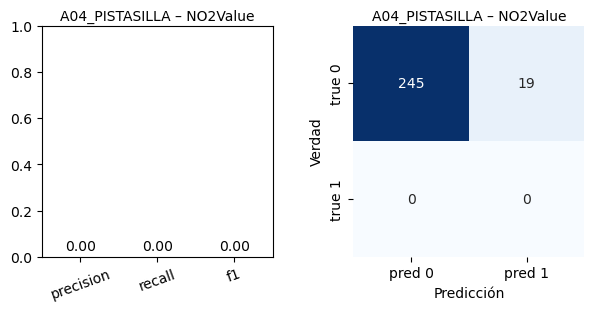


 A04_PISTASILLA – O3Value


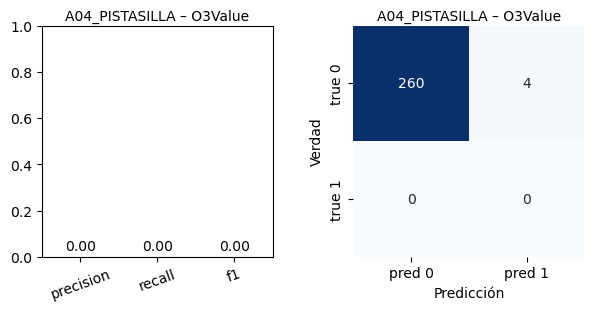


 A04_PISTASILLA – PM25Value


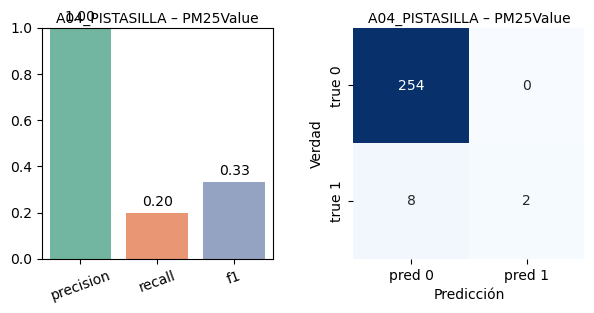


 A04_PISTASILLA – SO2Value


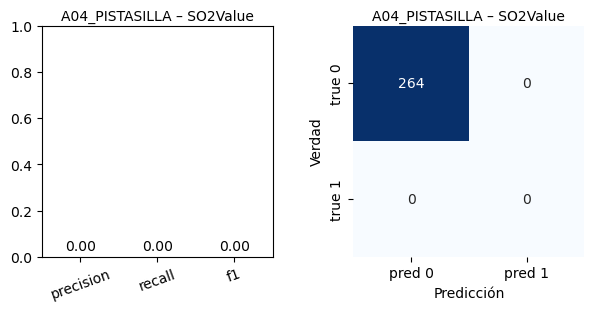


 A09_CABANYAL – NO2Value


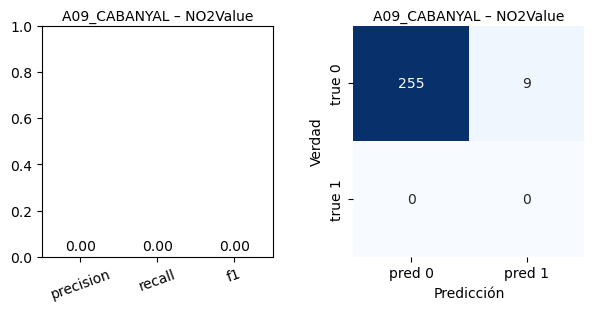


 A09_CABANYAL – PM25Value


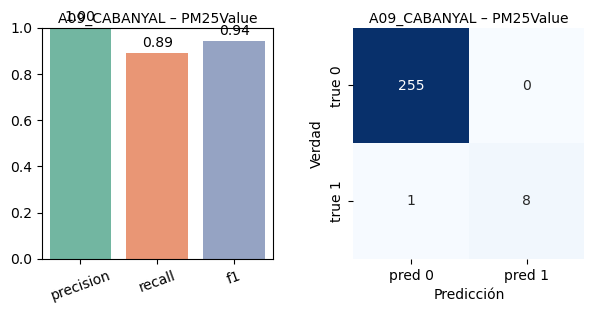


 A07_VALENCIACENTRE – NO2Value


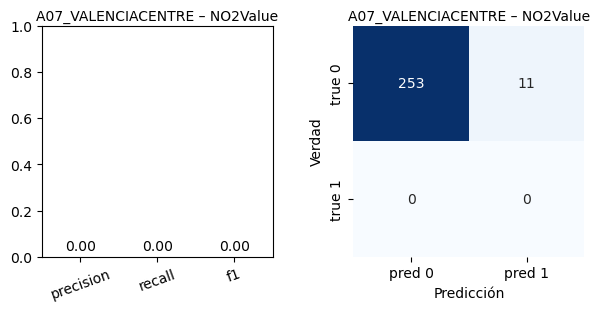


 A07_VALENCIACENTRE – PM25Value


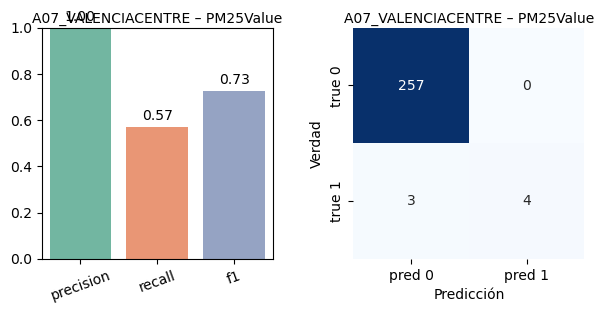

In [38]:
# --- bucle para todas las hojas train+test ---
ruta = "modelos/arima/anomalias_SARIMA.xlsx"
xlsx  = pd.ExcelFile(ruta)

print("PARA LAS ANOMALÍAS DEL COMITÉ")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_comite"
    col_modelo  = "anomaly" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

print("PARA LAS ANOMALÍAS LEGALES")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_legal"
    col_modelo  = "anomaly" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

### Isolation Forest

In [39]:
def preparar_features(df):
    df_feat = df[['value']].copy()
    # Lags
    df_feat['lag1'] = df_feat['value'].shift(1)
    df_feat['lag7'] = df_feat['value'].shift(7)
    # Estadísticas móviles
    df_feat['roll_mean7'] = df_feat['value'].rolling(7, min_periods=5).mean()
    df_feat['roll_std7'] = df_feat['value'].rolling(7, min_periods=5).std().fillna(0)
    df_feat['z_score'] = (df_feat['value'] - df_feat['roll_mean7']) / df_feat['roll_std7']

    # Variables temporales
    df_feat['dayofweek'] = df.index.dayofweek
    df_feat['month'] = df.index.month
    df_feat['is_weekend'] = (df.index.dayofweek >= 5).astype(int)
    df_feat = pd.get_dummies(df_feat, columns=['is_weekend'], drop_first=True)
    df_feat = df_feat.dropna()
    return df_feat

In [40]:
def detectar_anomalias_isolation(df, contamination='auto', plot=True):
    # 1. Dividir en train, val, test
    df_train, df_test = dividir_st(df)

    # 2. Preparar features
    X_train = preparar_features(df_train)
    X_test = preparar_features(df_test)

    # 3. Entrenar Isolation Forest

    modelo = IsolationForest(contamination=contamination, random_state=42)
    modelo.fit(X_train)

    # 4. Predecir en test
    df_test_res = df_test.loc[X_test.index].copy()

    df_test_res['anomaly_iso'] = modelo.predict(X_test) == -1


    return modelo, df_train, df_test_res

In [41]:
os.makedirs("modelos/isolation", exist_ok=True)
hojas_excel_iso = {}

for estacion in estaciones_sel:
    for contaminante in ['NO2Value', 'O3Value', 'PM25Value', 'SO2Value']:
        clave = (estacion, contaminante)
        if clave not in st_anomalias:
            continue

        df = st_anomalias[clave]
        
        etiqueta_comite = f"{contaminante}_anom_comite"
        etiqueta_legal = f"{contaminante}_anom_legal"

        # Calcular tasa de anomalías conocidas
        total_anomalias = 0
        if etiqueta_comite in df.columns:
            total_anomalias += df[etiqueta_comite].sum()
        if etiqueta_legal in df.columns:
            total_anomalias += df[etiqueta_legal].sum()

        # Ratio sobre total de muestras
        contamination = total_anomalias / len(df)
        contamination = min(max(contamination, 0.005), 0.05)  # límites entre 0.5% y 5%

        modelo, df_train, df_test = detectar_anomalias_isolation(df, contamination=contamination)

        hoja_train = f"{estacion}_{contaminante}_train".replace("Value", "").replace("_10m", "")[:31]
        hoja_test = f"{estacion}_{contaminante}_test".replace("Value", "").replace("_10m", "")[:31]

        df_train.index = df_train.index.tz_localize(None)
        df_test.index = df_test.index.tz_localize(None)

        hojas_excel_iso[hoja_train] = df_train
        hojas_excel_iso[hoja_test] = df_test

ruta_excel_iso = "modelos/isolation/anomalias_IsolationForest.xlsx"
with pd.ExcelWriter(ruta_excel_iso, engine='xlsxwriter') as writer:
    for hoja, df_hoja in hojas_excel_iso.items():
        df_hoja.to_excel(writer, sheet_name=hoja)


Una vez guardado el resultado del modelo Isolation Forest, vemos el resultado de estos. 

Estación: A01_AVFRANCIA | Contaminante: NO2Value
  Saltando comparación: faltan columnas ['anomaly_iso']
Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 22 de 29 anomalías manuales.
    Precisión de coincidencias: 0.18
Estación: A01_AVFRANCIA | Contaminante: O3Value
  Saltando comparación: faltan columnas ['anomaly_iso']
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 0 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A01_AVFRANCIA | Contaminante: PM25Value
  Saltando comparación: faltan columnas ['anomaly_iso']
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 14 de 23 anomalías manuales.
    Precisión de coincidencias: 0.48
Estación: A01_AVFRANCIA | Contaminante: SO2Value
  Saltando comparación: faltan columnas ['anomaly_iso']
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 0 de 23 anomalías manuales.
    El modelo no detectó ninguna anomalía.
Estación: A03_MOLISOL | Contaminante: NO2Value
  Saltando com

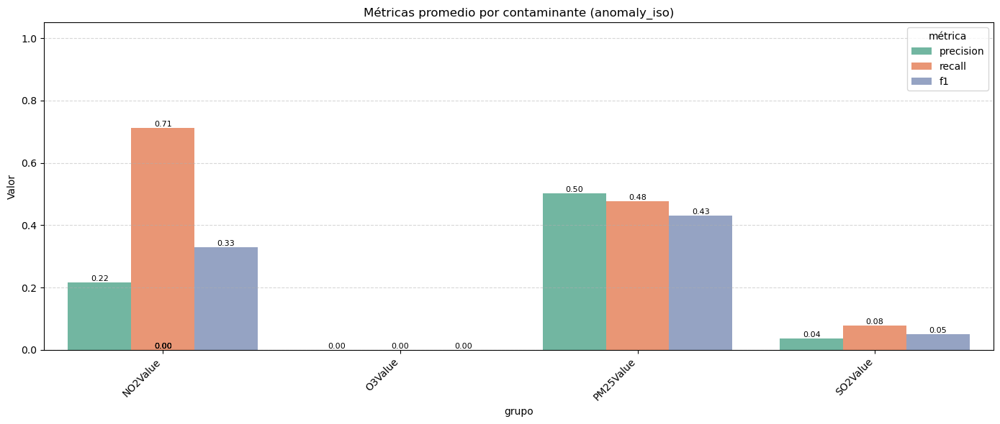

In [42]:
evaluar_y_visualizar_anomalias("modelos/isolation/anomalias_IsolationForest.xlsx", col_modelo='anomaly_iso')

NO₂Value
- Detecta la mayoría de las anomalías manuales (recall alto)
- Muchos falsos positivos (precision muy baja)
- Suele “ver” todos los picos de NO₂, pero sin discriminar bien qué picos son realmente anómalos según el comité.

O₃Value
- No había anotaciones manuales en TEST, por lo que no hay nada que detectar ni evaluar.

PM₂.₅Value
- Rendimiento balanceado: ni sobre-detecta ni ignora demasiados casos.
- F₁ de 0.43 indica margen de mejora, pero es el contaminante con mejor desempeño.

SO₂Value
- Débil detección de anomalías: la serie es más “plana” y el modelo apenas marca outliers.

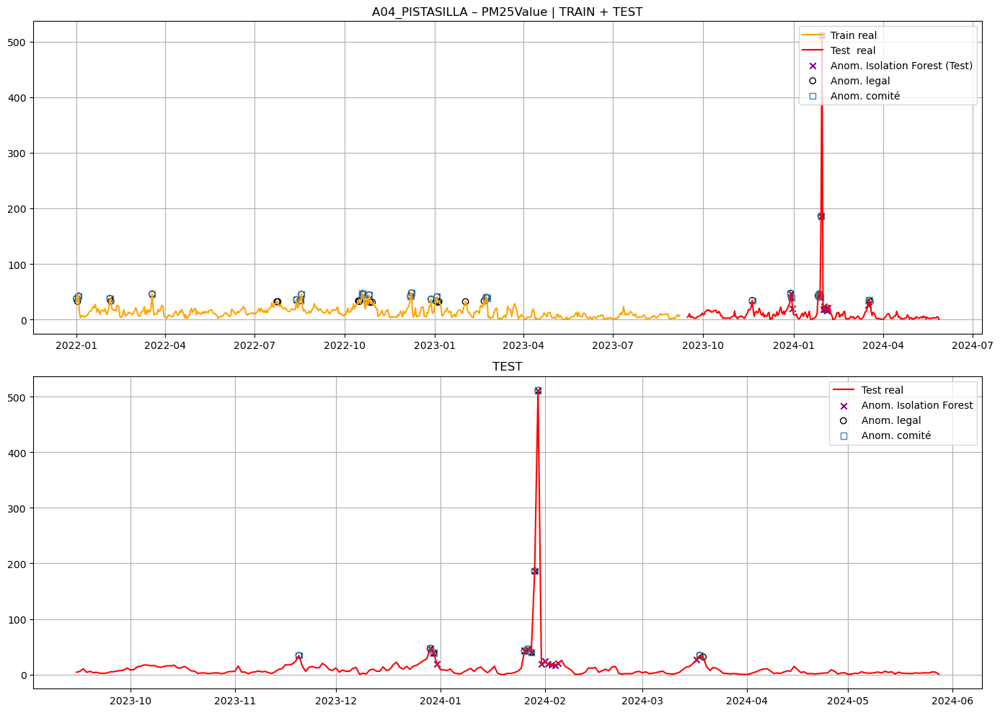

In [43]:
visualizar_anomalias(
    ruta_excel="modelos/isolation/anomalias_IsolationForest.xlsx",
    estacion="A04_PISTASILLA",
    contaminante="PM25Value",
    col_anom_modelo='anomaly_iso',
    modelo_label='Isolation Forest')

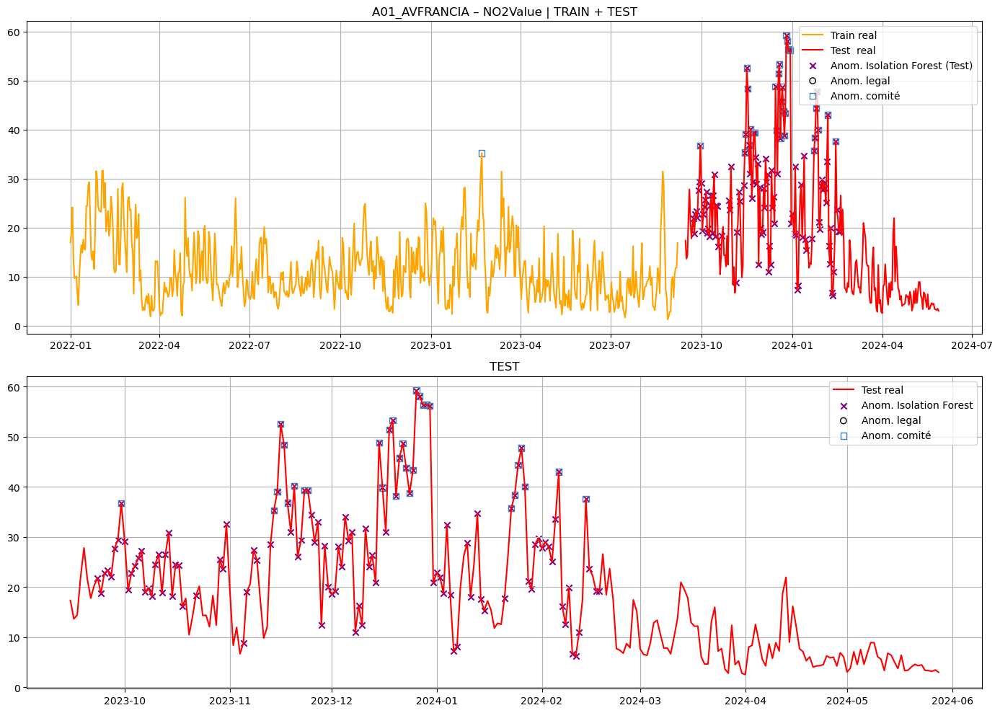

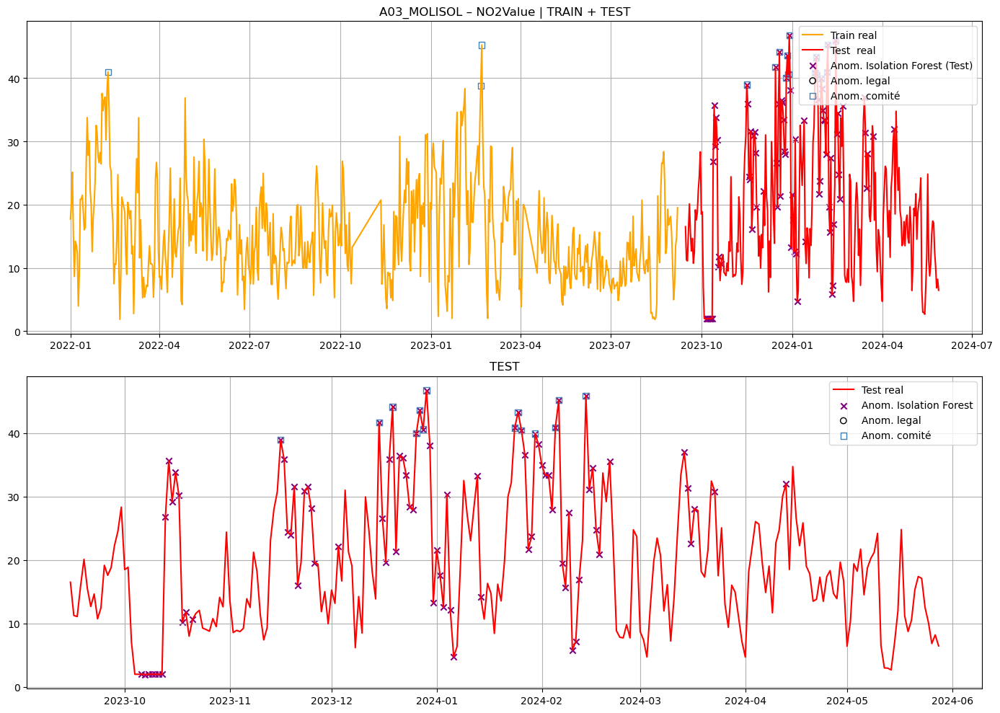

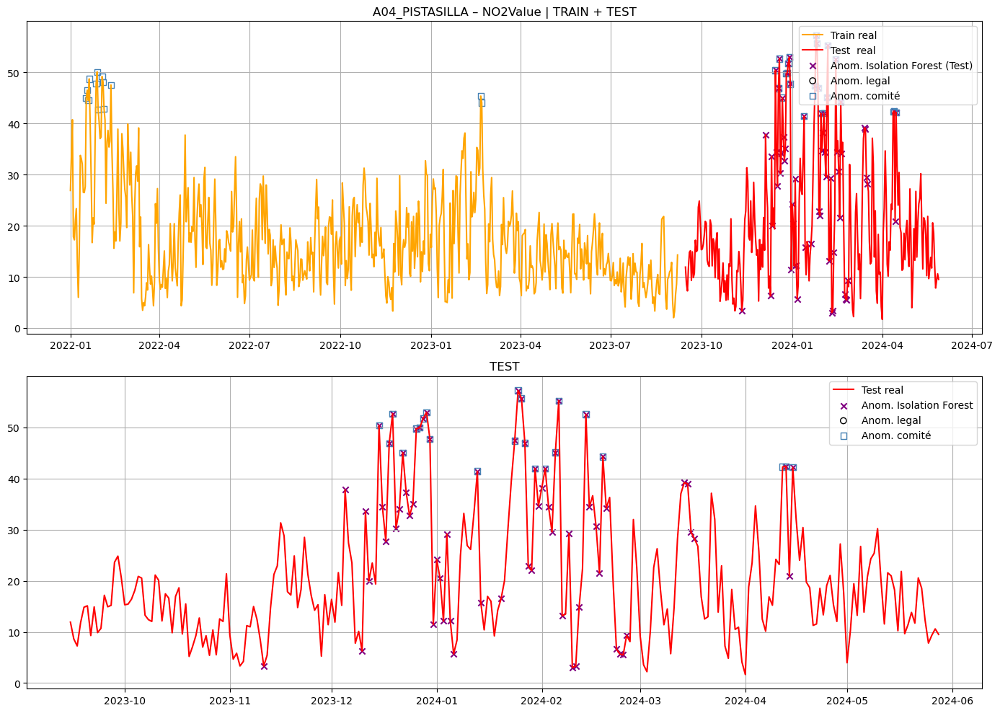

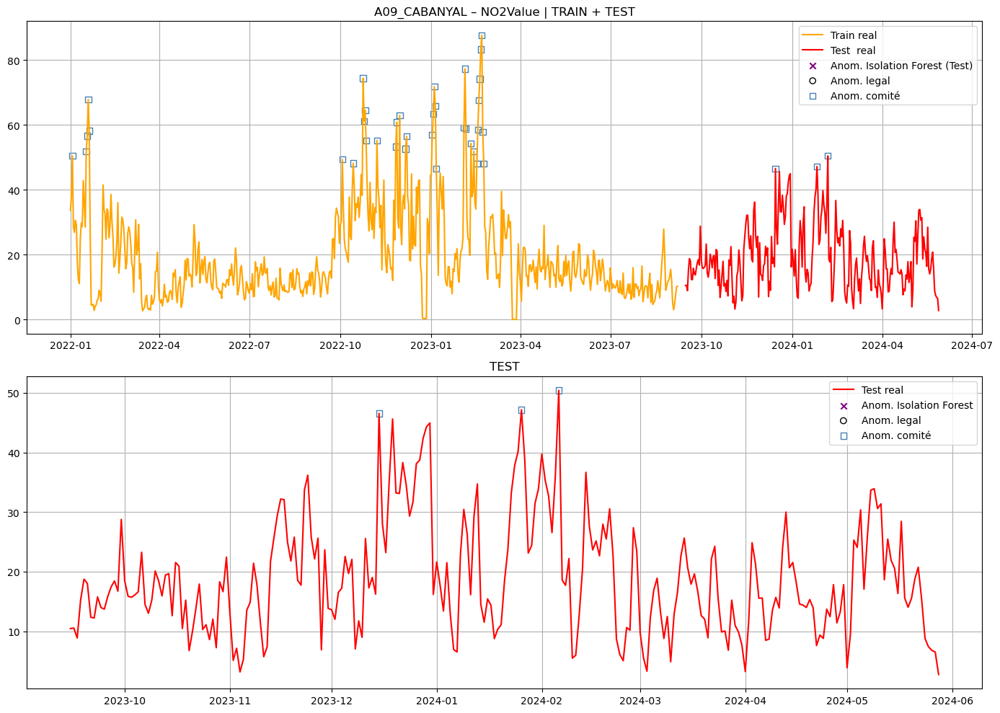

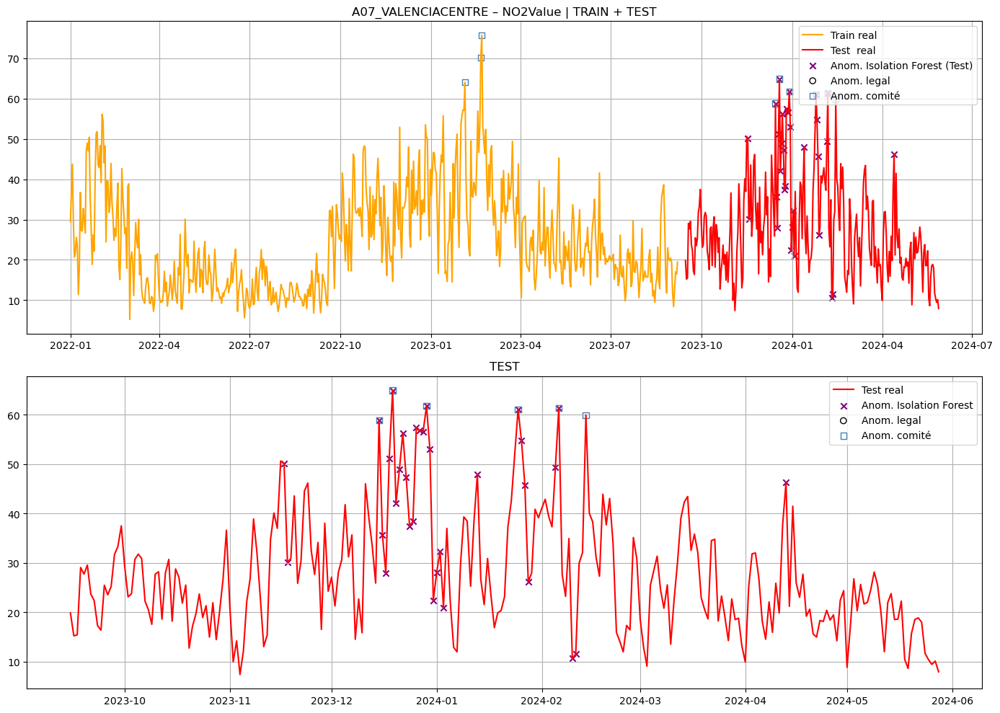

...

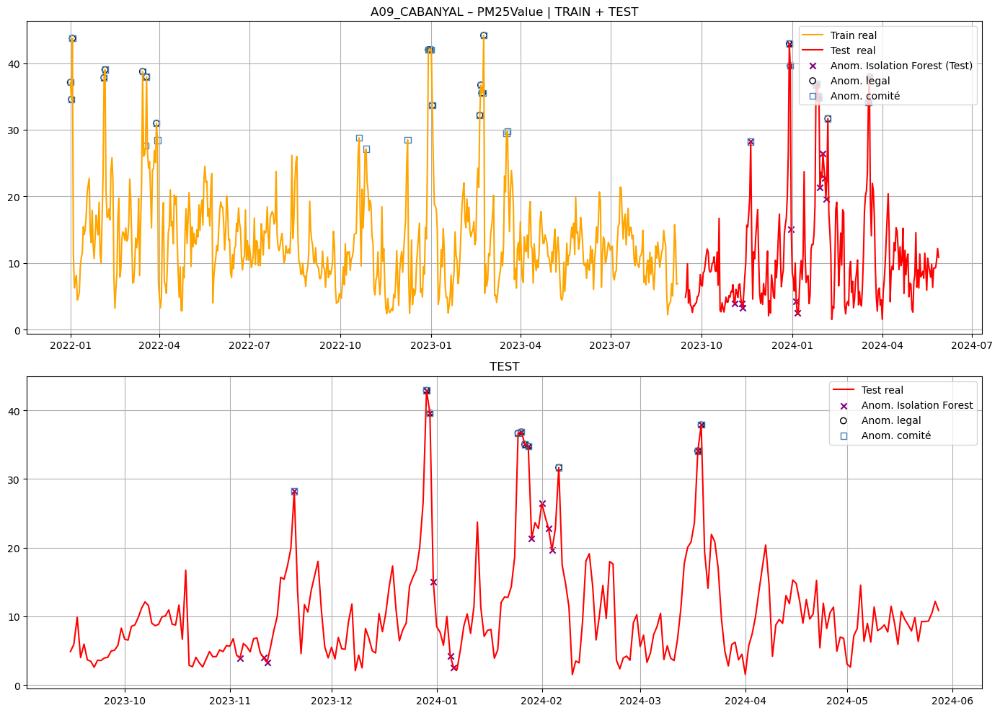

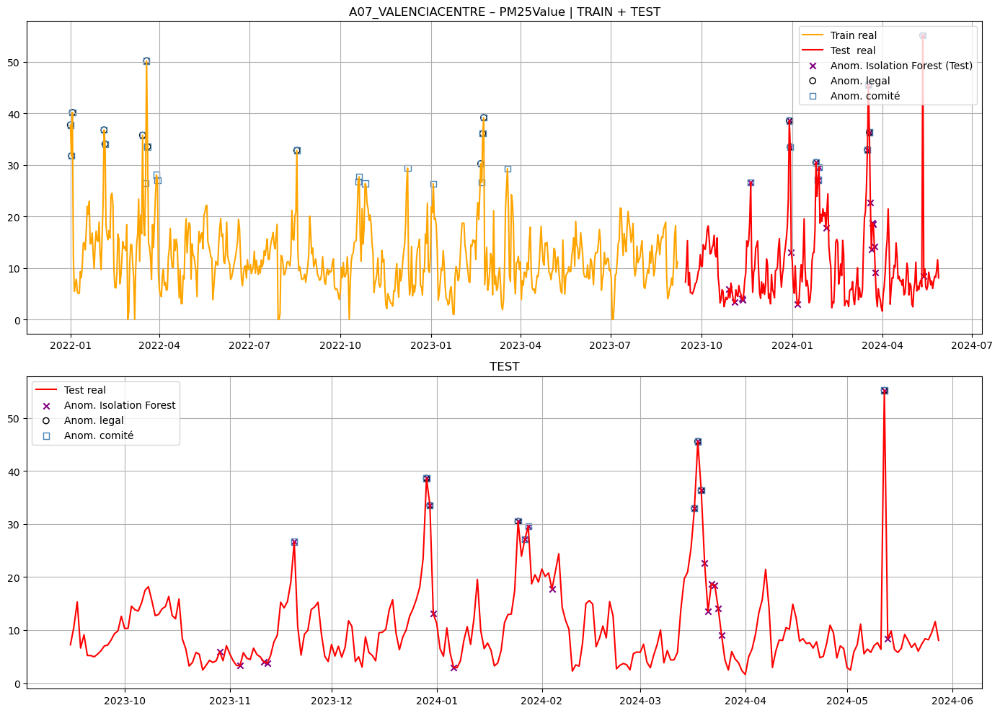

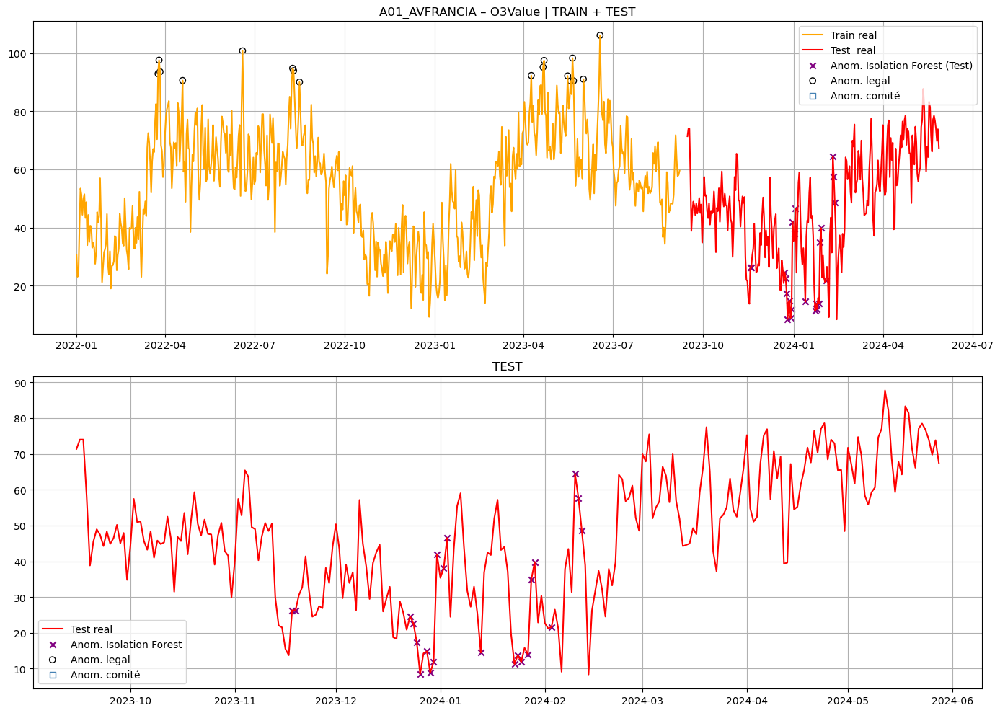

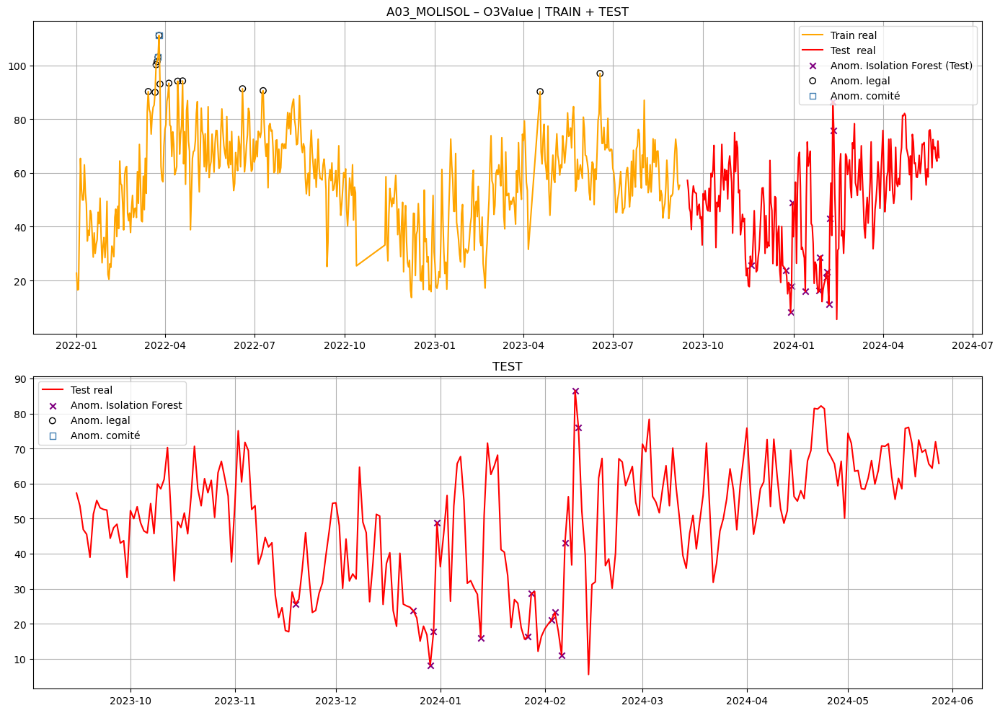

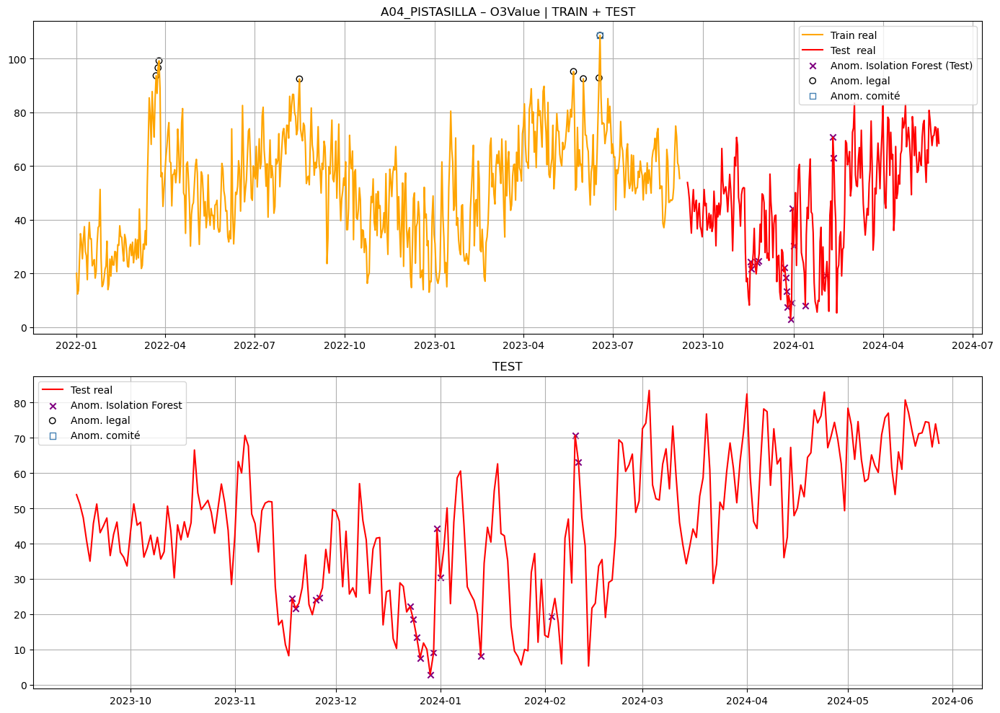

Error en A09_CABANYAL - O3Value: Worksheet named 'A09_CABANYAL_O3_train' not found
Error en A07_VALENCIACENTRE - O3Value: Worksheet named 'A07_VALENCIACENTRE_O3_train' not found


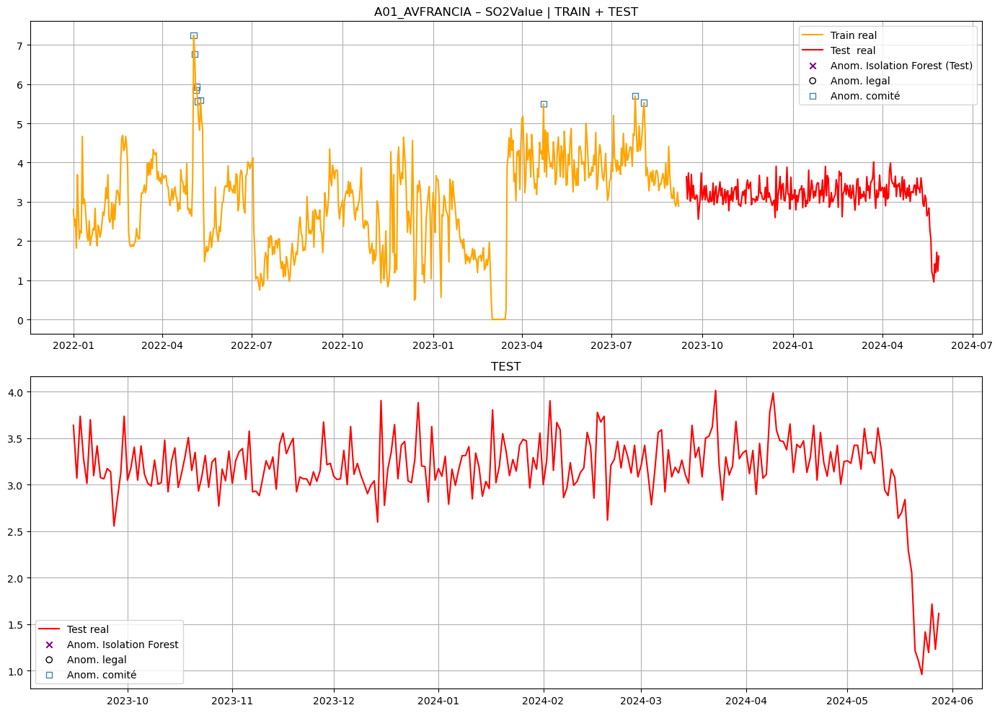

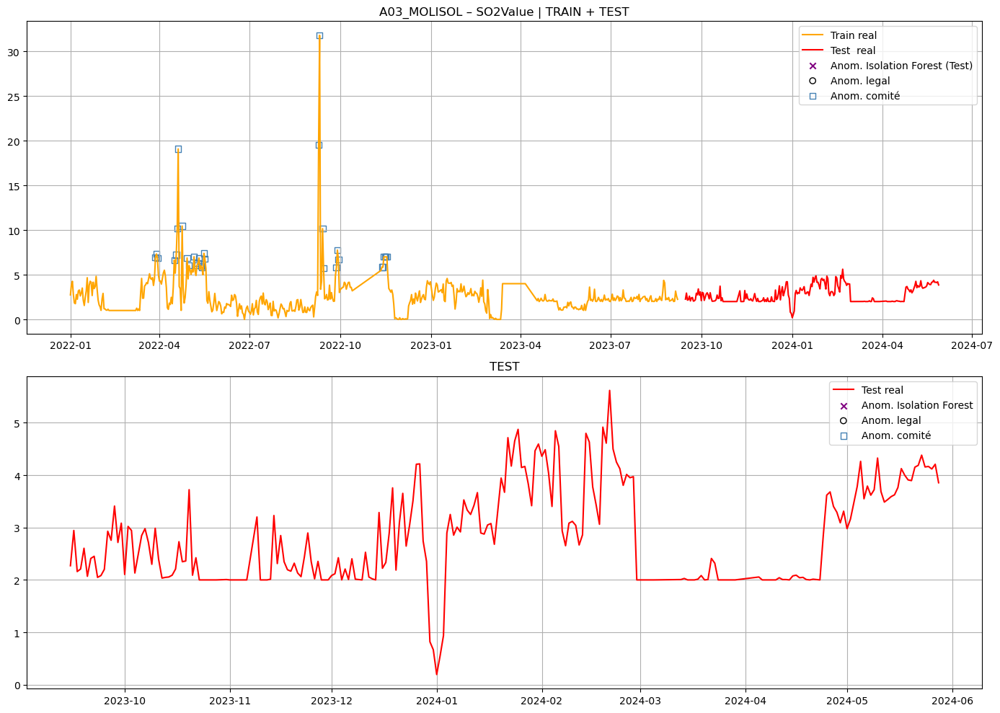

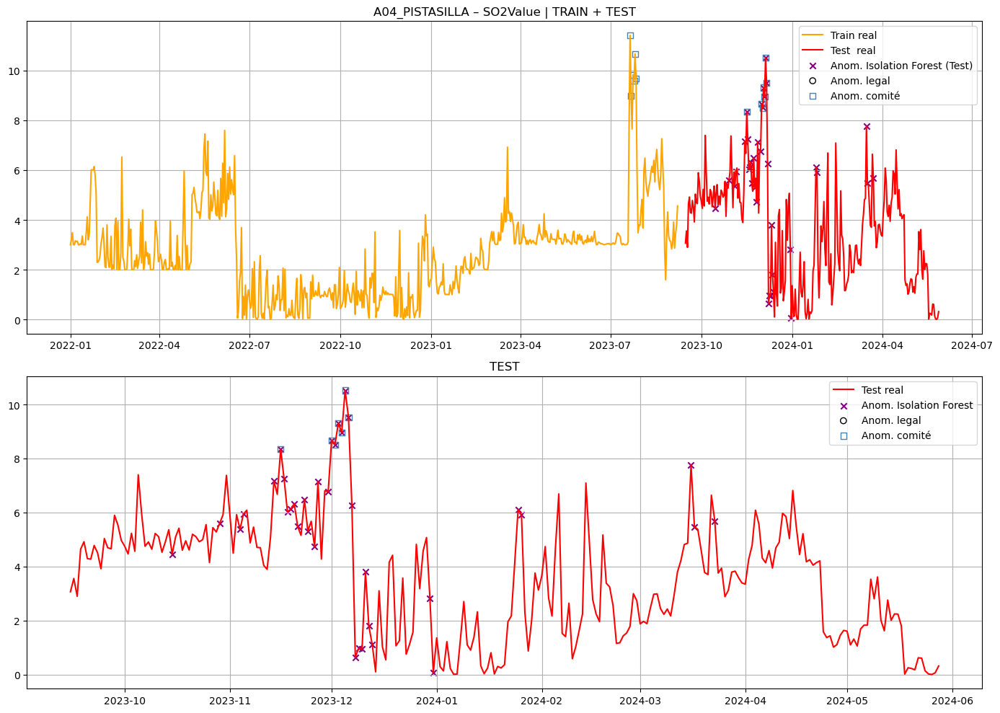

Error en A09_CABANYAL - SO2Value: Worksheet named 'A09_CABANYAL_SO2_train' not found
Error en A07_VALENCIACENTRE - SO2Value: Worksheet named 'A07_VALENCIACENTRE_SO2_train' not found


In [44]:
for contaminante in contaminantes:
    for estacion in estaciones_sel:
        estacion = estacion.replace("_10m", "")
        try:
            visualizar_anomalias(
                ruta_excel="modelos/isolation/anomalias_IsolationForest.xlsx",
                estacion=estacion,
                contaminante=contaminante,
                col_anom_modelo='anomaly_iso',
                modelo_label='Isolation Forest'
            )
        except Exception as e:
            print(f"Error en {estacion} - {contaminante}: {e}")

PARA LAS ANOMALÍAS DEL COMITÉ

 A01_AVFRANCIA – NO2Value


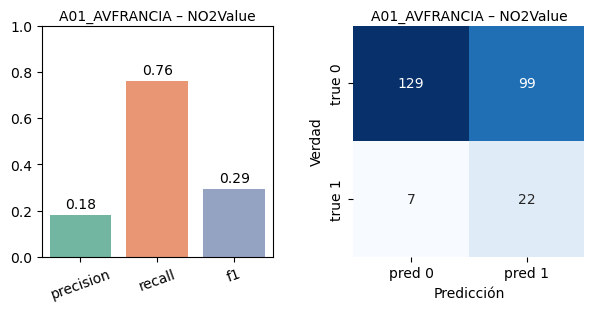


 A01_AVFRANCIA – O3Value


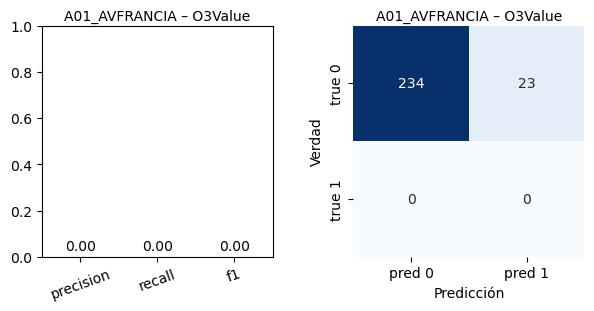


 A01_AVFRANCIA – PM25Value


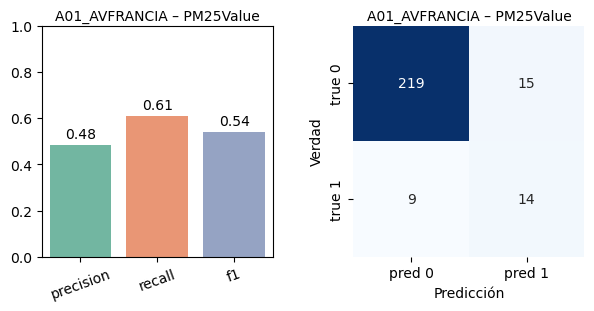


 A01_AVFRANCIA – SO2Value


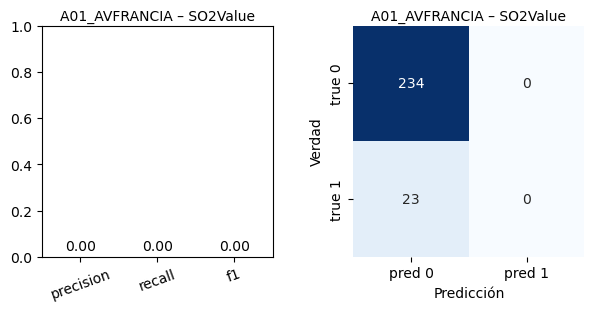


 A03_MOLISOL – NO2Value


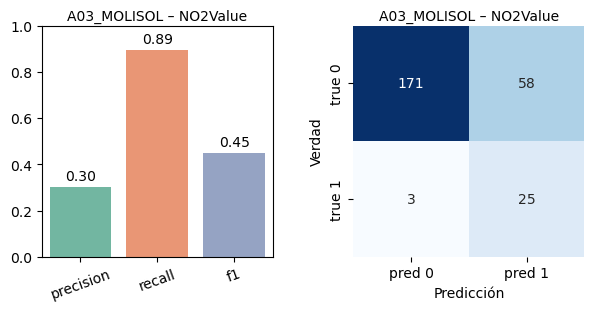


 A03_MOLISOL – O3Value


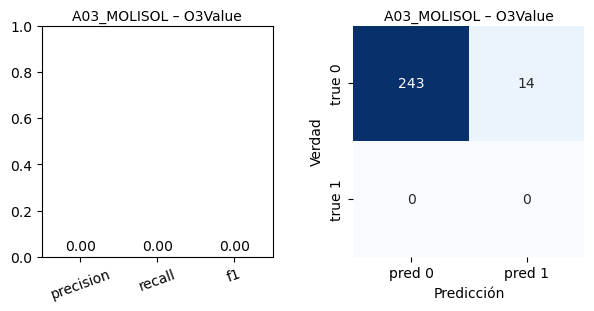


 A03_MOLISOL – PM25Value


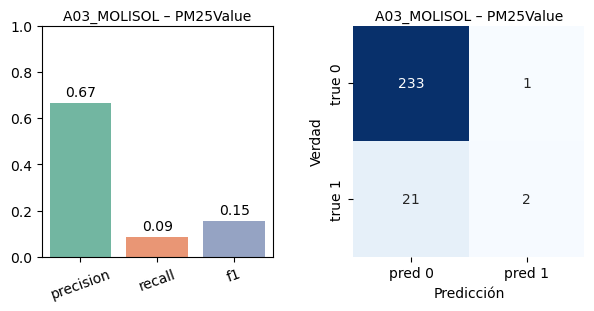


 A03_MOLISOL – SO2Value


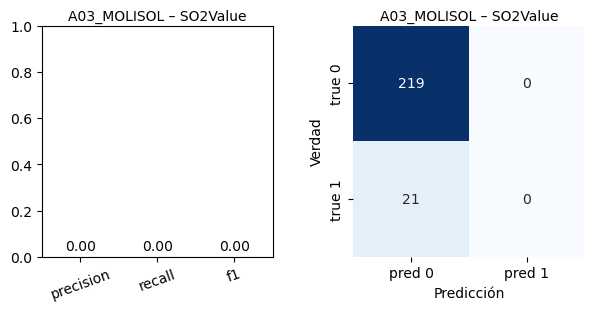


 A04_PISTASILLA – NO2Value


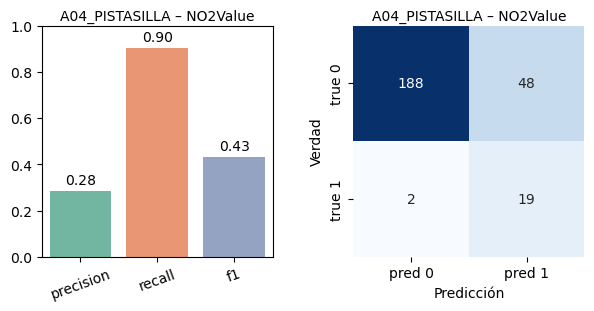


 A04_PISTASILLA – O3Value


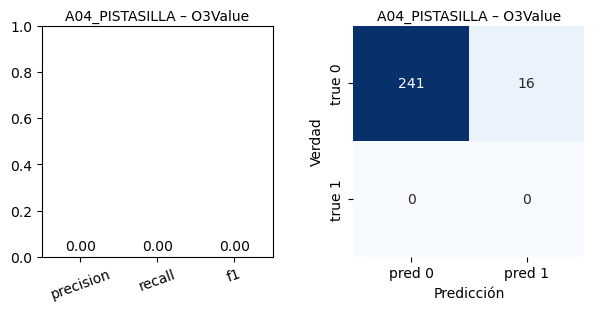


 A04_PISTASILLA – PM25Value


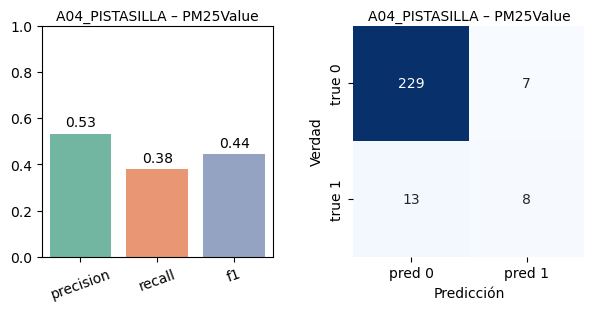


 A04_PISTASILLA – SO2Value


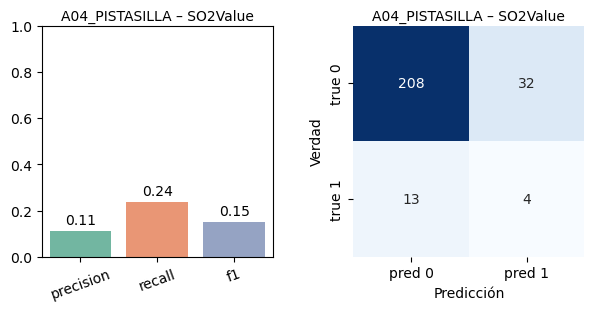


 A09_CABANYAL – NO2Value


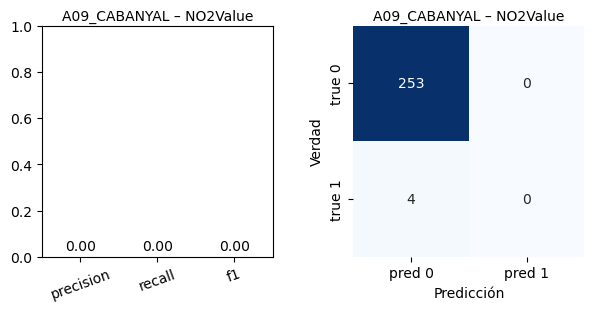


 A09_CABANYAL – PM25Value


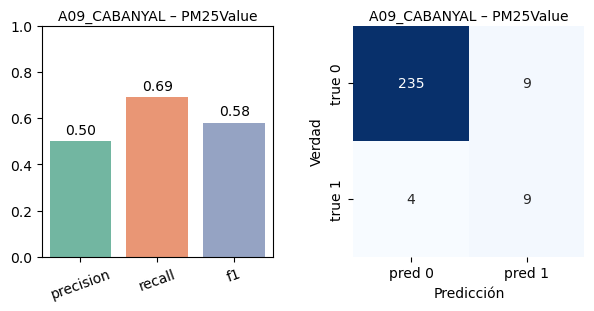


 A07_VALENCIACENTRE – NO2Value


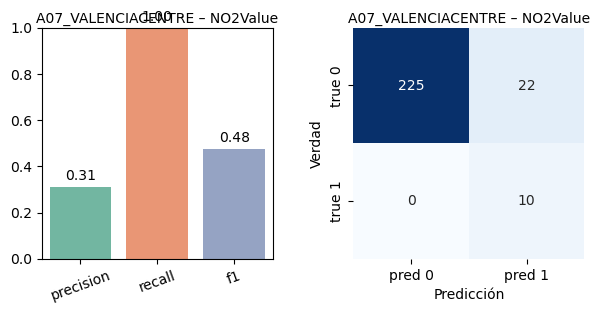


 A07_VALENCIACENTRE – PM25Value


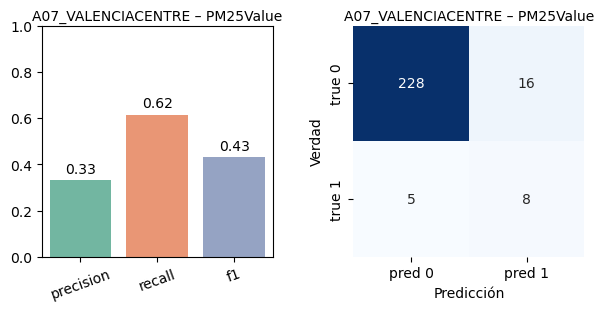

PARA LAS ANOMALÍAS LEGALES

 A01_AVFRANCIA – NO2Value


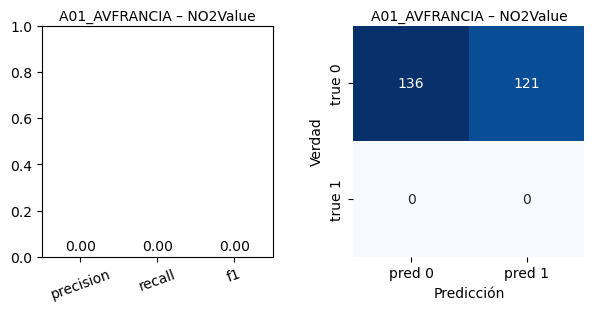


 A01_AVFRANCIA – O3Value


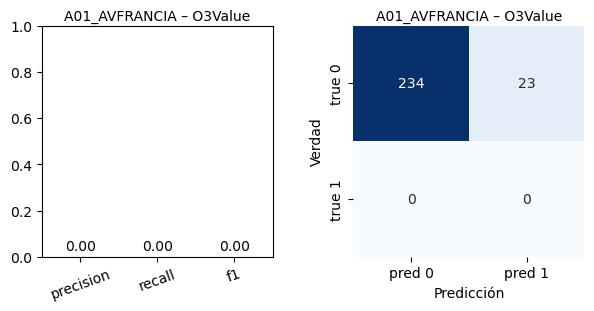


 A01_AVFRANCIA – PM25Value


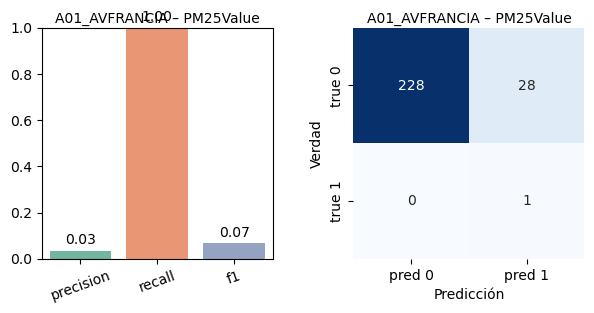


 A01_AVFRANCIA – SO2Value


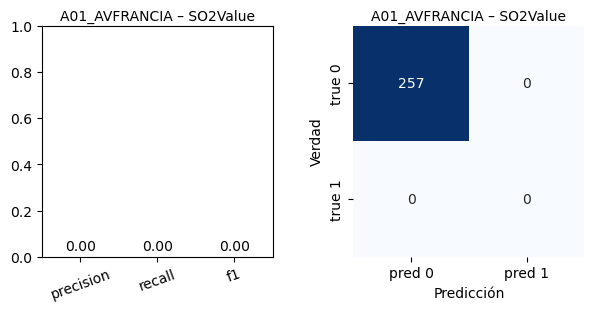


 A03_MOLISOL – NO2Value


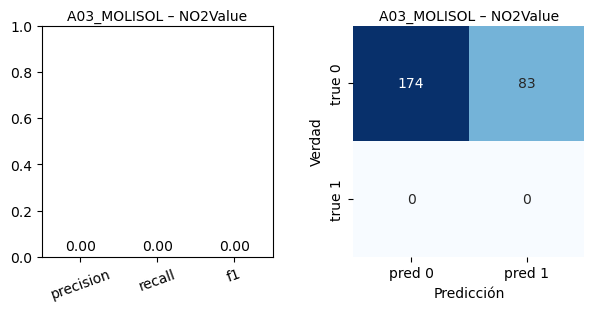


 A03_MOLISOL – O3Value


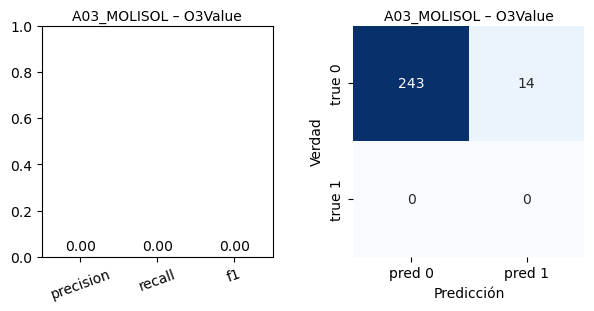


 A03_MOLISOL – PM25Value


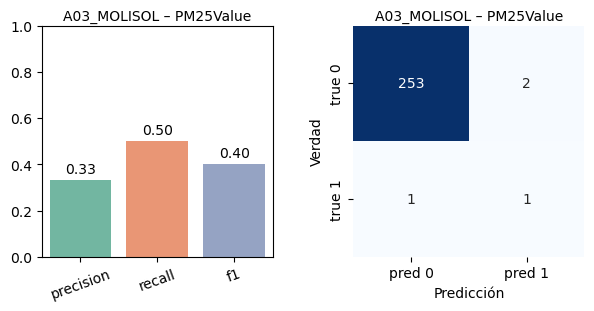


 A03_MOLISOL – SO2Value


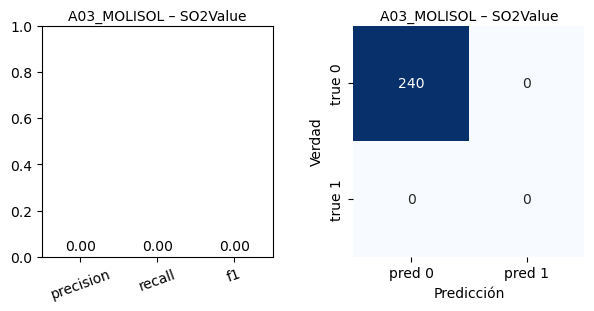


 A04_PISTASILLA – NO2Value


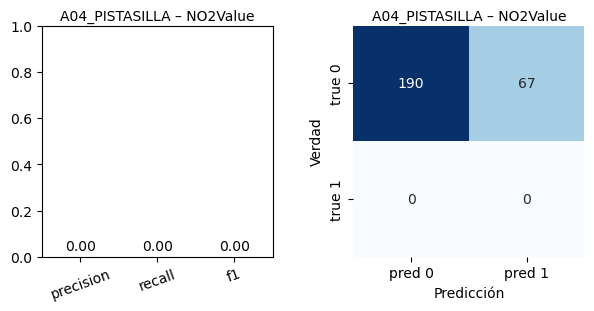


 A04_PISTASILLA – O3Value


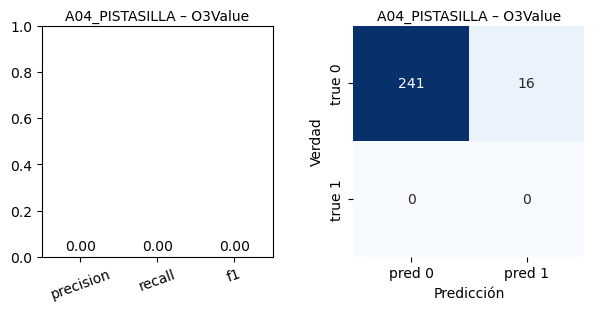


 A04_PISTASILLA – PM25Value


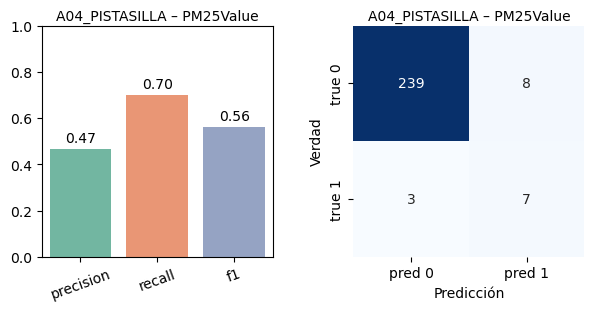


 A04_PISTASILLA – SO2Value


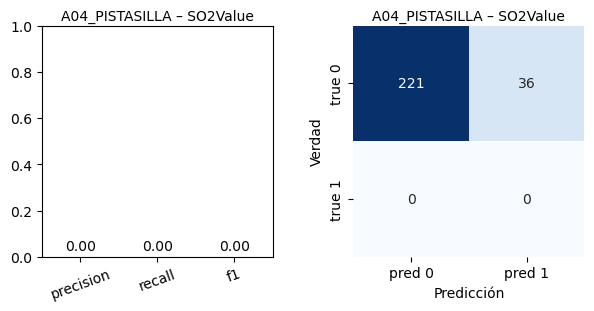


 A09_CABANYAL – NO2Value


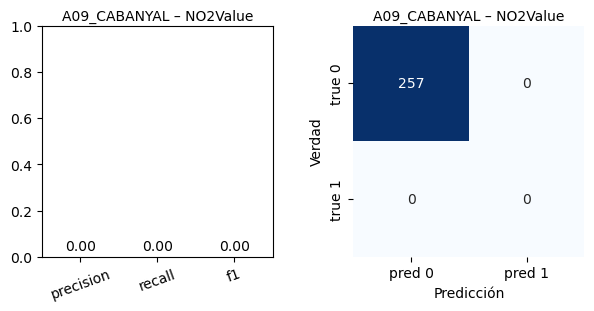


 A09_CABANYAL – PM25Value


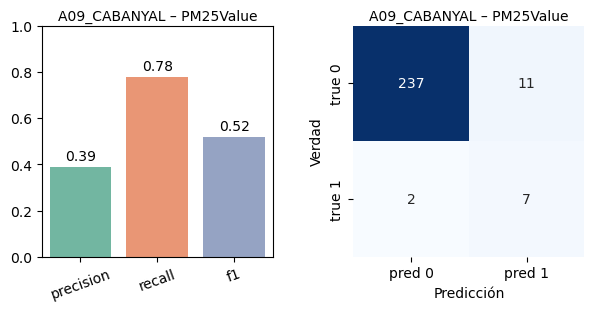


 A07_VALENCIACENTRE – NO2Value


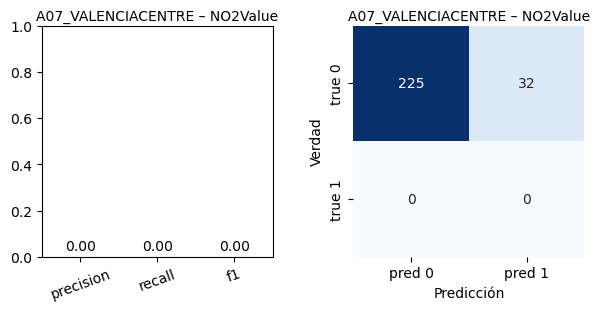


 A07_VALENCIACENTRE – PM25Value


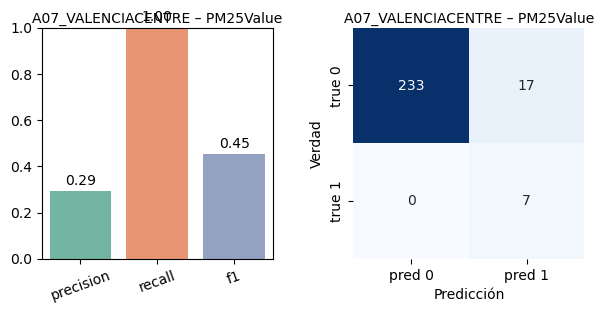

In [45]:
# --- bucle para todas las hojas train+test ---
ruta = "modelos/isolation/anomalias_IsolationForest.xlsx"
xlsx  = pd.ExcelFile(ruta)

print("PARA LAS ANOMALÍAS DEL COMITÉ")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_comite"
    col_modelo  = "anomaly_iso" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

print("PARA LAS ANOMALÍAS LEGALES")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_legal"
    col_modelo  = "anomaly_iso" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

#### Tuning

Para ajustar los parámetros se ha construido un tuning exhaustivo con la función 'tune_isolation_forest'. 

Se ha construido una grilla de 10 valores de contamination × 3 valores de n_estimators × 3 de max_samples × 2 de max_features, es decir, 180 combinaciones.

Para cada combinación se entrena en train, se evalúa en test y se calcula precision, recall y f1 frente a tu etiqueta de comité (*_anom_comite).

El resultado es un DataFrame (df_all_tune) con una fila por cada “serie (estación+contaminante) + combinación de hiperparámetros

In [46]:
def tune_isolation_forest( df, cont_col, preparar_features, dividir_st, param_grid=None):
    """
    Grid search sobre IsolationForest hiperparámetros:
      - contamination
      - n_estimators
      - max_samples
      - max_features

    Devuelve DataFrame con métricas para cada combinación.
    """
    # 1) define la grilla por defecto si no das una
    if param_grid is None:
        param_grid = {
            'contamination': np.linspace(0.005, 0.05, 10),
            'n_estimators':  [50, 100, 200],
            'max_samples':   [0.5, 0.75, 1.0],
            'max_features':  [0.5, 1.0]
        }
    grid = list(ParameterGrid(param_grid))

    # 2) prepara train/test y features
    df_train, df_test = dividir_st(df)
    X_train = preparar_features(df_train)
    X_test  = preparar_features(df_test)

    # 3) etiqueta real alineada
    y_true = df_test[cont_col].fillna(False).astype(bool)
    y_true = y_true.loc[X_test.index].astype(int)

    resultados = []
    # 4) iterar combinaciones
    for params in grid:
        iso = IsolationForest(
            contamination=params['contamination'],
            n_estimators=params['n_estimators'],
            max_samples=params['max_samples'],
            max_features=params['max_features'],
            random_state=42
        )
        iso.fit(X_train)
        y_pred = (iso.predict(X_test) == -1).astype(int)

        resultados.append({
            **params,
            'precision': precision_score(y_true, y_pred, zero_division=0),
            'recall':    recall_score   (y_true, y_pred, zero_division=0),
            'f1':        f1_score       (y_true, y_pred, zero_division=0)
        })

    return pd.DataFrame(resultados)

##### Anomalías del comité como Y. 

In [47]:
resultados = []

for (estacion, contaminante), df in st_anomalias.items():
    cont_col = f'{contaminante}_anom_comite'
    if cont_col not in df.columns:
        continue

    # Ejecuta el tuning
    df_tune = tune_isolation_forest(
        df, cont_col,
        preparar_features=preparar_features,
        dividir_st=dividir_st
    )

    # Añade columnas de contexto
    df_tune['estacion']     = estacion
    df_tune['contaminante'] = contaminante
    resultados.append(df_tune)

# Concatenar todo
df_all_tune = pd.concat(resultados, ignore_index=True)

Una vez hecho esto, para cada par (estación, contaminante), se ha elegido la combinación que maximiza F1. 

    Para algunos contaminantes (O₃, SO₂ en ciertas estaciones) todas las métricas fueron cero, por lo tanto no detecta ninguna anomalía real y el tuning escoge el primer valor de la grilla (contamination=0.005, n_estimators=50,…).

In [48]:
mejor_por_serie = (
    df_all_tune
    .sort_values(['estacion','contaminante','f1'], ascending=[True,True,False])
    .groupby(['estacion','contaminante'], as_index=False)
    .first()
    [['estacion','contaminante','contamination','n_estimators','max_samples','max_features','precision','recall','f1']]
)

Con esos mejores hiperparámetros se reentrena solo en train y se predice en test, guardando la bandera anomaly_iso_opt.

A partir de ahí, final_labels[(est,cont)] contiene solo el test con el nuevo flag.

In [49]:
final_labels = {}

for _, row in mejor_por_serie.iterrows():
    est  = row['estacion']
    cont = row['contaminante']
    params = {
        'contamination': row['contamination'],
        'n_estimators':  int(row['n_estimators']),
        'max_samples':   row['max_samples'],
        'max_features':  row['max_features']
    }
    df = st_anomalias[(est,cont)]
    df_train, df_test = dividir_st(df)
    X_train = preparar_features(df_train)
    X_test  = preparar_features(df_test)

    model = IsolationForest(**params, random_state=42)
    model.fit(X_train)

    df_test_res = df_test.loc[X_test.index].copy()
    df_test_res['anomaly_iso_opt'] = (model.predict(X_test)==-1)
    final_labels[(est,cont)] = df_test_res

In [50]:
# Directorio de salida
hojas_excel_opt = {}

# Recorremos las etiquetas finales optimizadas
for (est, cont), df_res in final_labels.items():
    # Nombre de hoja (igual lógica que antes)
    hoja_train = f"{est}_{cont}_train".replace("Value", "").replace("_10m", "")[:31]
    hoja_test  = f"{est}_{cont}_test".replace("Value", "").replace("_10m", "")[:31]
    
    # Recuperamos df_train original (sin etiquetas) y le añadimos la columna optimizada
    df_full = st_anomalias[(est, cont)]
    df_train, df_test = dividir_st(df_full)
    
    # Alineamos índices y añadimos la nueva bandera
    df_train_opt = df_train.loc[df_res.index.intersection(df_train.index)].copy()
    df_train_opt = df_train.copy()
    
    df_test_opt  = df_test.loc[df_res.index].copy()
    df_test_opt ['anomaly_iso_opt'] = df_res['anomaly_iso_opt']
    
    # Localize
    df_train_opt.index = df_train_opt.index.tz_localize(None)
    df_test_opt .index = df_test_opt .index.tz_localize(None)
    
    # Guardar en el dict de hojas
    hojas_excel_opt[hoja_train] = df_train_opt
    hojas_excel_opt[hoja_test]  = df_test_opt

# Escribir el Excel final
ruta_excel_opt = "modelos/isolation/anomalias_IsolationForest_optimoCOMITE.xlsx"
with pd.ExcelWriter(ruta_excel_opt, engine='xlsxwriter') as writer:
    for hoja, df_hoja in hojas_excel_opt.items():
        df_hoja.to_excel(writer, sheet_name=hoja)

Estación: A01_AVFRANCIA | Contaminante: NO2Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 21 de 29 anomalías manuales.
    Precisión de coincidencias: 0.30
Estación: A01_AVFRANCIA | Contaminante: O3Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 0 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A01_AVFRANCIA | Contaminante: PM25Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 16 de 23 anomalías manuales.
    Precisión de coincidencias: 0.64
Estación: A01_AVFRANCIA | Contaminante: SO2Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 0 de 23 anomalías manuales.
    El modelo no detectó ninguna anomalía.
Estación: A03_MOLISOL | Contaminante: NO2Valu

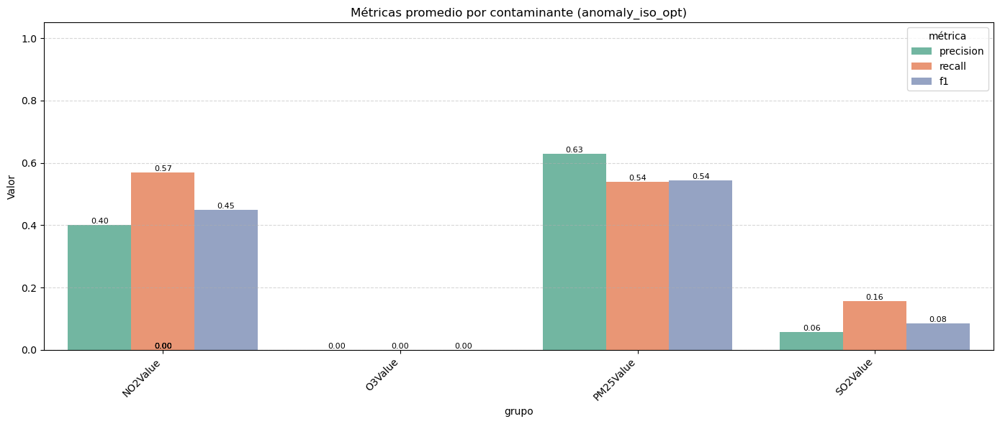

In [51]:
evaluar_y_visualizar_anomalias("modelos/isolation/anomalias_IsolationForest_optimoCOMITE.xlsx", col_modelo='anomaly_iso_opt')

PM₂.₅ (mejor comportamiento)
- Precision ≈ 0.63 y recall ≈ 0.54 → detecta bastante bien las anomalías reales con un nivel razonable de falsos positivos.
- F₁ ≈ 0.54: estamos en un punto de partida bueno, aunque aún hay margen de mejora.

NO₂ (rendimiento moderado)
- Precision ≈ 0.40 y recall ≈ 0.57 → detecta más de la mitad de las anomalías, pero incorpora bastantes falsos positivos.
- F₁ ≈ 0.45: el detector es útil, pero quizás convenga ajustar features o umbral para bajar falsos positivos.

O₃ (sin detección)
- Todos los valores cero indican que, o bien no hubo anomalías manuales para O₃ en las series consideradas, o el modelo no logró distinguir ningún pico frente al ruido.
- Para O₃ probablemente necesitemos enriquecer las características o usar otro método.

SO₂ (muy bajo desempeño)

- Precision ≈ 0.06 y recall ≈ 0.16, prácticamente no acierta y marca muchas veces donde no hay anomalía.
- SO₂ suele tener valores muy bajos y estables, Isolation Forest no encuentra patrones claros de “outlier” con las características actuales.

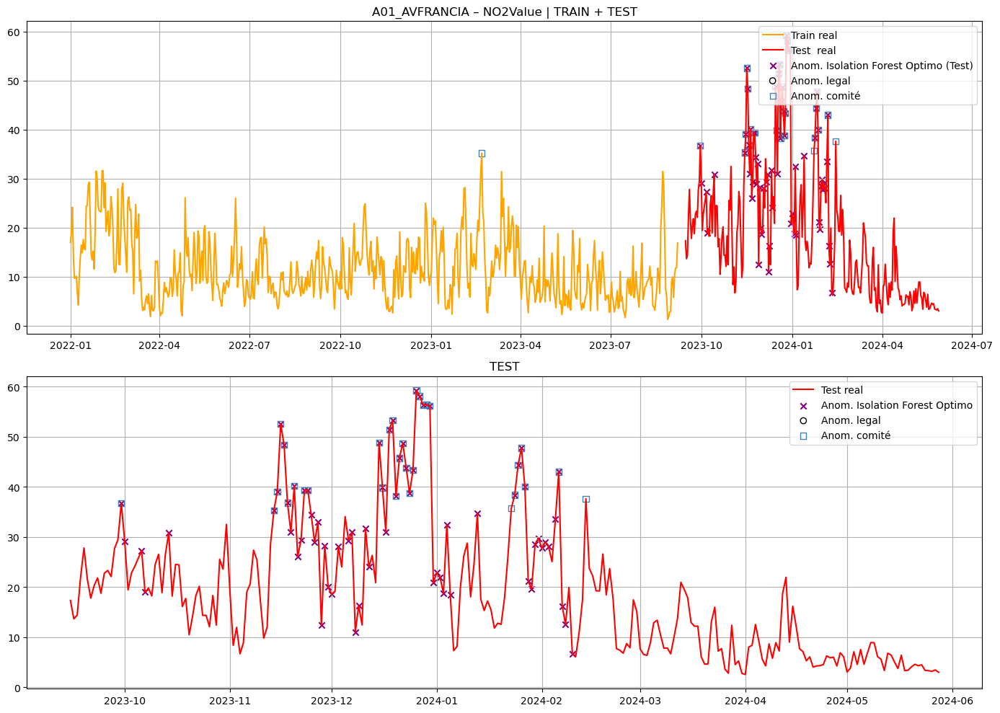

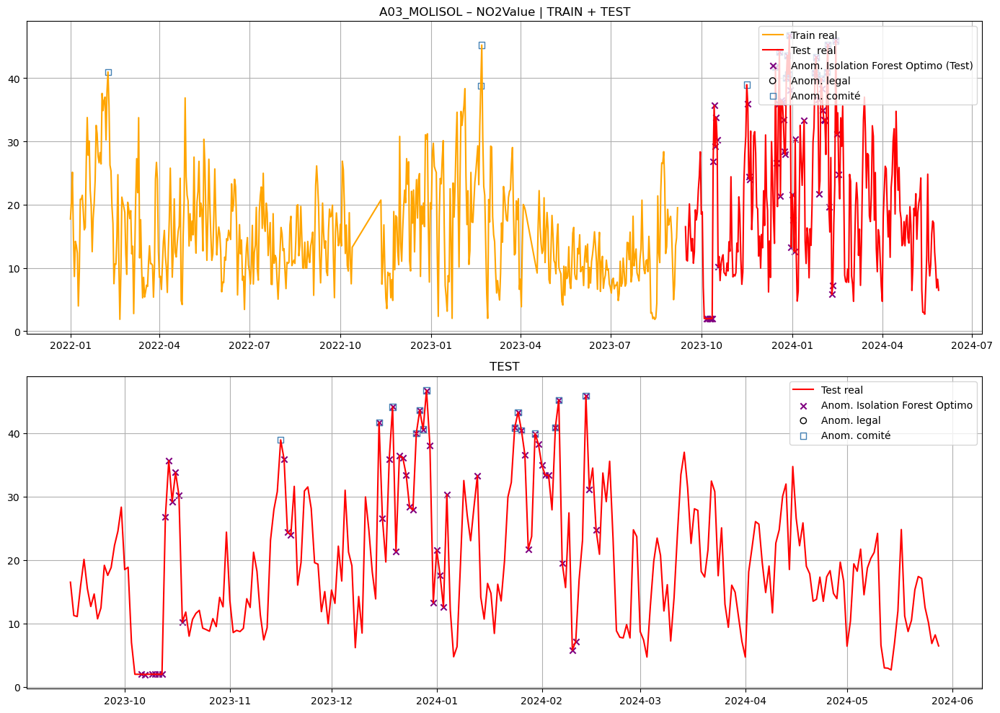

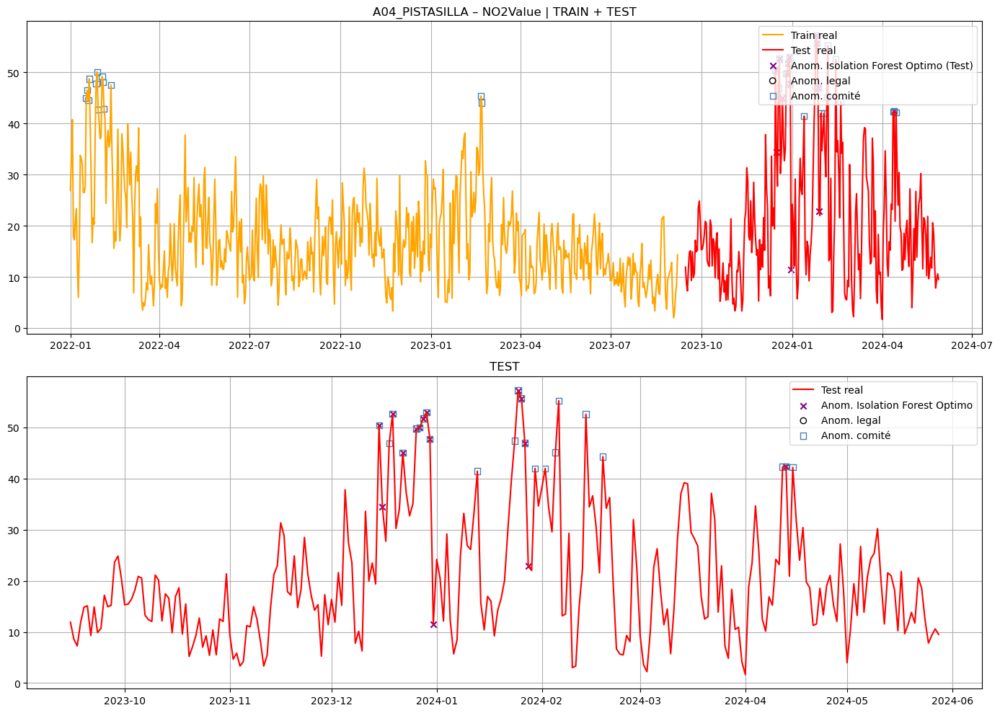

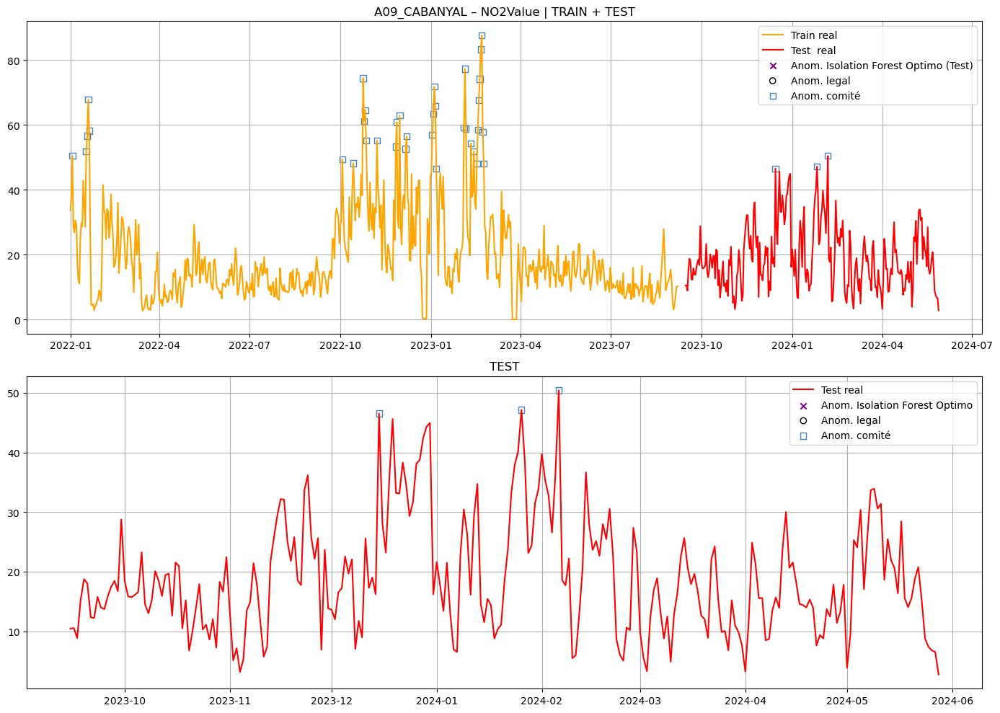

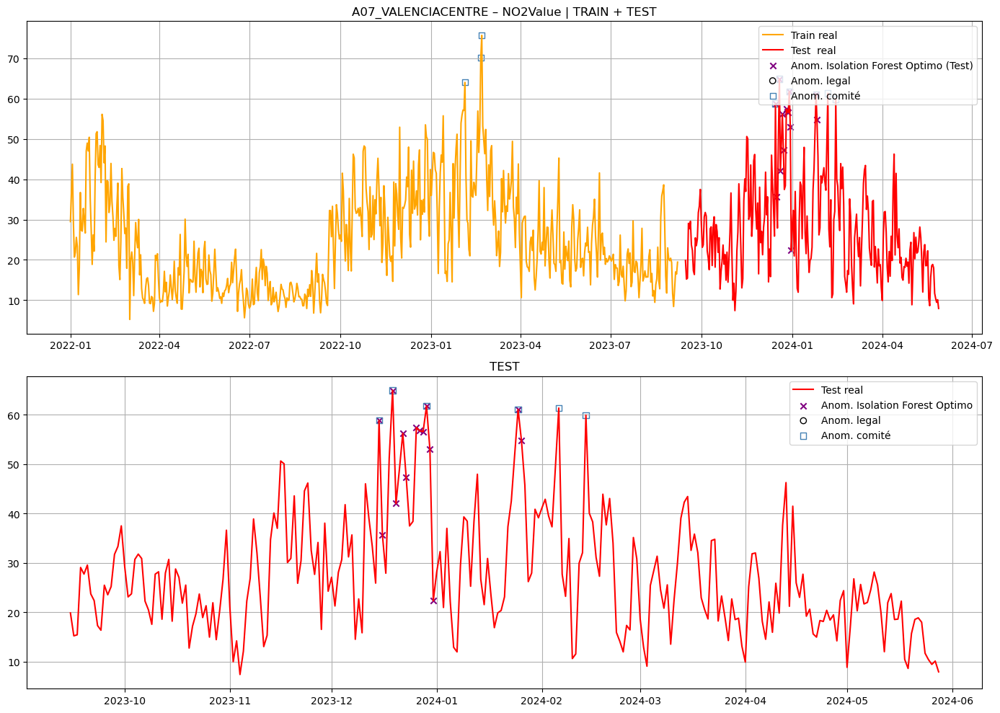

...

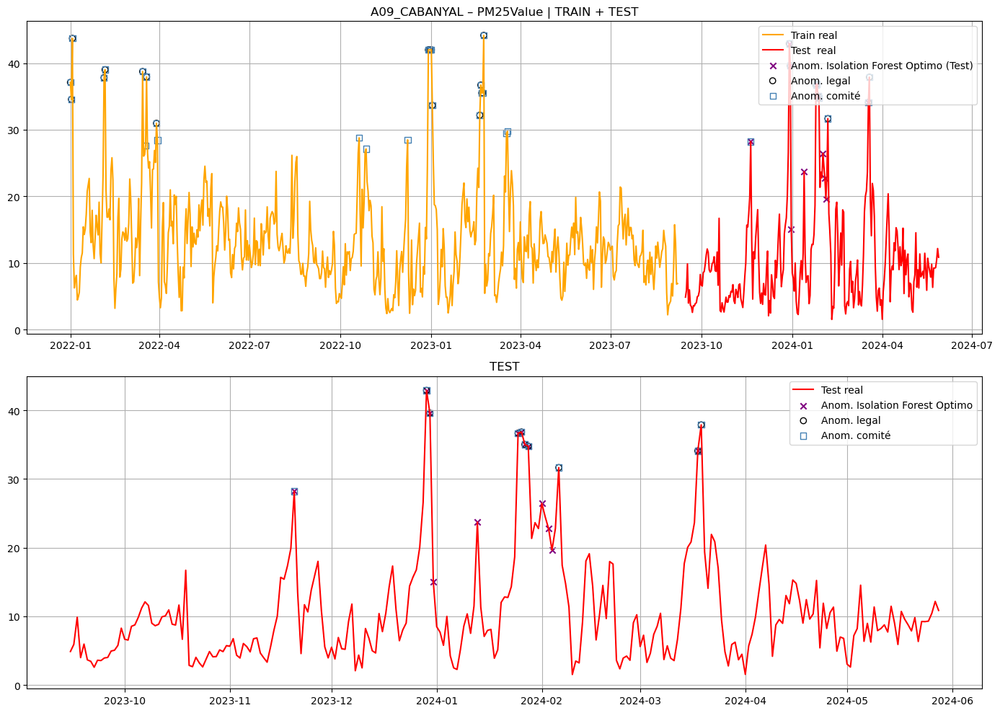

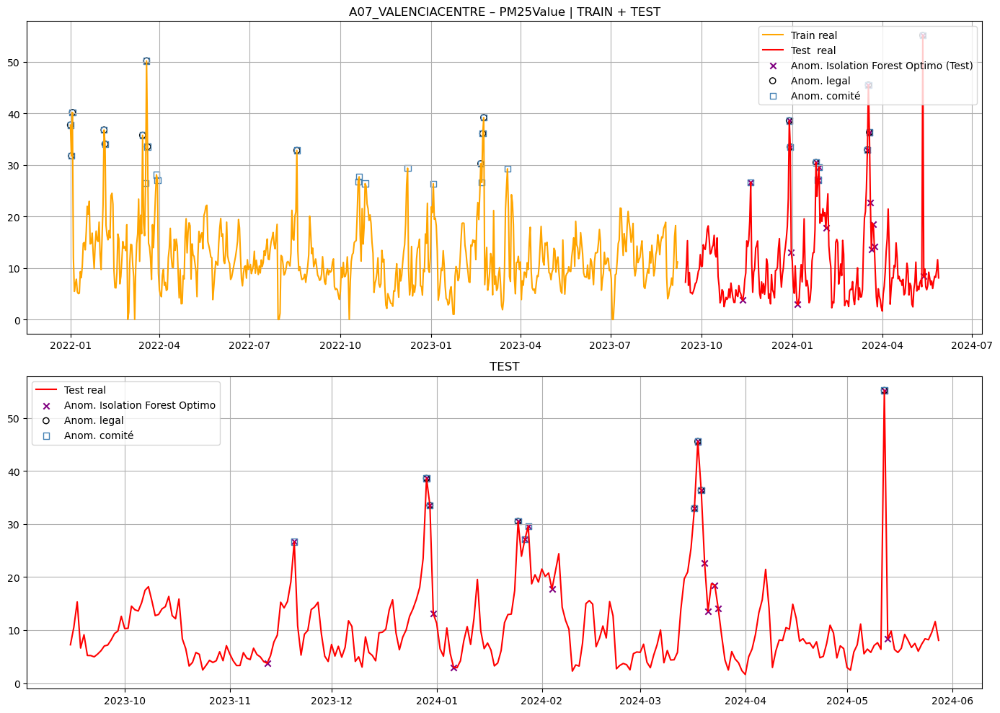

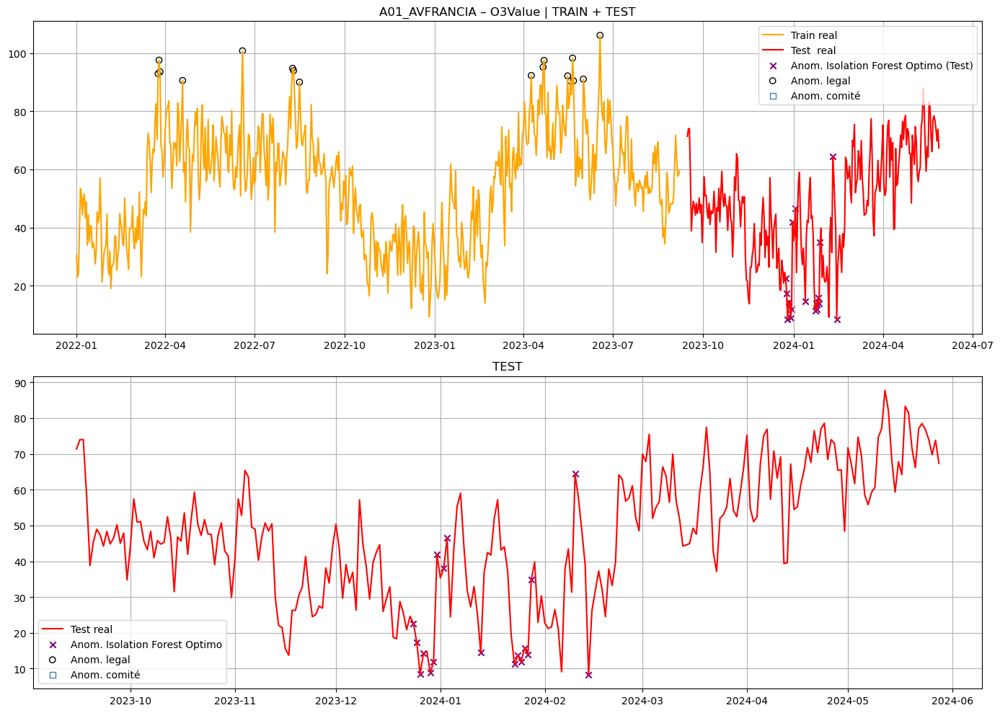

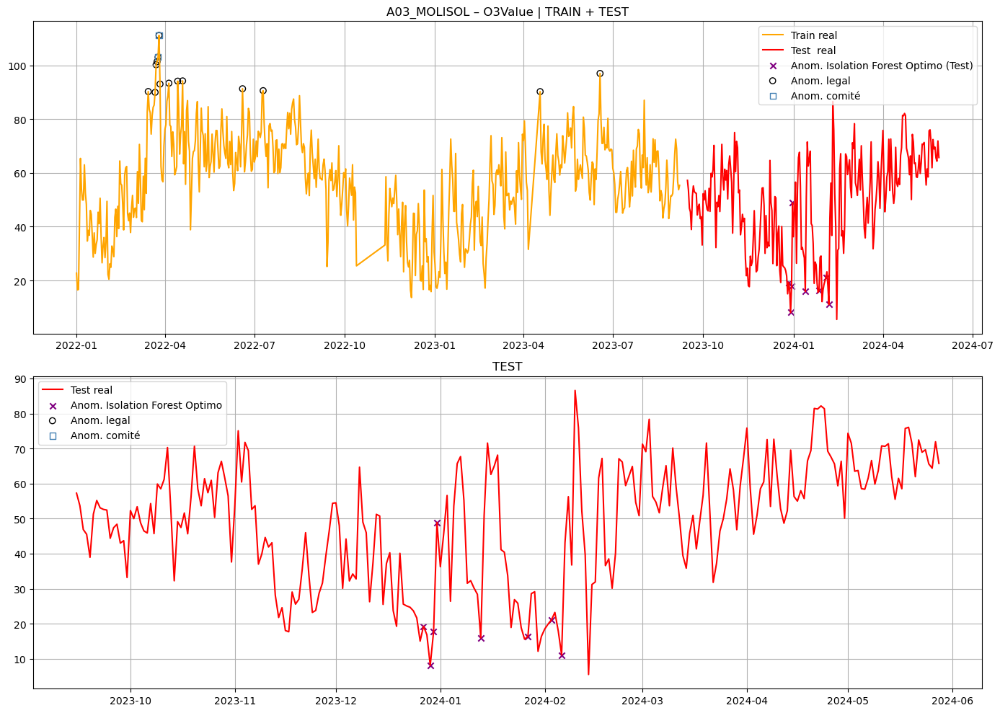

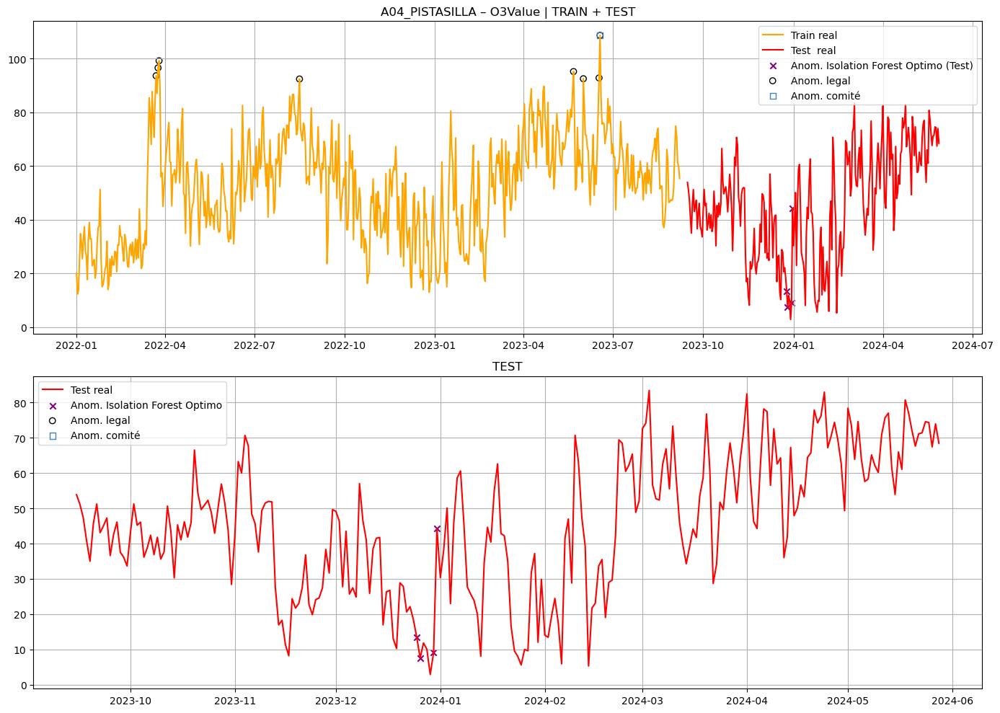

Error en A09_CABANYAL - O3Value: Worksheet named 'A09_CABANYAL_O3_train' not found
Error en A07_VALENCIACENTRE - O3Value: Worksheet named 'A07_VALENCIACENTRE_O3_train' not found


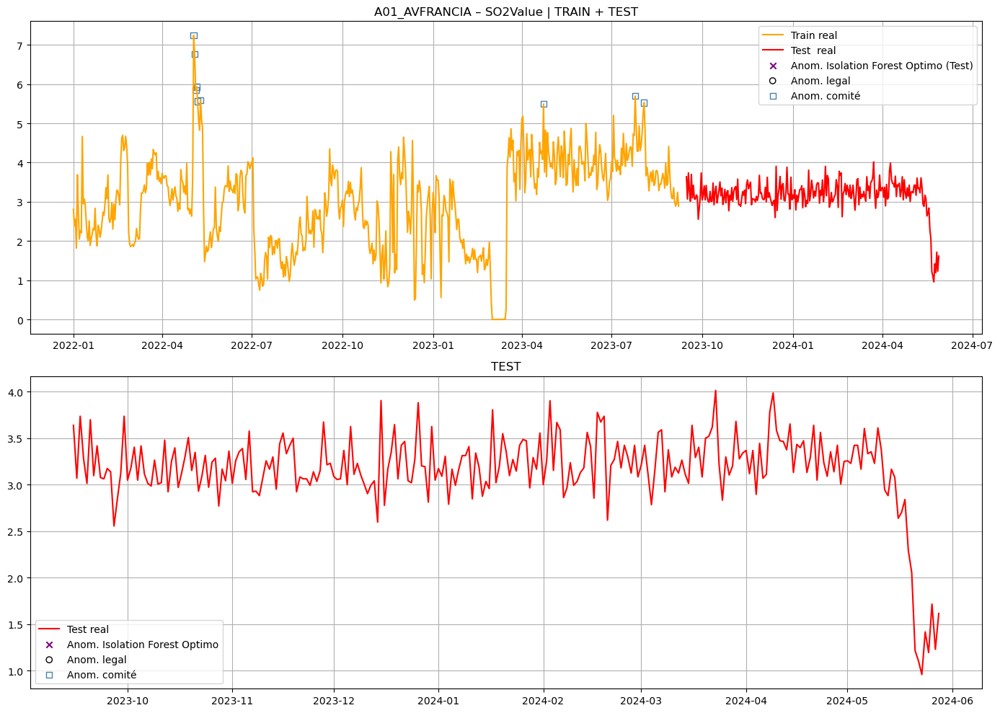

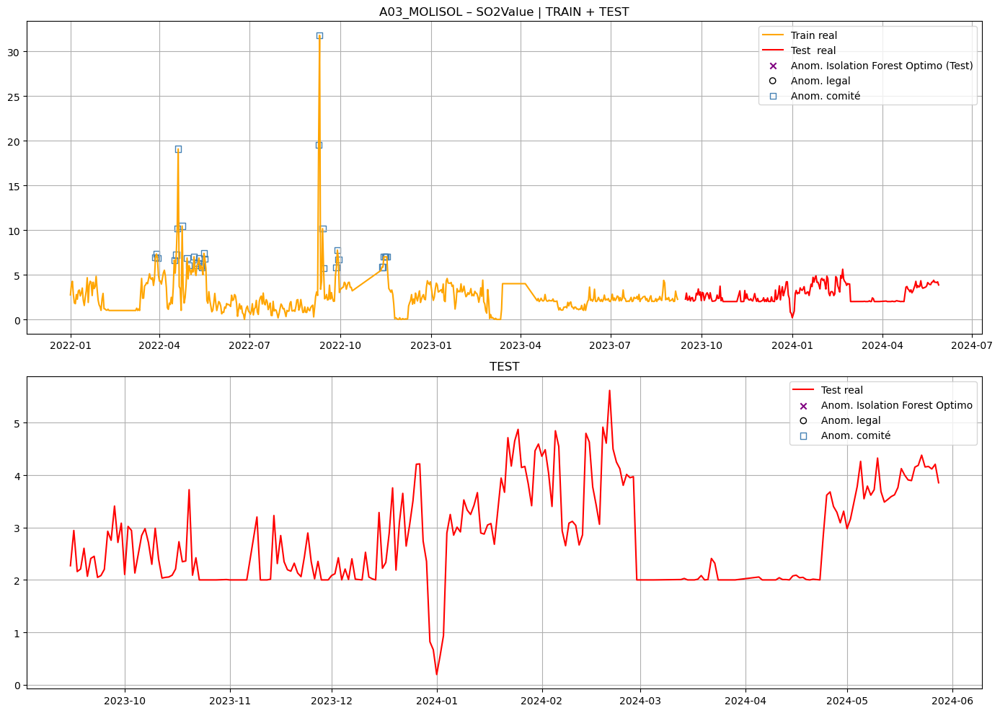

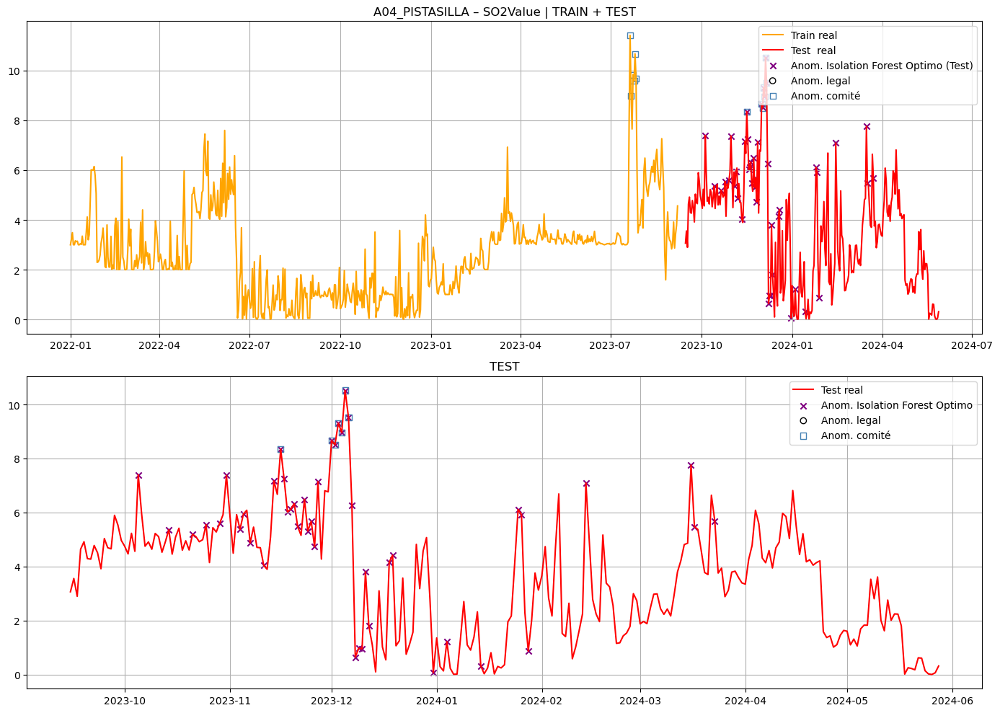

Error en A09_CABANYAL - SO2Value: Worksheet named 'A09_CABANYAL_SO2_train' not found
Error en A07_VALENCIACENTRE - SO2Value: Worksheet named 'A07_VALENCIACENTRE_SO2_train' not found


In [53]:
for contaminante in contaminantes:
    for estacion in estaciones_sel:
        estacion = estacion.replace("_10m", "")
        try:
            visualizar_anomalias(
                ruta_excel="modelos/isolation/anomalias_IsolationForest_optimo.xlsx",
                estacion=estacion,
                contaminante=contaminante,
                col_anom_modelo='anomaly_iso_opt',
                modelo_label='Isolation Forest Optimo'
            )
        except Exception as e:
            print(f"Error en {estacion} - {contaminante}: {e}")

PARA LAS ANOMALÍAS DEL COMITÉ

 A01_AVFRANCIA – NO2Value


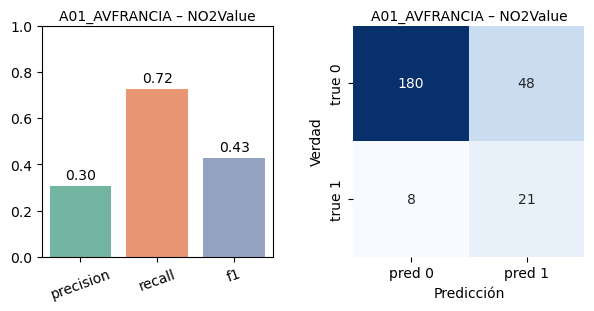


 A01_AVFRANCIA – O3Value


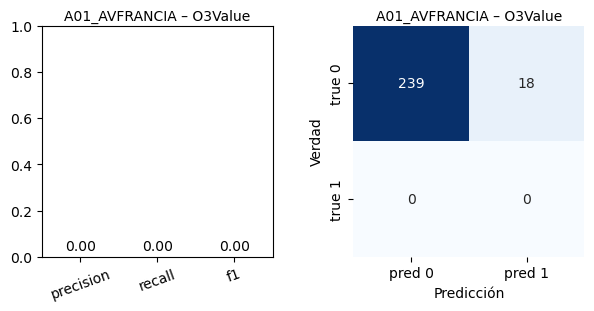


 A01_AVFRANCIA – PM25Value


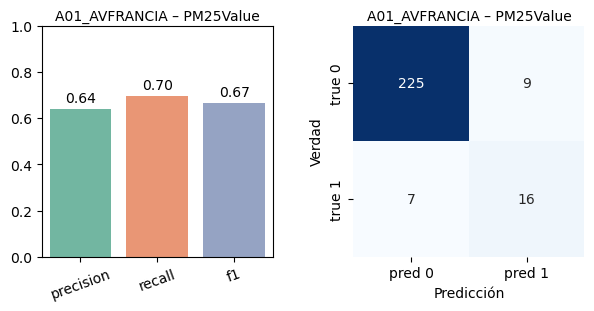


 A01_AVFRANCIA – SO2Value


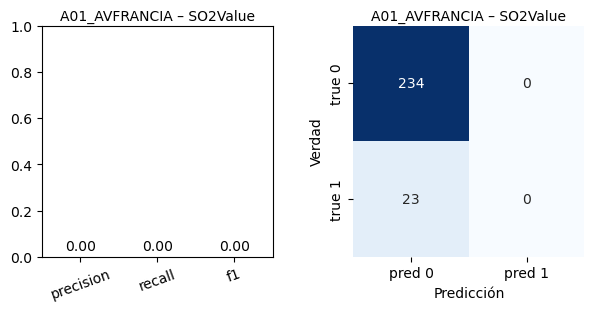


 A03_MOLISOL – NO2Value


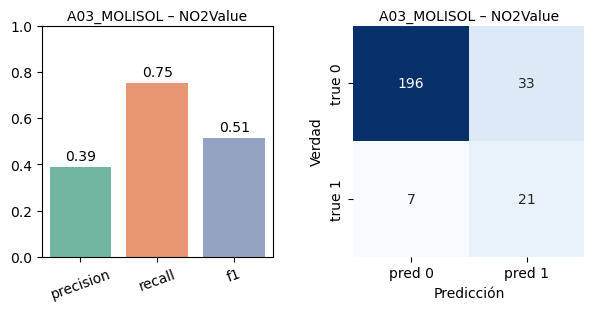


 A03_MOLISOL – O3Value


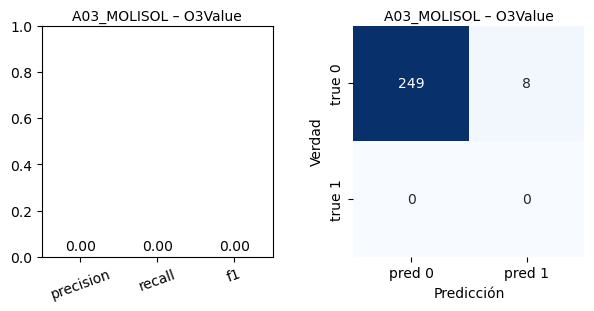


 A03_MOLISOL – PM25Value


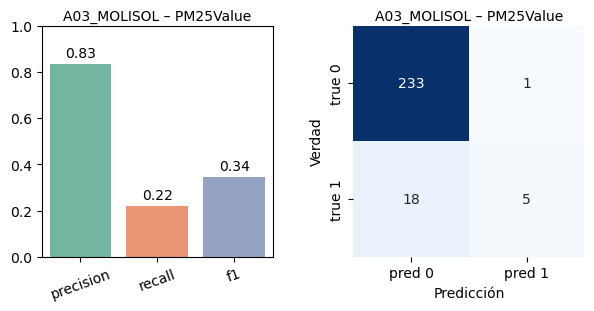


 A03_MOLISOL – SO2Value


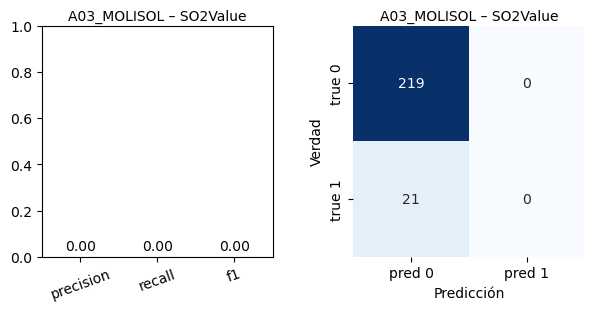


 A04_PISTASILLA – NO2Value


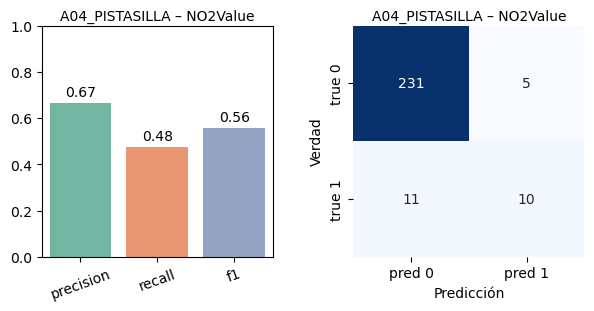


 A04_PISTASILLA – O3Value


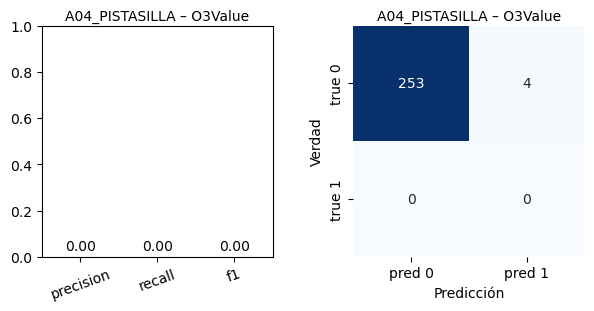


 A04_PISTASILLA – PM25Value


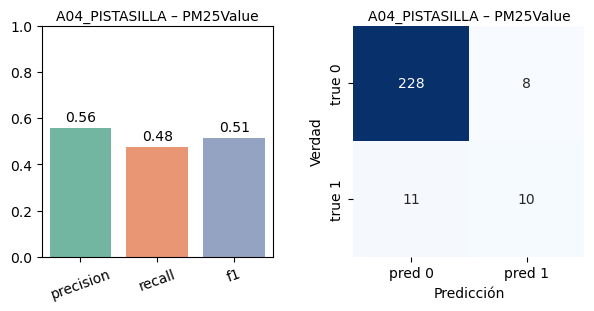


 A04_PISTASILLA – SO2Value


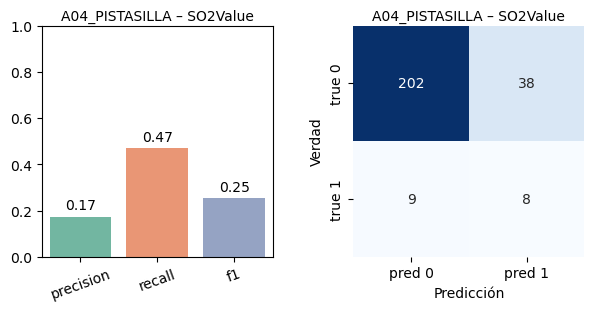


 A07_VALENCIACENTRE – NO2Value


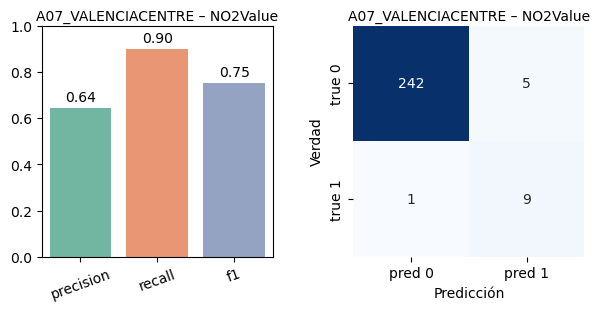


 A07_VALENCIACENTRE – PM25Value


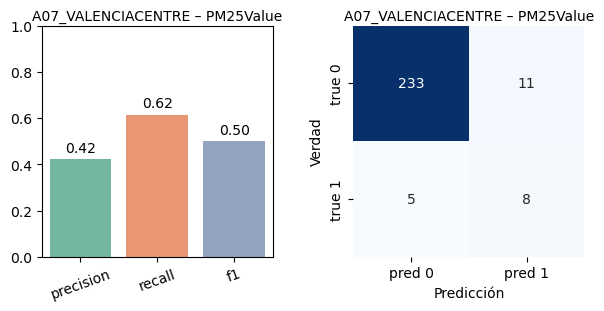


 A09_CABANYAL – NO2Value


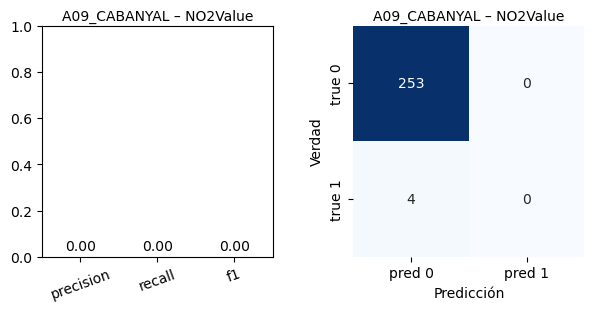


 A09_CABANYAL – PM25Value


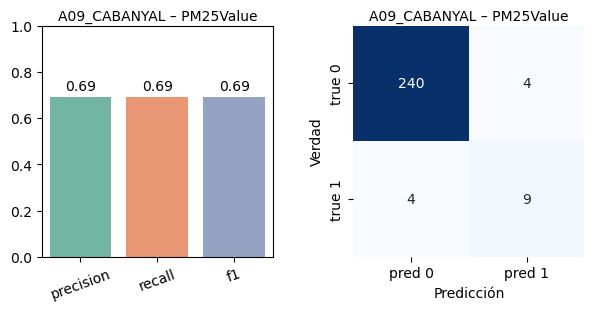

PARA LAS ANOMALÍAS LEGALES

 A01_AVFRANCIA – NO2Value


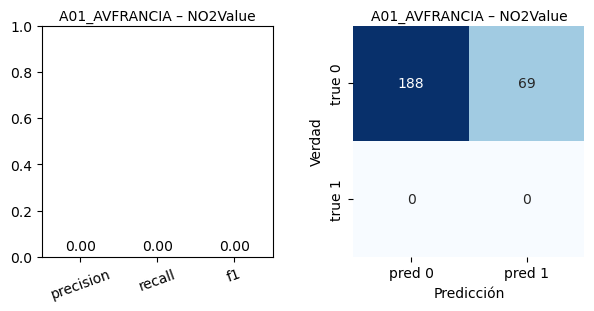


 A01_AVFRANCIA – O3Value


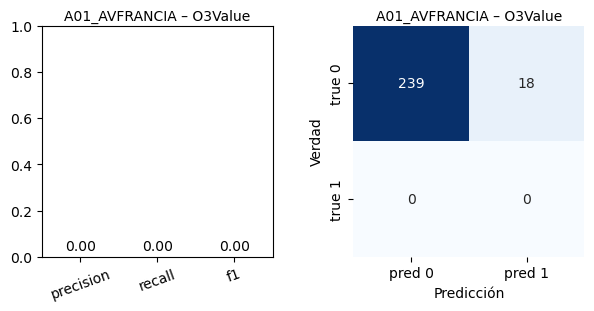


 A01_AVFRANCIA – PM25Value


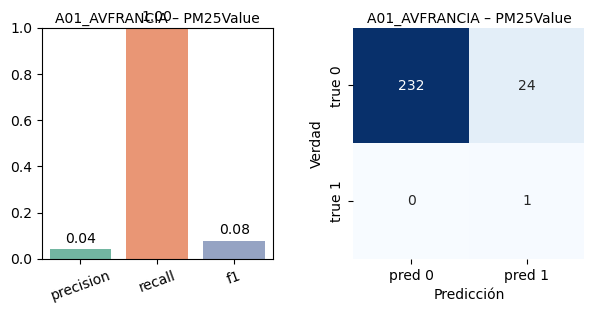


 A01_AVFRANCIA – SO2Value


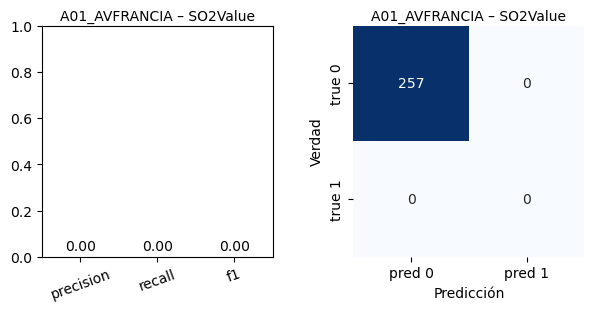


 A03_MOLISOL – NO2Value


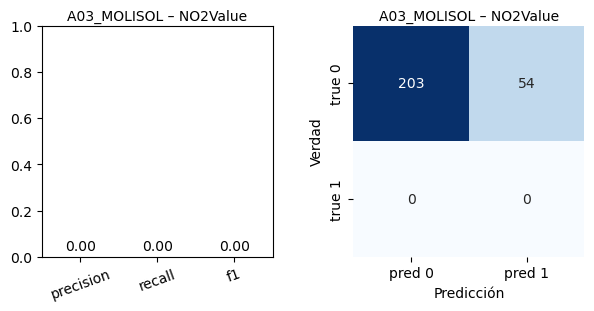


 A03_MOLISOL – O3Value


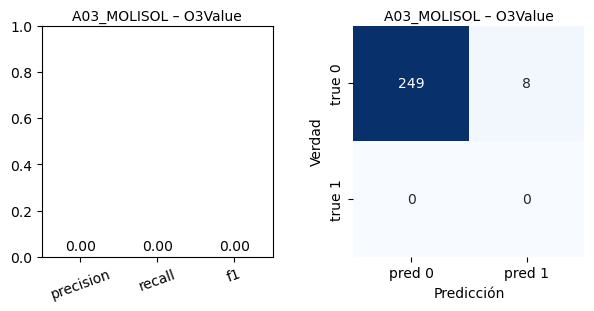


 A03_MOLISOL – PM25Value


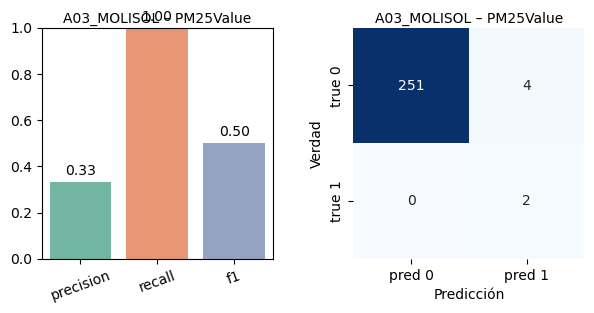


 A03_MOLISOL – SO2Value


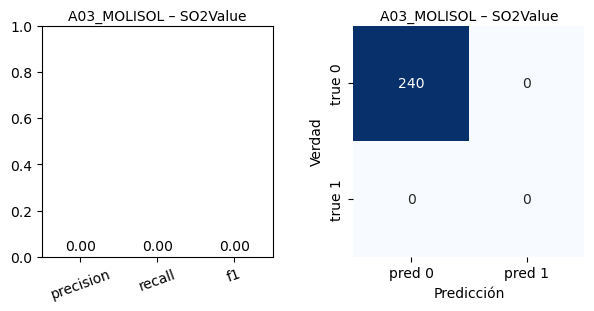


 A04_PISTASILLA – NO2Value


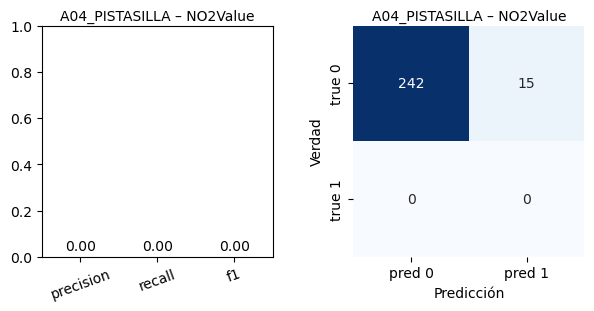


 A04_PISTASILLA – O3Value


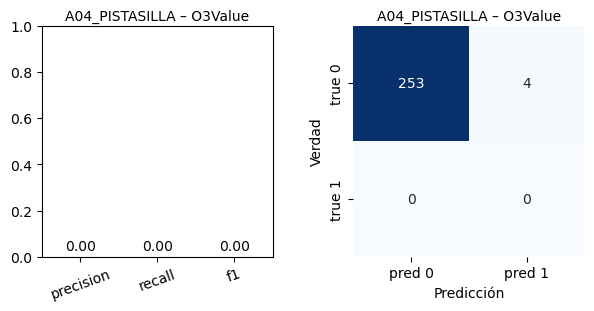


 A04_PISTASILLA – PM25Value


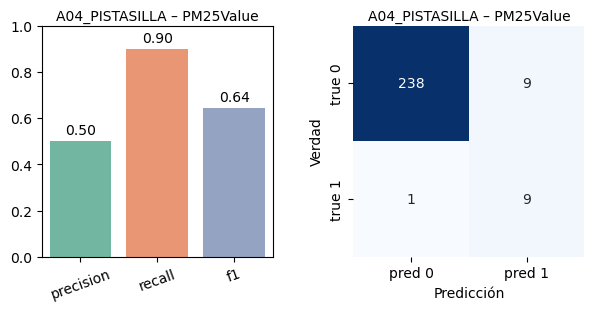


 A04_PISTASILLA – SO2Value


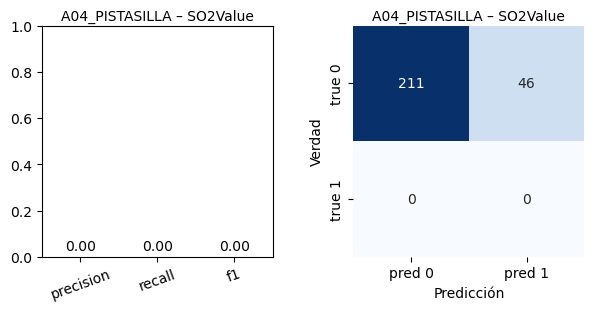


 A07_VALENCIACENTRE – NO2Value


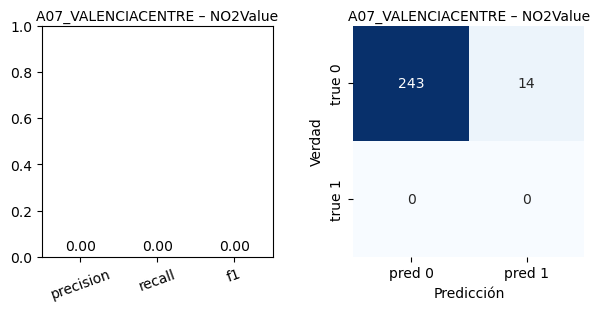


 A07_VALENCIACENTRE – PM25Value


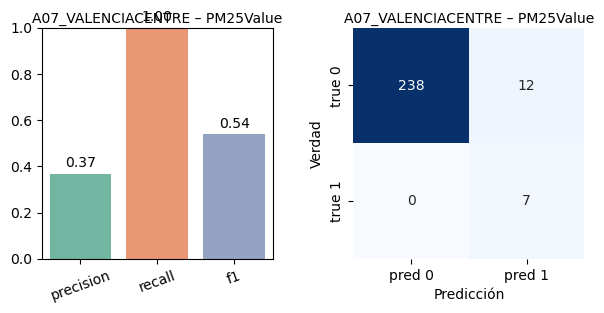


 A09_CABANYAL – NO2Value


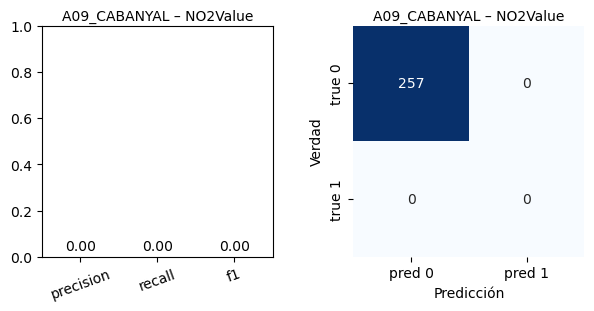


 A09_CABANYAL – PM25Value


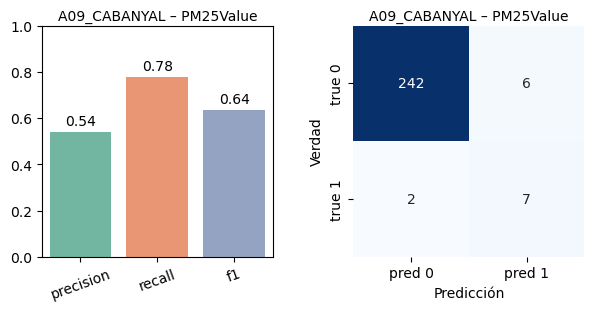

In [54]:
ruta = "modelos/isolation/anomalias_IsolationForest_optimo.xlsx"
xlsx  = pd.ExcelFile(ruta)

print("PARA LAS ANOMALÍAS DEL COMITÉ")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_comite"
    col_modelo  = "anomaly_iso_opt" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

print("PARA LAS ANOMALÍAS LEGALES")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_legal"
    col_modelo  = "anomaly_iso_opt" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

#### Anomalías legales como Y. 

In [55]:
resultados = []

for (estacion, contaminante), df in st_anomalias.items():
    cont_col = f'{contaminante}_anom_legal'
    if cont_col not in df.columns:
        continue

    # Ejecuta el tuning
    df_tune = tune_isolation_forest(
        df, cont_col,
        preparar_features=preparar_features,
        dividir_st=dividir_st
    )

    # Añade columnas de contexto
    df_tune['estacion']     = estacion
    df_tune['contaminante'] = contaminante
    resultados.append(df_tune)

# Concatenar todo
df_all_tune_legal = pd.concat(resultados, ignore_index=True)

In [56]:
mejor_por_serie_legal = (
    df_all_tune_legal
    .sort_values(['estacion','contaminante','f1'], ascending=[True,True,False])
    .groupby(['estacion','contaminante'], as_index=False)
    .first()
    [['estacion','contaminante','contamination','n_estimators','max_samples','max_features','precision','recall','f1']]
)

In [57]:
final_labels = {}

for _, row in mejor_por_serie_legal.iterrows():
    est  = row['estacion']
    cont = row['contaminante']
    params = {
        'contamination': row['contamination'],
        'n_estimators':  int(row['n_estimators']),
        'max_samples':   row['max_samples'],
        'max_features':  row['max_features']
    }
    df = st_anomalias[(est,cont)]
    df_train, df_test = dividir_st(df)
    X_train = preparar_features(df_train)
    X_test  = preparar_features(df_test)

    model = IsolationForest(**params, random_state=42)
    model.fit(X_train)

    df_test_res = df_test.loc[X_test.index].copy()
    df_test_res['anomaly_iso_opt'] = (model.predict(X_test)==-1)
    final_labels[(est,cont)] = df_test_res

In [58]:
# Directorio de salida
hojas_excel_opt = {}

# Recorremos las etiquetas finales optimizadas
for (est, cont), df_res in final_labels.items():
    # Nombre de hoja (igual lógica que antes)
    hoja_train = f"{est}_{cont}_train".replace("Value", "").replace("_10m", "")[:31]
    hoja_test  = f"{est}_{cont}_test".replace("Value", "").replace("_10m", "")[:31]
    
    # Recuperamos df_train original (sin etiquetas) y le añadimos la columna optimizada
    df_full = st_anomalias[(est, cont)]
    df_train, df_test = dividir_st(df_full)
    
    # Alineamos índices y añadimos la nueva bandera
    df_train_opt = df_train.loc[df_res.index.intersection(df_train.index)].copy()
    df_train_opt = df_train.copy()
    
    df_test_opt  = df_test.loc[df_res.index].copy()
    df_test_opt ['anomaly_iso_opt'] = df_res['anomaly_iso_opt']
    
    # Localize
    df_train_opt.index = df_train_opt.index.tz_localize(None)
    df_test_opt .index = df_test_opt .index.tz_localize(None)
    
    # Guardar en el dict de hojas
    hojas_excel_opt[hoja_train] = df_train_opt
    hojas_excel_opt[hoja_test]  = df_test_opt

# Escribir el Excel final
ruta_excel_opt = "modelos/isolation/anomalias_IsolationForest_optimoLEGAL.xlsx"
with pd.ExcelWriter(ruta_excel_opt, engine='xlsxwriter') as writer:
    for hoja, df_hoja in hojas_excel_opt.items():
        df_hoja.to_excel(writer, sheet_name=hoja)

Estación: A01_AVFRANCIA | Contaminante: NO2Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 21 de 29 anomalías manuales.
    Precisión de coincidencias: 0.30
Estación: A01_AVFRANCIA | Contaminante: O3Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 0 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A01_AVFRANCIA | Contaminante: PM25Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 4 de 23 anomalías manuales.
    Precisión de coincidencias: 1.00
Estación: A01_AVFRANCIA | Contaminante: SO2Value
  Saltando comparación: faltan columnas ['anomaly_iso_opt']
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 0 de 23 anomalías manuales.
    El modelo no detectó ninguna anomalía.
Estación: A03_MOLISOL | Contaminante: NO2Value

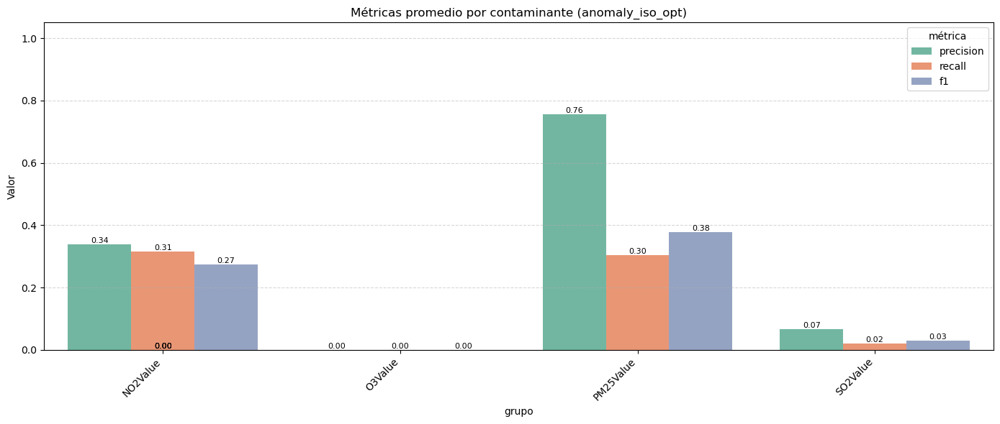

In [59]:
evaluar_y_visualizar_anomalias("modelos/isolation/anomalias_IsolationForest_optimoLEGAL.xlsx", col_modelo='anomaly_iso_opt')

PARA LAS ANOMALÍAS DEL COMITÉ

 A01_AVFRANCIA – NO2Value


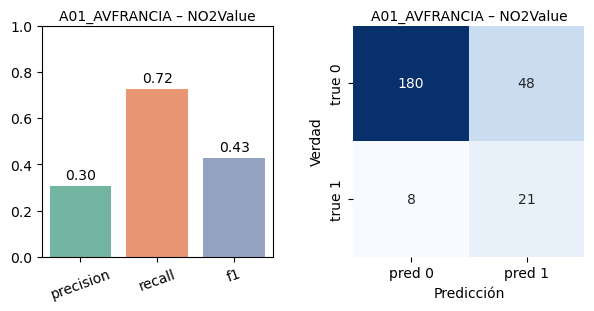


 A01_AVFRANCIA – O3Value


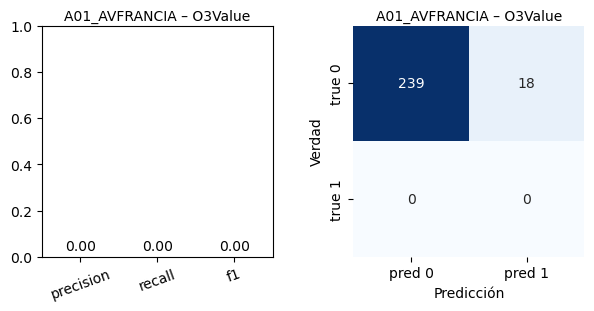


 A01_AVFRANCIA – PM25Value


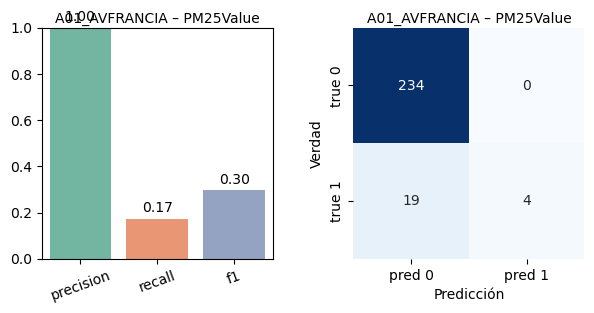


 A01_AVFRANCIA – SO2Value


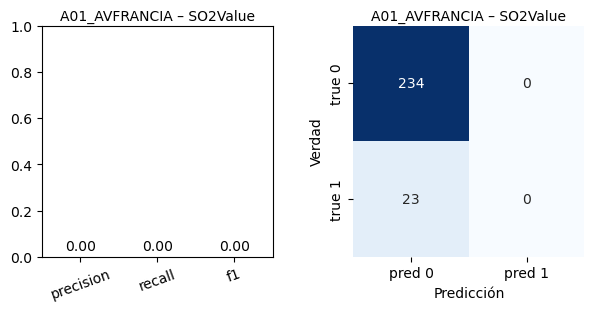


 A03_MOLISOL – NO2Value


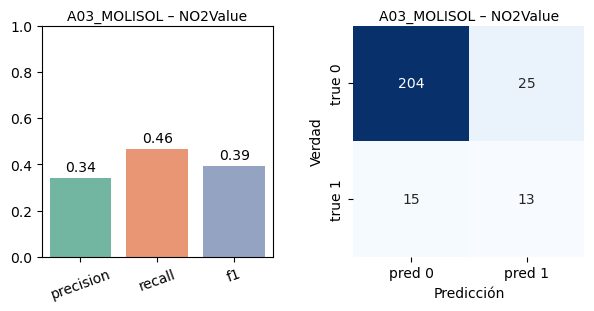


 A03_MOLISOL – O3Value


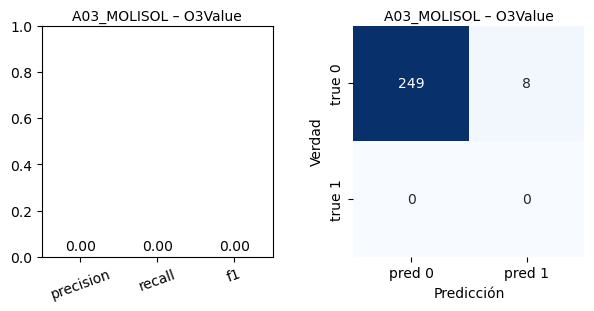


 A03_MOLISOL – PM25Value


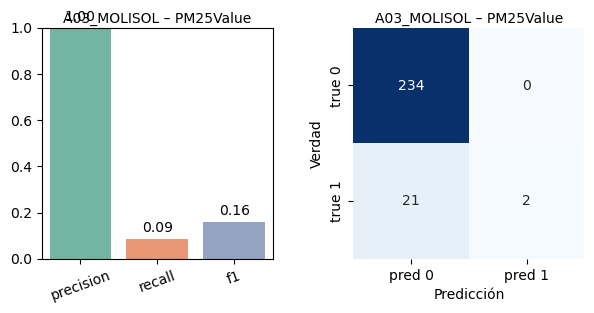


 A03_MOLISOL – SO2Value


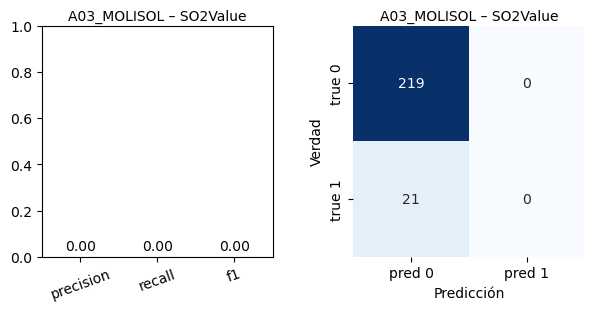


 A04_PISTASILLA – NO2Value


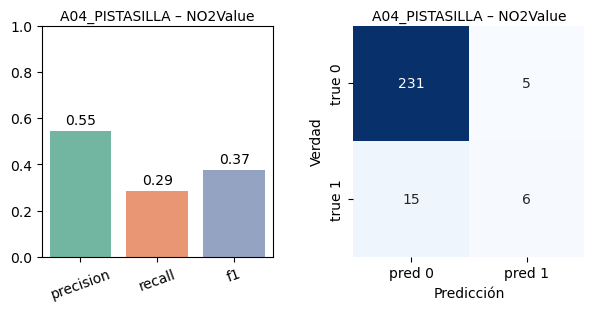


 A04_PISTASILLA – O3Value


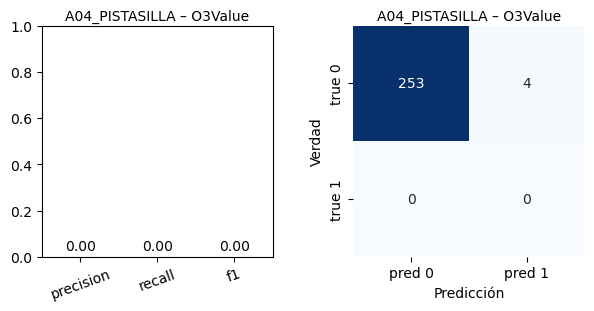


 A04_PISTASILLA – PM25Value


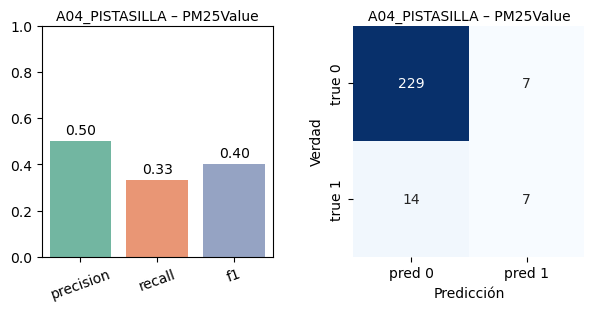


 A04_PISTASILLA – SO2Value


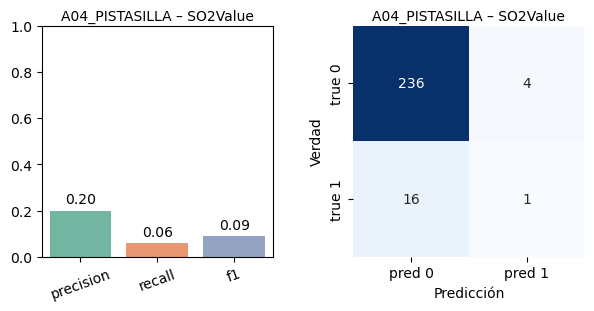


 A07_VALENCIACENTRE – NO2Value


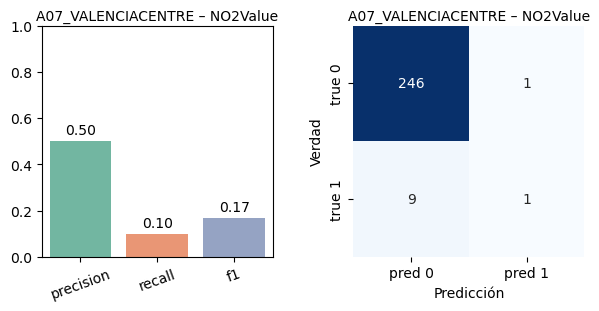


 A07_VALENCIACENTRE – PM25Value


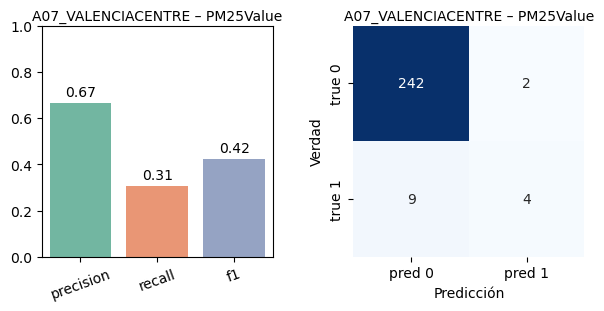


 A09_CABANYAL – NO2Value


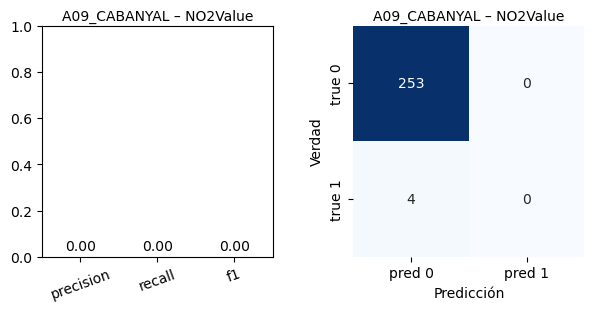


 A09_CABANYAL – PM25Value


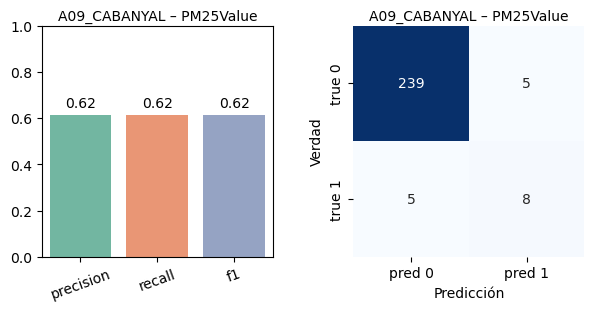

PARA LAS ANOMALÍAS LEGALES

 A01_AVFRANCIA – NO2Value


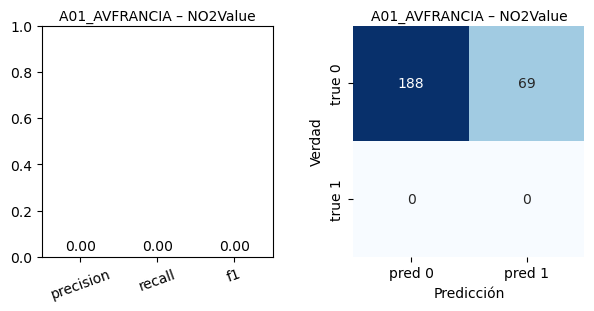


 A01_AVFRANCIA – O3Value


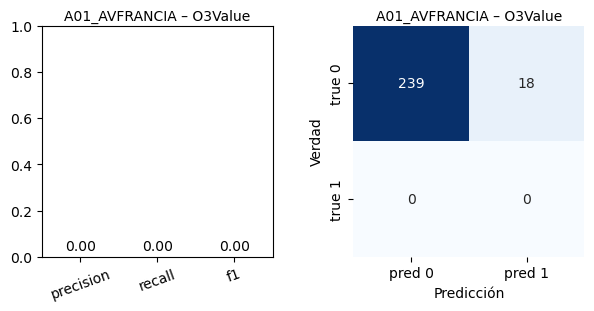


 A01_AVFRANCIA – PM25Value


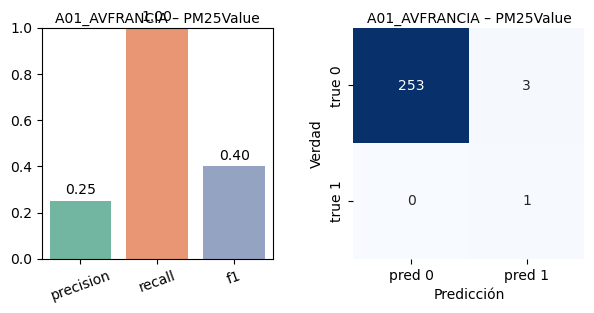


 A01_AVFRANCIA – SO2Value


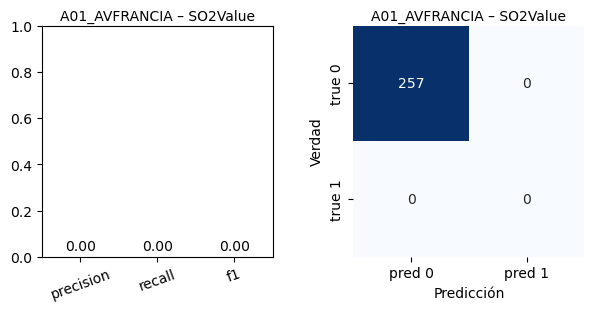


 A03_MOLISOL – NO2Value


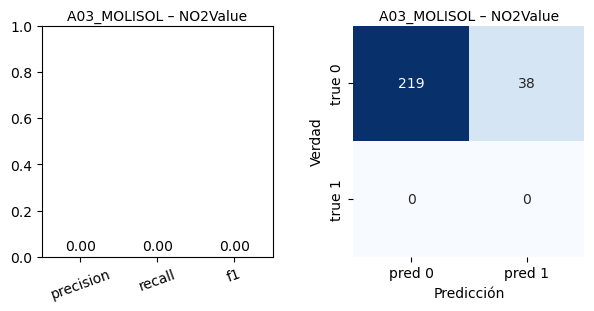


 A03_MOLISOL – O3Value


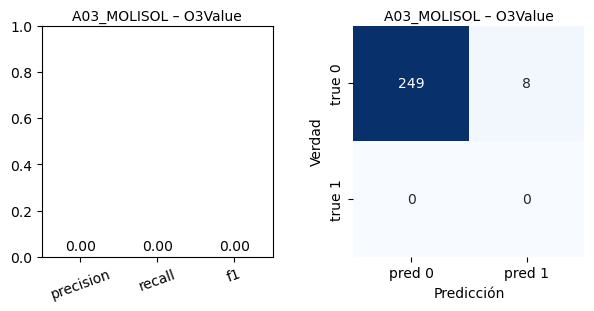


 A03_MOLISOL – PM25Value


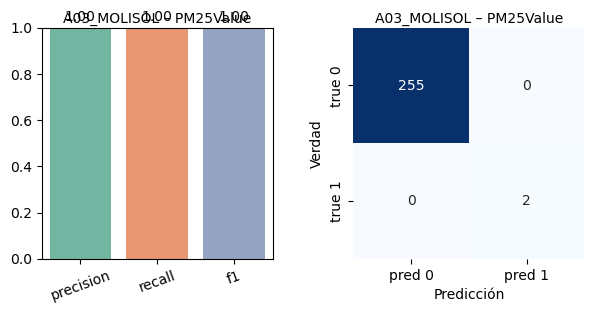


 A03_MOLISOL – SO2Value


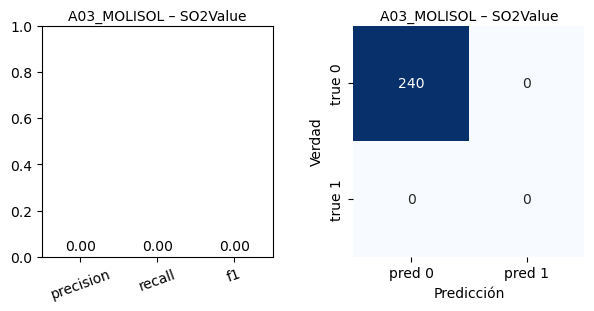


 A04_PISTASILLA – NO2Value


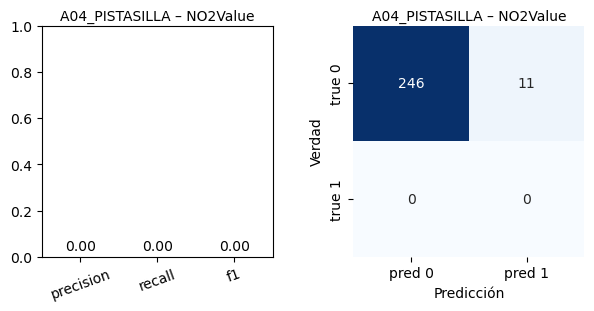


 A04_PISTASILLA – O3Value


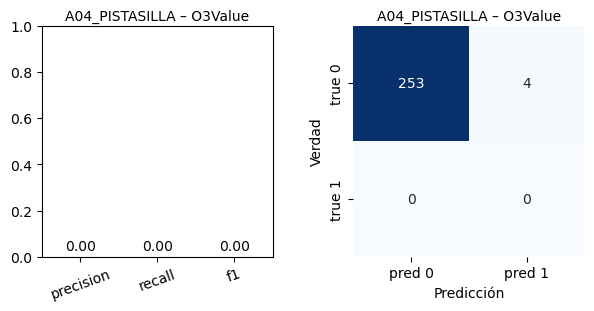


 A04_PISTASILLA – PM25Value


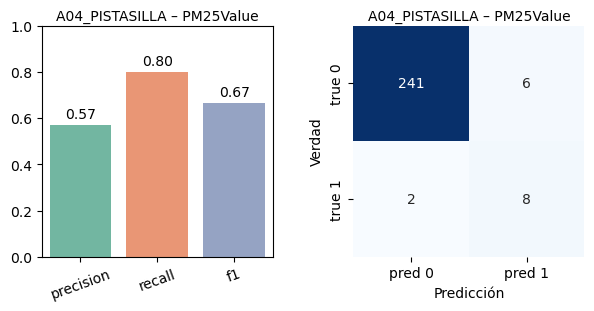


 A04_PISTASILLA – SO2Value


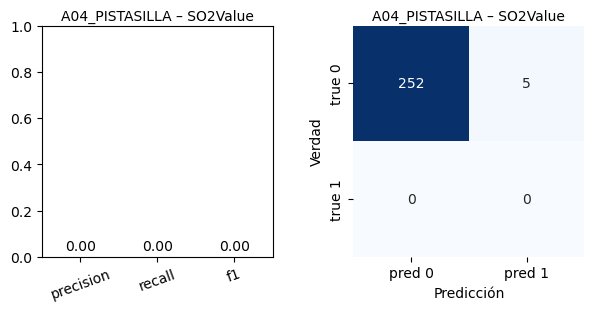


 A07_VALENCIACENTRE – NO2Value


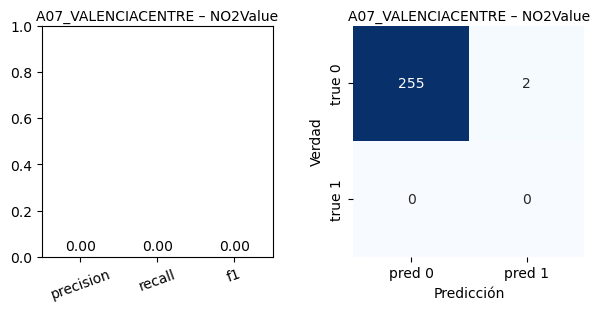


 A07_VALENCIACENTRE – PM25Value


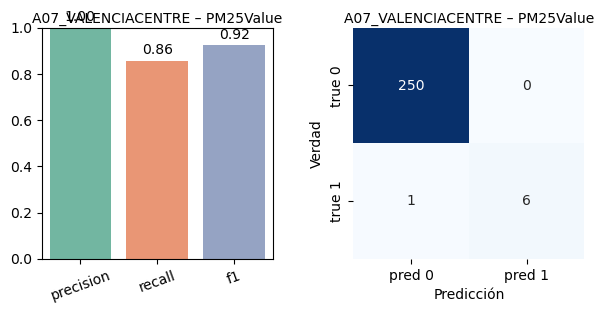


 A09_CABANYAL – NO2Value


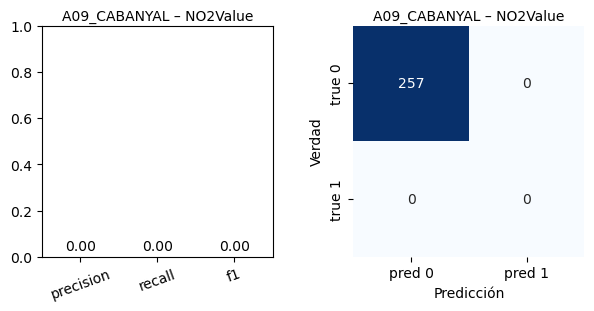


 A09_CABANYAL – PM25Value


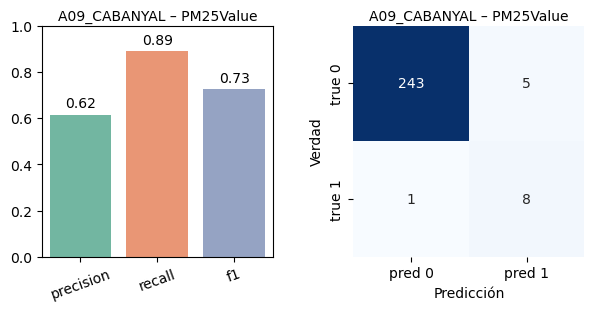

In [60]:
ruta = "modelos/isolation/anomalias_IsolationForest_optimoLEGAL.xlsx"
xlsx  = pd.ExcelFile(ruta)

print("PARA LAS ANOMALÍAS DEL COMITÉ")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_comite"
    col_modelo  = "anomaly_iso_opt" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

print("PARA LAS ANOMALÍAS LEGALES")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_legal"
    col_modelo  = "anomaly_iso_opt" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

### Implementación GridSearchCV + TimeSeriesSplit

In [61]:
def tune_iso_with_gridsearch(df, cont_col, preparar_features, dividir_st, param_grid=None, n_splits=5):
    """
    Usa GridSearchCV + TimeSeriesSplit para optimizar un IsolationForest
    basado en F1 sobre la etiqueta cont_col.
    """
    # 1) Default grid
    if param_grid is None:
        param_grid = {
            'contamination': np.linspace(0.005, 0.05, 10),
            'n_estimators':  [50, 100, 200],
            'max_samples':   [0.5, 0.75, 1.0],
            'max_features':  [0.5, 1.0]
        }

    # 2) Split único en train/test (usamos solo train para CV)
    df_train, _ = dividir_st(df)
    X_train     = preparar_features(df_train)
    y_train     = df_train[cont_col].fillna(False).astype(int).loc[X_train.index]

    # 3) TimeSeriesSplit
    tscv = TimeSeriesSplit(n_splits=n_splits)

    # 4) GridSearchCV
    iso = IsolationForest(random_state=42)
    scorer = make_scorer(f1_score, zero_division=0)

    gs = GridSearchCV(
        estimator=iso,
        param_grid=param_grid,
        cv=tscv,
        scoring=scorer,
        n_jobs=-1,
        verbose=1,
        refit=True
    )
    gs.fit(X_train, y_train)

    # 5) Recoger resultados
    results = pd.DataFrame(gs.cv_results_)[[
        'param_contamination',
        'param_n_estimators',
        'param_max_samples',
        'param_max_features',
        'mean_test_score',
        'std_test_score',
        'rank_test_score'
    ]]
    results.rename(columns={
        'param_contamination': 'contamination',
        'param_n_estimators':  'n_estimators',
        'param_max_samples':   'max_samples',
        'param_max_features':  'max_features',
        'mean_test_score':     'f1_mean',
        'std_test_score':      'f1_std',
    }, inplace=True)

    best_params = gs.best_params_
    best_score  = gs.best_score_

    return results, best_params, best_score, gs.best_estimator_

#### Anomalías del comité como Y. 

In [62]:
# Contendrá toda la grilla CV por serie
all_cv_results = []
# Contendrá los mejores parámetros y métrica test por serie
all_final_metrics = []

for (estacion, contaminante), df in tqdm(st_anomalias.items()):
    cont_col = f"{contaminante}_anom_comite"
    # Saltar si no hay etiqueta de comité
    if cont_col not in df.columns:
        continue

    # 1) Tuning con CV interno
    results, best_params, best_score, best_model = tune_iso_with_gridsearch(
        df,
        cont_col,
        preparar_features=preparar_features,
        dividir_st=dividir_st,
        n_splits=5
    )

    # Añade contexto y acumula la grilla
    results['estacion']     = estacion
    results['contaminante'] = contaminante
    all_cv_results.append(results)

    # 2) Evaluación final en TEST
    df_train, df_test = dividir_st(df)
    X_test  = preparar_features(df_test)
    y_test  = df_test[cont_col].fillna(False).astype(int).loc[X_test.index]
    y_pred  = (best_model.predict(X_test) == -1).astype(int)

    prec = precision_score(y_test, y_pred, zero_division=0)
    rec  = recall_score   (y_test, y_pred, zero_division=0)
    f1   = f1_score       (y_test, y_pred, zero_division=0)

    all_final_metrics.append({
        'estacion':        estacion,
        'contaminante':    contaminante,
        **best_params,
        'f1_cv_mean':      best_score,
        'precision_test':  prec,
        'recall_test':     rec,
        'f1_test':         f1
    })

# Concatenar DataFrames finales
df_cv     = pd.concat(all_cv_results,   ignore_index=True)
df_metrics= pd.DataFrame(all_final_metrics)

  0%|          | 0/16 [00:00<?, ?it/s]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


  6%|▋         | 1/16 [01:27<21:59, 87.98s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 12%|█▎        | 2/16 [02:41<18:30, 79.30s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 19%|█▉        | 3/16 [03:45<15:42, 72.48s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 25%|██▌       | 4/16 [04:45<13:28, 67.40s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 31%|███▏      | 5/16 [05:45<11:55, 65.02s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 38%|███▊      | 6/16 [06:44<10:29, 62.92s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 44%|████▍     | 7/16 [07:48<09:29, 63.26s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 50%|█████     | 8/16 [08:48<08:15, 61.98s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 56%|█████▋    | 9/16 [09:47<07:08, 61.21s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 62%|██████▎   | 10/16 [10:48<06:06, 61.01s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 69%|██████▉   | 11/16 [11:52<05:10, 62.16s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 75%|███████▌  | 12/16 [12:53<04:06, 61.69s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 81%|████████▏ | 13/16 [14:04<03:13, 64.61s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 88%|████████▊ | 14/16 [15:17<02:14, 67.05s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 94%|█████████▍| 15/16 [16:27<01:07, 67.82s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


100%|██████████| 16/16 [17:36<00:00, 66.03s/it]


In [63]:
# Ejemplo de salida
print("Resumen CV (Top 3 por serie):")
print(df_cv.groupby(['estacion','contaminante'])
             .apply(lambda d: d.nlargest(1, 'f1_mean'))
             .reset_index(drop=True))

print("Mejores parámetros y métricas en TEST:")
print(df_metrics)

Resumen CV (Top 3 por serie):
   contamination n_estimators max_samples max_features   f1_mean    f1_std  \
0          0.005          100         0.5          1.0  0.161029  0.161478   
1          0.005           50         0.5          0.5       NaN       NaN   
2          0.005          100         0.5          0.5  0.178703  0.094413   
3          0.005           50         0.5          0.5       NaN       NaN   
4          0.005           50         0.5          0.5       NaN       NaN   
5          0.005           50         0.5          0.5       NaN       NaN   
6          0.005           50         0.5          0.5       NaN       NaN   
7          0.005           50         0.5          0.5       NaN       NaN   
8          0.005          200         0.5          0.5  0.157533  0.162307   
9          0.005           50         0.5          0.5       NaN       NaN   
10         0.005           50         0.5          0.5       NaN       NaN   
11         0.005           50     

#### Anomalías legales como Y. 

In [64]:
# Contendrá toda la grilla CV por serie
all_cv_results_legal = []
# Contendrá los mejores parámetros y métrica test por serie
all_final_metrics_legal = []

for (estacion, contaminante), df in tqdm(st_anomalias.items()):
    cont_col = f"{contaminante}_anom_legal"
    # Saltar si no hay etiqueta de comité
    if cont_col not in df.columns:
        continue

    # 1) Tuning con CV interno
    results, best_params, best_score, best_model = tune_iso_with_gridsearch(
        df,
        cont_col,
        preparar_features=preparar_features,
        dividir_st=dividir_st,
        n_splits=5
    )

    # Añade contexto y acumula la grilla
    results['estacion']     = estacion
    results['contaminante'] = contaminante
    all_cv_results_legal.append(results)

    # 2) Evaluación final en TEST
    df_train, df_test = dividir_st(df)
    X_test  = preparar_features(df_test)
    y_test  = df_test[cont_col].fillna(False).astype(int).loc[X_test.index]
    y_pred  = (best_model.predict(X_test) == -1).astype(int)

    prec = precision_score(y_test, y_pred, zero_division=0)
    rec  = recall_score   (y_test, y_pred, zero_division=0)
    f1   = f1_score       (y_test, y_pred, zero_division=0)

    all_final_metrics_legal.append({
        'estacion':        estacion,
        'contaminante':    contaminante,
        **best_params,
        'f1_cv_mean':      best_score,
        'precision_test':  prec,
        'recall_test':     rec,
        'f1_test':         f1
    })

# Concatenar DataFrames finales
df_cv = pd.concat(all_cv_results_legal,   ignore_index=True)
df_metrics= pd.DataFrame(all_final_metrics_legal)

  0%|          | 0/16 [00:00<?, ?it/s]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


  6%|▋         | 1/16 [01:14<18:33, 74.23s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 12%|█▎        | 2/16 [02:23<16:41, 71.52s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 19%|█▉        | 3/16 [03:42<16:14, 74.97s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 25%|██▌       | 4/16 [04:45<14:01, 70.11s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 31%|███▏      | 5/16 [05:50<12:31, 68.34s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 38%|███▊      | 6/16 [07:00<11:28, 68.90s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 44%|████▍     | 7/16 [08:20<10:52, 72.46s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 50%|█████     | 8/16 [09:36<09:48, 73.54s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 56%|█████▋    | 9/16 [10:37<08:06, 69.56s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 62%|██████▎   | 10/16 [11:38<06:41, 67.00s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 69%|██████▉   | 11/16 [12:41<05:29, 65.86s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 75%|███████▌  | 12/16 [13:47<04:23, 65.80s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 81%|████████▏ | 13/16 [14:51<03:15, 65.24s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 88%|████████▊ | 14/16 [15:53<02:08, 64.33s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


 94%|█████████▍| 15/16 [16:58<01:04, 64.45s/it]

Fitting 5 folds for each of 180 candidates, totalling 900 fits


100%|██████████| 16/16 [18:02<00:00, 67.63s/it]


In [65]:
# Ejemplo de salida
print("Resumen CV (Top 1 por serie):")
print(df_cv.groupby(['estacion','contaminante'])
             .apply(lambda d: d.nlargest(1, 'f1_mean'))
             .reset_index(drop=True))

print("Mejores parámetros y métricas en TEST:")
print(df_metrics)

Resumen CV (Top 1 por serie):
   contamination n_estimators max_samples max_features   f1_mean    f1_std  \
0          0.005          100         0.5          1.0  0.000000  0.000000   
1          0.005           50         0.5          0.5       NaN       NaN   
2          0.005          100         0.5          0.5  0.003922  0.007843   
3          0.005           50         0.5          0.5       NaN       NaN   
4          0.005           50         0.5          0.5       NaN       NaN   
5          0.005           50         0.5          0.5       NaN       NaN   
6          0.005           50         0.5          0.5       NaN       NaN   
7          0.005           50         0.5          0.5       NaN       NaN   
8          0.005          200         0.5          0.5  0.000000  0.000000   
9          0.005           50         0.5          0.5       NaN       NaN   
10         0.005           50         0.5          0.5       NaN       NaN   
11         0.005           50     

## LSTM Autoencoder

In [71]:
# Función para crear ventanas secuenciales
def crear_ventanas(df, window_size=14, step=1,scaler=None, fit_scaler=False):
    """
    df: DataFrame con índice datetime y columna 'value'
    window_size: longitud de la secuencia para el LSTM
    step: salto entre ventanas
    Devuelve X: array de shape (n_windows, window_size, 1)
    """
    vals = df['value'].values.reshape(-1,1)
    if scaler is None:
        scaler = MinMaxScaler()
        fit_scaler = True                # forzamos ajuste

    vals_s = scaler.fit_transform(vals) if fit_scaler else scaler.transform(vals)
    X = []
    for start in range(0, len(vals_s) - window_size + 1, step):
        X.append(vals_s[start:start+window_size])
    return np.array(X), scaler

In [82]:
# Entrenar Autoencoder LSTM
def entrenar_autoencoder_lstm(df_train, window_size=14, latent_dim=8, epochs=50, batch_size=32, seed=None):
    """
    Construye y ajusta un autoencoder LSTM sobre train.
    Devuelve:
      model: el autoencoder completo,
      encoder: sólo la parte codificadora,
      scaler: el MinMaxScaler usado,
      X_train_seq: la matriz de secuencias usadas
    """
    if seed is not None:
        random.seed(seed)
        np.random.seed(seed)
        tf.random.set_seed(seed)

    # crear secuencias
    X_train_seq, scaler = crear_ventanas(df_train, window_size)
    
    # arquitectura
    inputs = Input(shape=(window_size,1))
    encoded = LSTM(latent_dim, activation='relu')(inputs)
    decoded = RepeatVector(window_size)(encoded)
    decoded = LSTM(1, activation='linear', return_sequences=True)(decoded)
    ae = Model(inputs, decoded)
    ae.compile(optimizer='adam', loss='mse')
    
    # entrenamiento
    es = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)
    ae.fit(X_train_seq, X_train_seq,
           epochs=epochs, batch_size=batch_size,
           callbacks=[es], verbose=1)
    
    return ae, scaler

In [68]:
# Detección de anomalías
def detectar_anomalias_ae(df, ae_model, scaler, window_size=14, sigma=3):
    """
    df: DataFrame ordenado (puede ser train o test)
    ae_model: autoencoder ya entrenado
    scaler: MinMaxScaler de train
    Devuelve: df_res con columna 'recon_error' y 'anomaly_ae'
    """
    vals = df['value'].values.reshape(-1,1)
    vals_s = scaler.transform(vals)
    # crear las mismas ventanas
    X, _ = crear_ventanas(df, window_size)
    # reconstruir
    X_rec = ae_model.predict(X)
    # error por ventana
    errors = np.mean((X_rec - X)**2, axis=(1,2))
    # umbral basado en train
    umbral = errors[:len(errors)] .mean() + sigma * errors[:len(errors)].std()
    
    # mapear back al índice: las primeras ventanas empiezan en index[0], etc.
    idxs = df.index[window_size-1:]
    df_res = pd.DataFrame({
        'recon_error': errors
    }, index=idxs)
    df_res['anomaly_ae'] = df_res['recon_error'] > umbral
    return df_res

In [69]:
# Pipeline completo: entrenar + detectar + guardar Excel
def pipeline_autoencoder(excel_out, st_anomalias, estaciones, contaminantes,
                         window_size=14, latent_dim=8):
    hojas = {}
    for estacion in estaciones:
        for cont in contaminantes:
            try:
                df = st_anomalias[(estacion, cont)]
                # 1) split
                df_train, df_test = dividir_st(df)
                # 2) entrenar AE
                ae, scaler = entrenar_autoencoder_lstm(df_train,
                                                    window_size=window_size,
                                                    latent_dim=latent_dim)
                # 3) detectar en train y test
                df_train_res = detectar_anomalias_ae(df_train, ae, scaler, window_size)
                df_test_res  = detectar_anomalias_ae(df_test,  ae, scaler, window_size)
                
                # 4) unimos flags al df original
                df_train_full = df_train.copy()
                df_train_full['recon_error'] = np.nan
                df_train_full['anomaly_ae'] = False
                df_train_full.loc[df_train_res.index, 'recon_error'] = df_train_res['recon_error']
                df_train_full.loc[df_train_res.index, 'anomaly_ae'] = df_train_res['anomaly_ae']
                
                df_test_full = df_test.copy()
                df_test_full['recon_error'] = np.nan
                df_test_full['anomaly_ae'] = False
                df_test_full.loc[df_test_res.index, 'recon_error'] = df_test_res['recon_error']
                df_test_full.loc[df_test_res.index, 'anomaly_ae'] = df_test_res['anomaly_ae']
                
                # 5) nombres de hoja igual que antes
                b = cont.replace("Value","")
                hoja_tr = f"{estacion}_{b}_train".replace("_10m","")[:31]
                hoja_te = f"{estacion}_{b}_test".replace("_10m","")[:31]
                hojas[hoja_tr] = df_train_full
                hojas[hoja_te] = df_test_full

            except KeyError:
                # no hay datos para esta pareja, la salto sin que de error
                continue
    
    # 6) escribir el Excel
    with pd.ExcelWriter(excel_out, engine='xlsxwriter') as wr:
        for hoja, dfh in hojas.items():
            dfh.index = dfh.index.tz_localize(None)
            dfh.to_excel(wr, sheet_name=hoja)

In [83]:
# Ejecución:
pipeline_autoencoder(
    excel_out="modelos/autoencoder/anomalias_AE_LSTM.xlsx",
    st_anomalias=st_anomalias,
    estaciones=estaciones_sel,
    contaminantes=['NO2Value','O3Value','PM25Value','SO2Value'],
    window_size=14,
    latent_dim=8
)

Epoch 1/50
19/19 [==============================] - 2s 6ms/step - loss: 0.0868
Epoch 2/50
19/19 [==============================] - 0s 6ms/step - loss: 0.0600
Epoch 3/50
19/19 [==============================] - 0s 6ms/step - loss: 0.0341
Epoch 4/50
19/19 [==============================] - 0s 6ms/step - loss: 0.0263
Epoch 5/50
19/19 [==============================] - 0s 6ms/step - loss: 0.0257
Epoch 6/50
19/19 [==============================] - 0s 8ms/step - loss: 0.0255
Epoch 7/50
19/19 [==============================] - 0s 7ms/step - loss: 0.0253
Epoch 8/50
19/19 [==============================] - 0s 10ms/step - loss: 0.0252
Epoch 9/50
19/19 [==============================] - 0s 7ms/step - loss: 0.0250
Epoch 10/50
19/19 [==============================] - 0s 7ms/step - loss: 0.0248
Epoch 11/50
19/19 [==============================] - 0s 7ms/step - loss: 0.0246
Epoch 12/50
19/19 [==============================] - 0s 6ms/step - loss: 0.0243
Epoch 13/50
19/19 [=============================

Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 1 de 82 anomalías manuales.
    Precisión de coincidencias: 0.05
Estación: A01_AVFRANCIA | Contaminante: NO2Value
    Coinciden 0 de 29 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 4 anomalías manuales.
    Precisión de coincidencias: 0.00
Estación: A01_AVFRANCIA | Contaminante: O3Value
    Coinciden 0 de 0 anomalías manuales.
    El modelo no detectó ninguna anomalía.
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 1 de 65 anomalías manuales.
    Precisión de coincidencias: 0.04
Estación: A01_AVFRANCIA | Contaminante: PM25Value
    Coinciden 2 de 23 anomalías manuales.
    Precisión de coincidencias: 0.50
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 4 de 58 anomalías manuales.
    Precisión de coincidencias: 0.24
Estación: A01_AVFRANCIA | Contaminante: SO2Value
    Coinciden 0 de 23 anomalías manuales.
    Preci

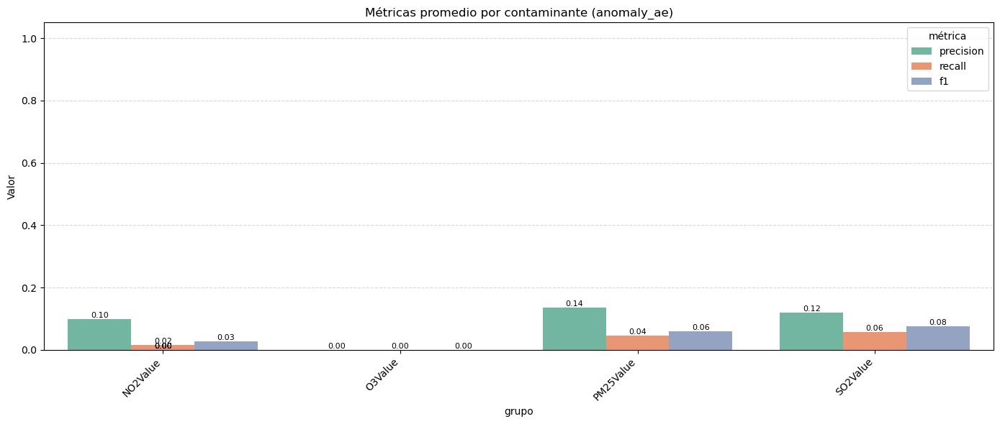

In [84]:
evaluar_y_visualizar_anomalias("modelos/autoencoder/anomalias_AE_LSTM.xlsx", col_modelo='anomaly_ae')

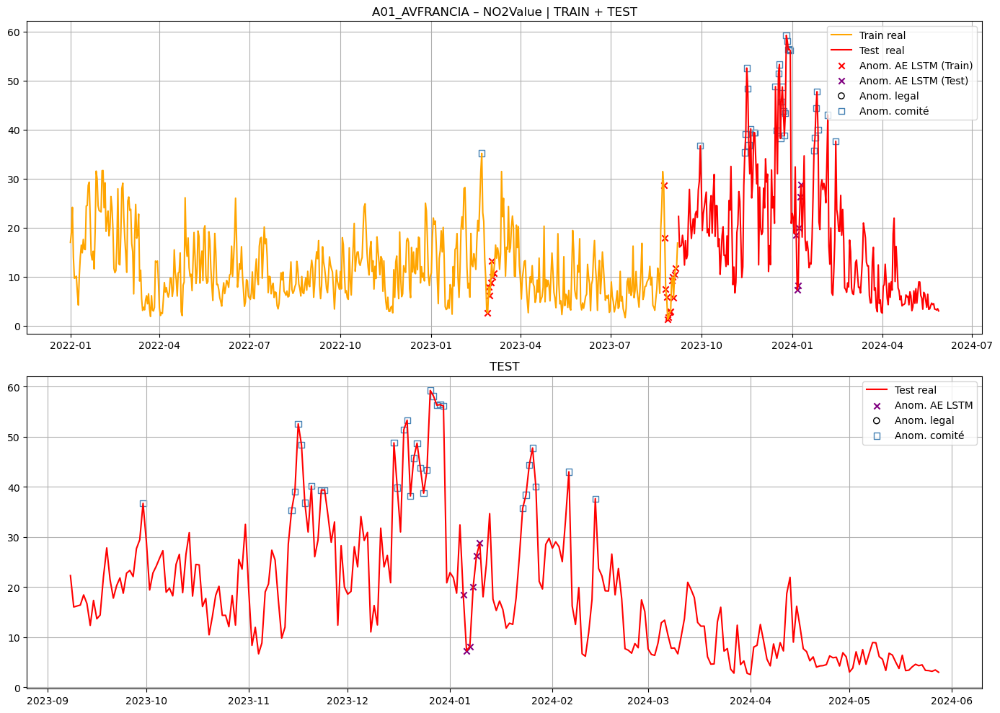

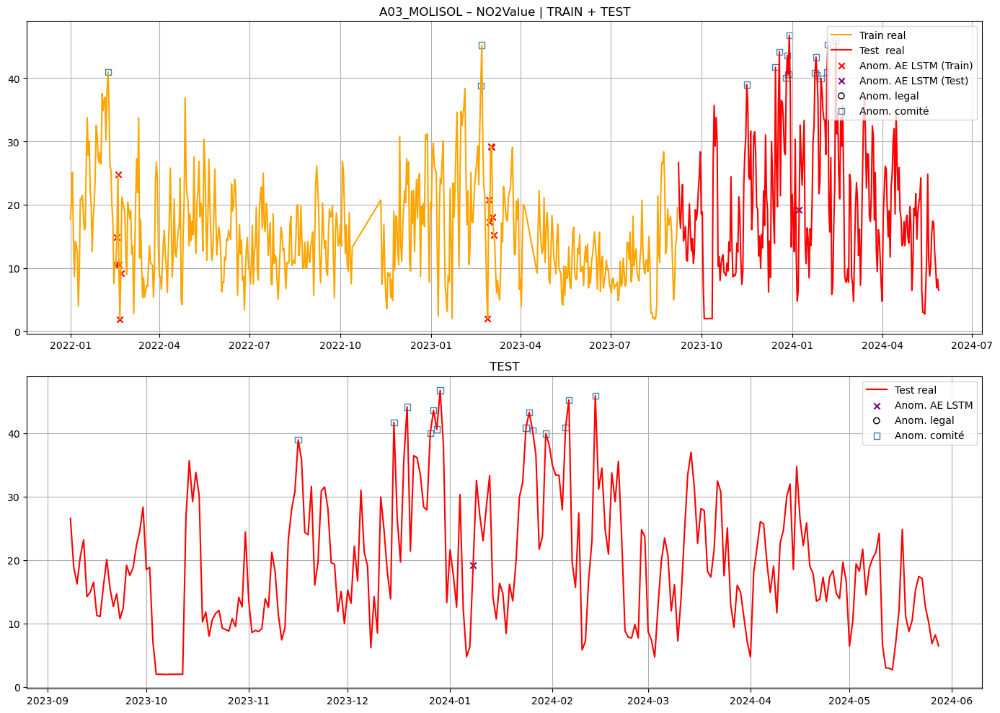

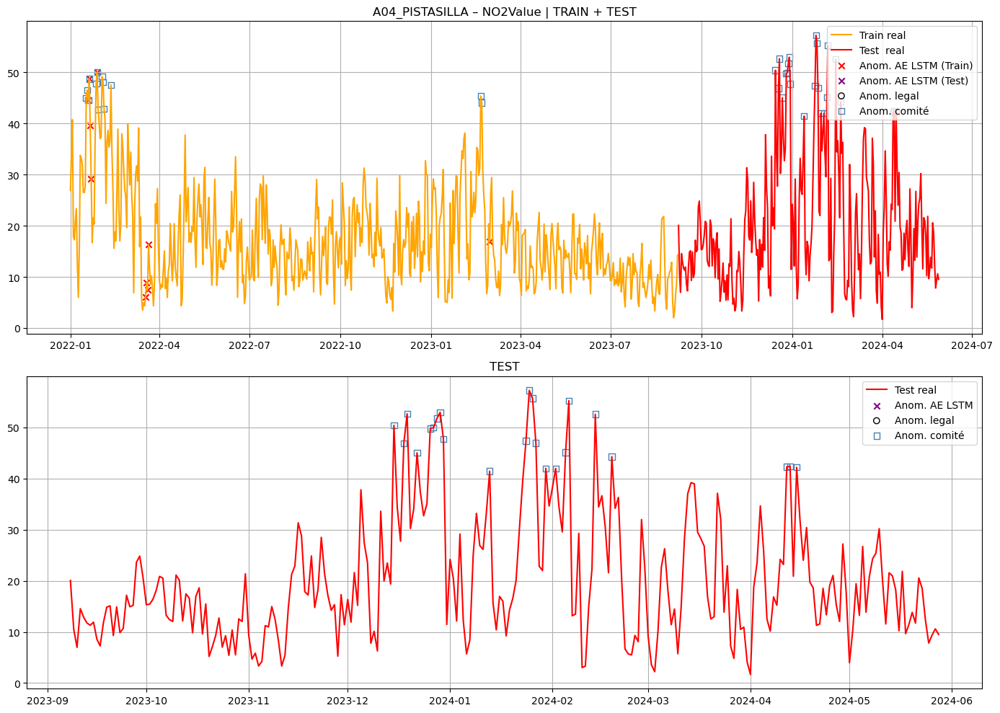

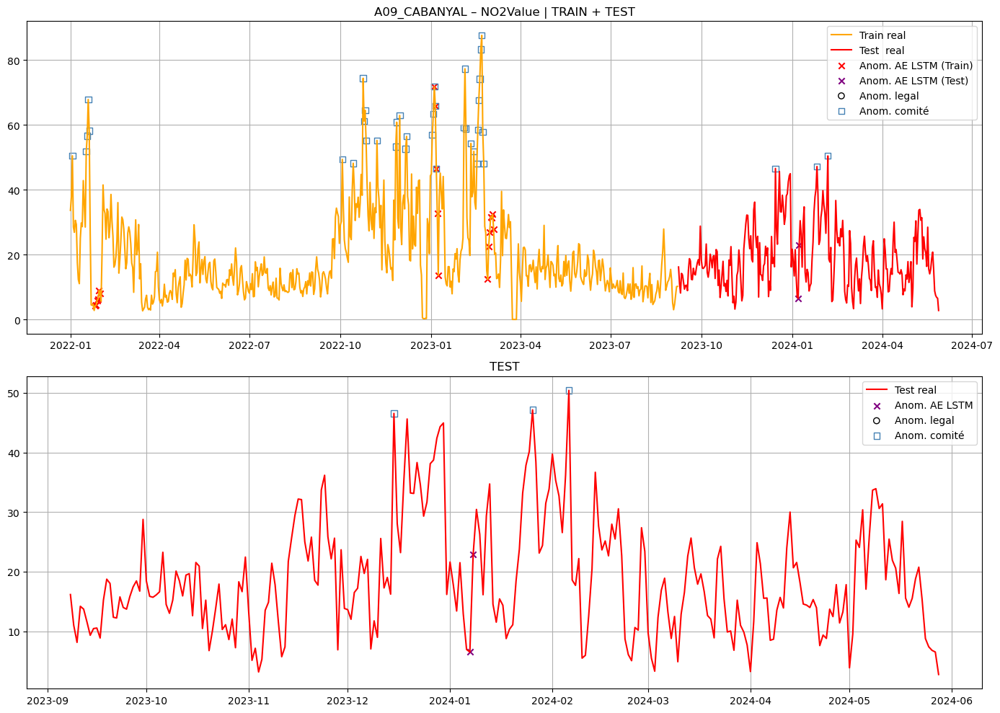

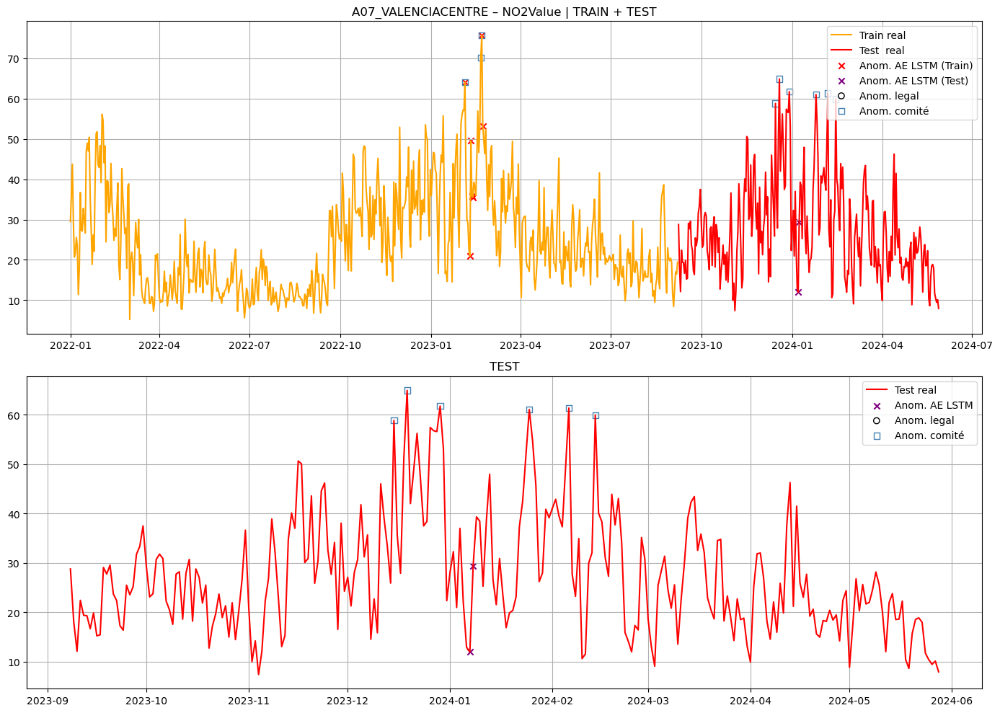

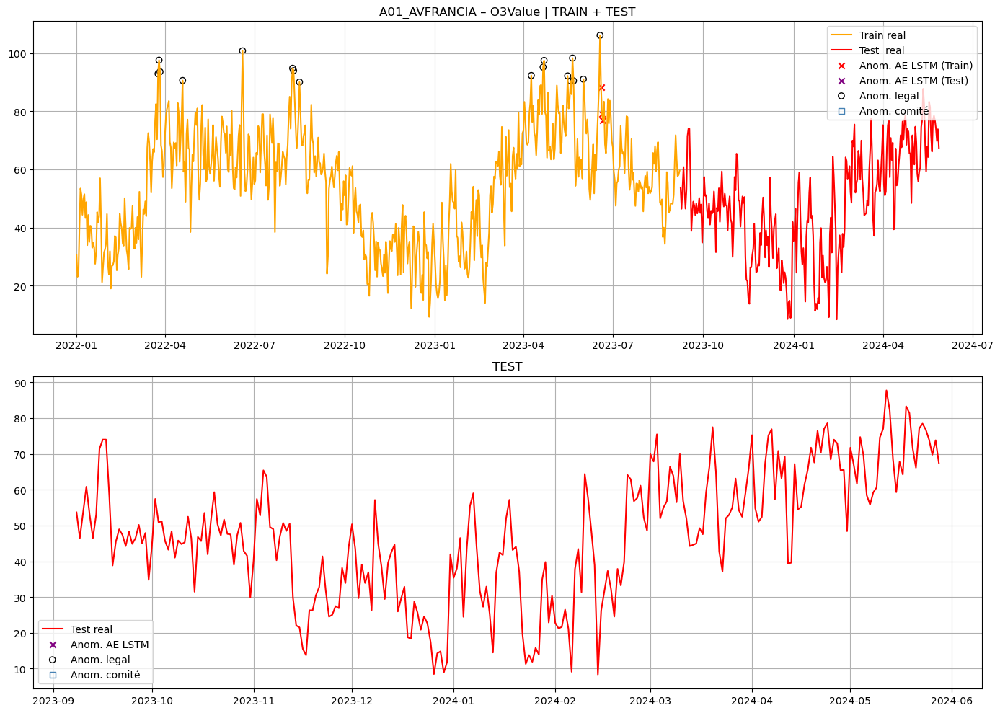

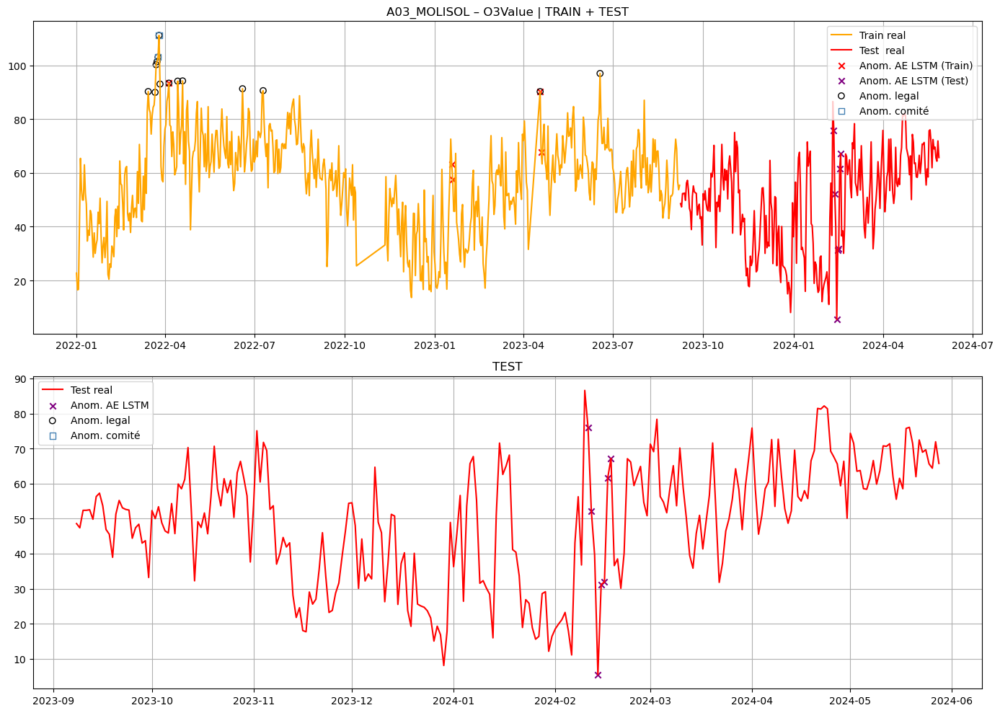

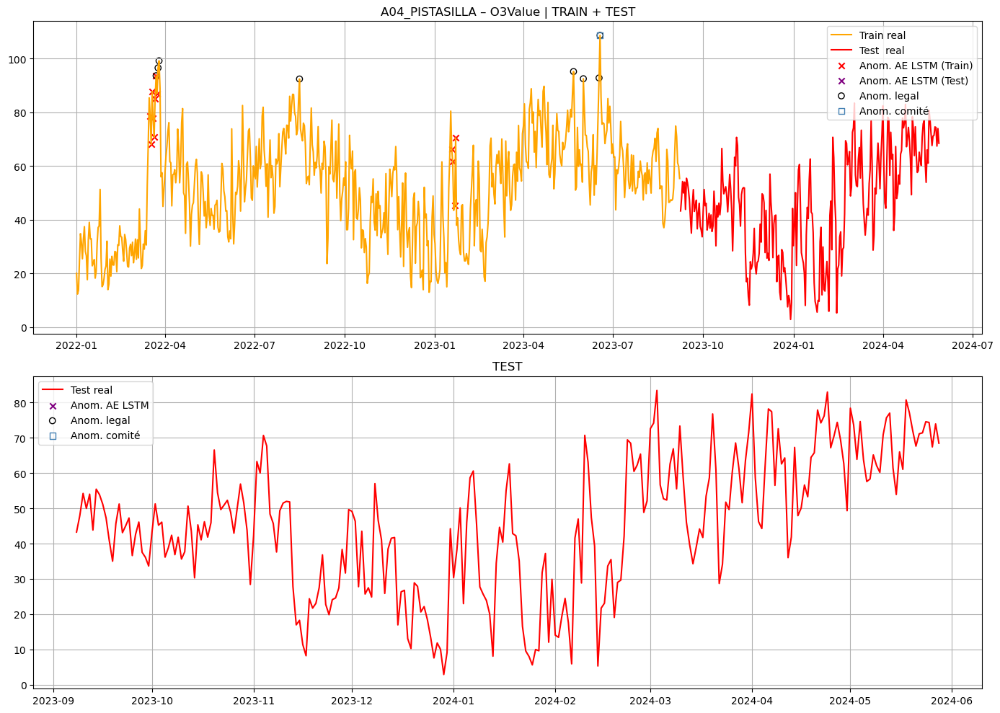

A09_CABANYAL – O3Value: Worksheet named 'A09_CABANYAL_O3_train' not found
A07_VALENCIACENTRE – O3Value: Worksheet named 'A07_VALENCIACENTRE_O3_train' not found


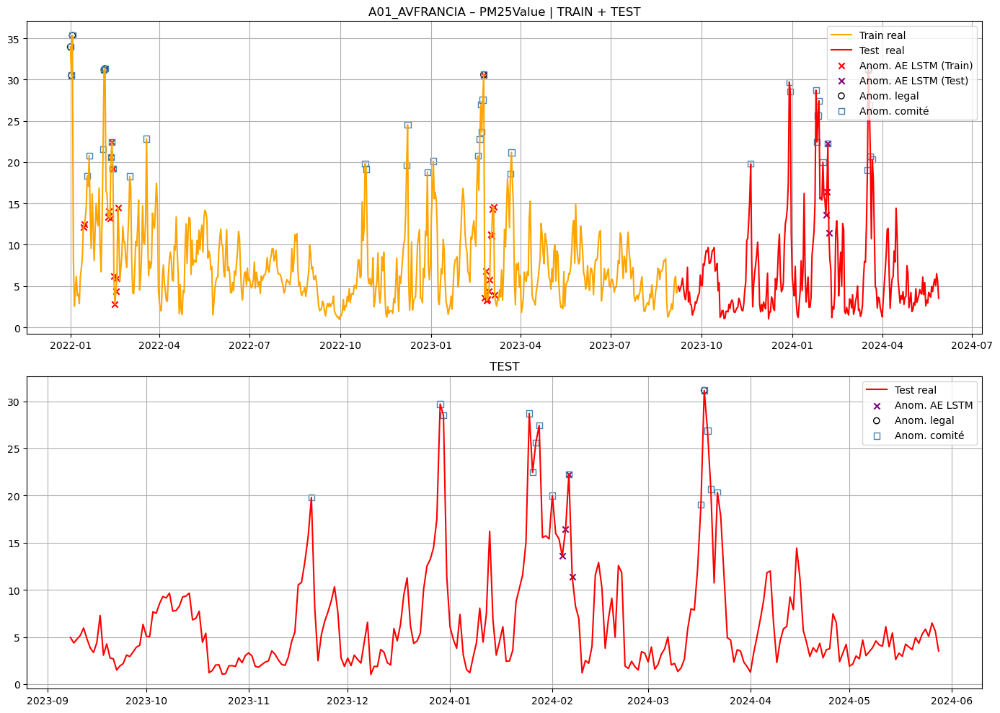

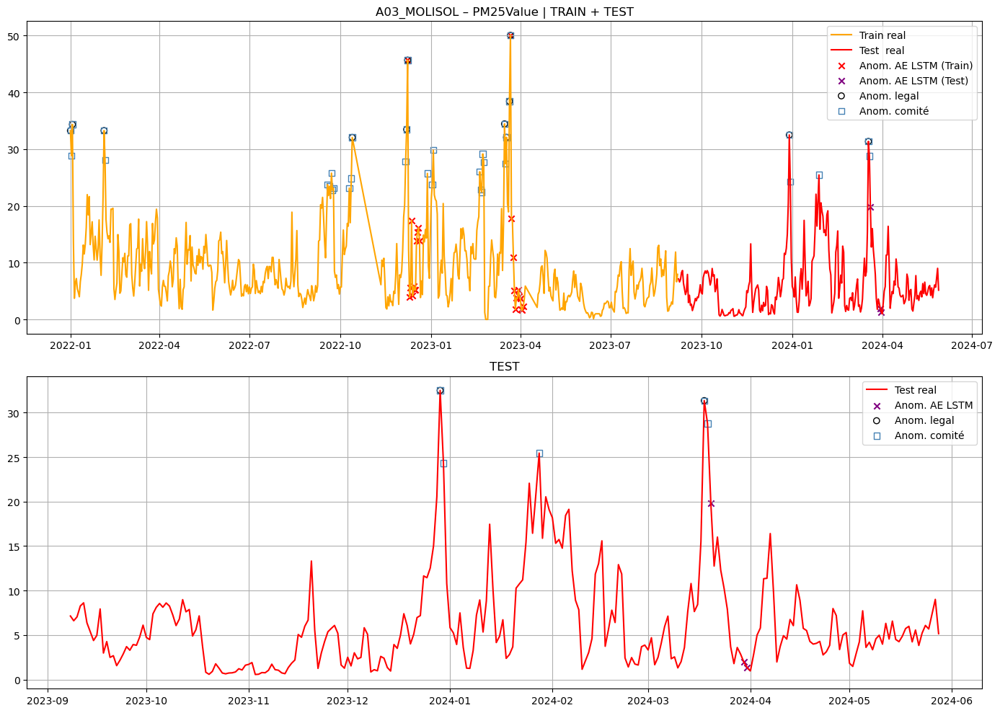

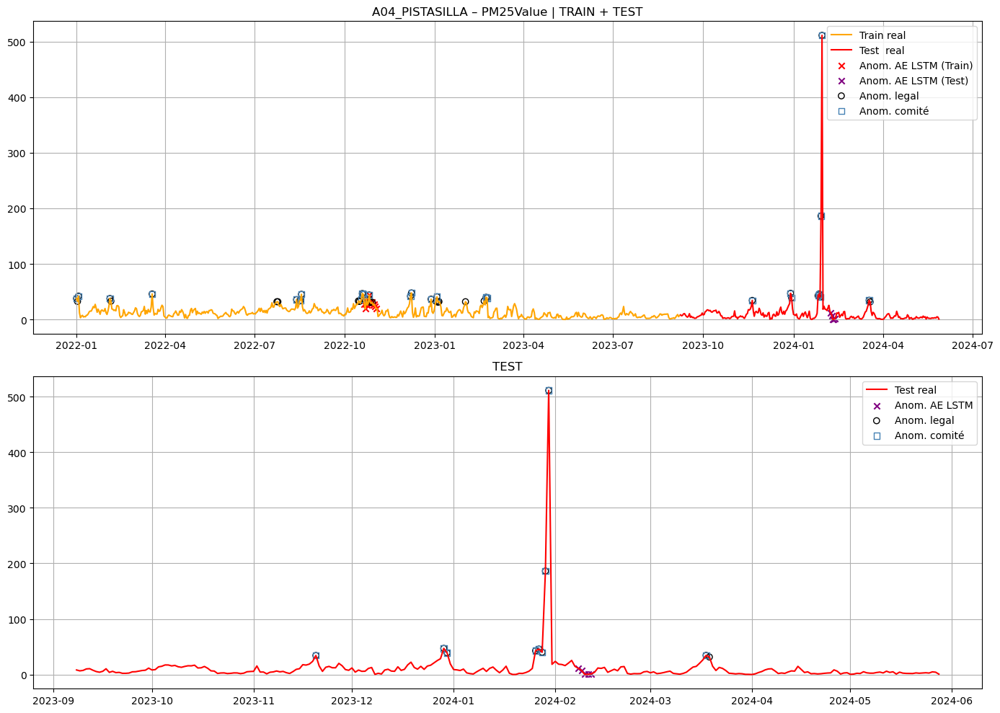

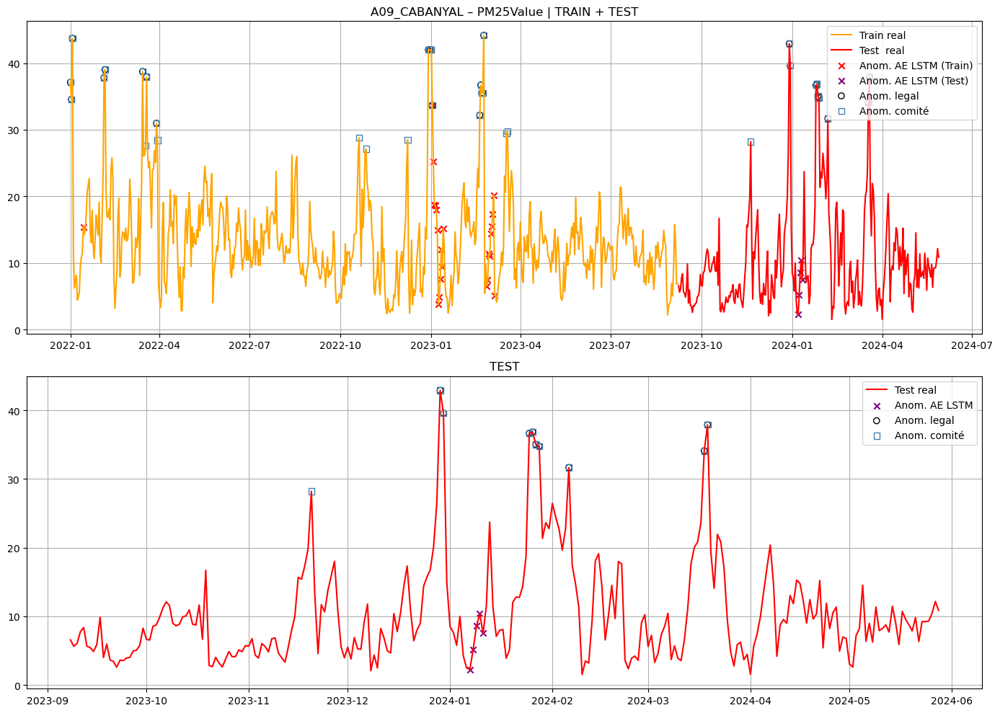

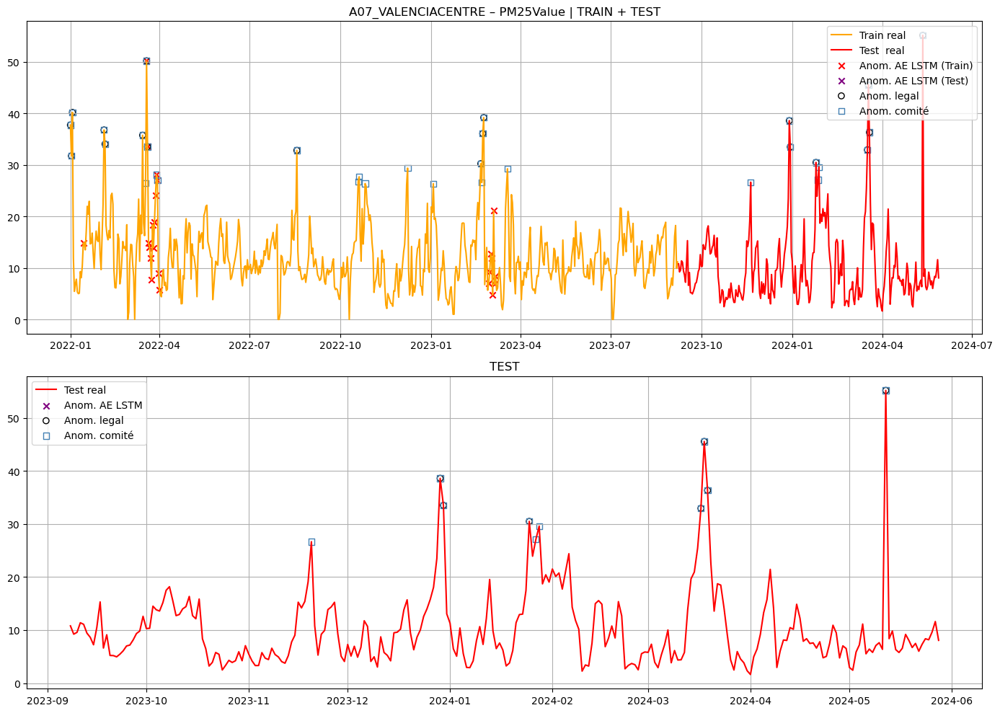

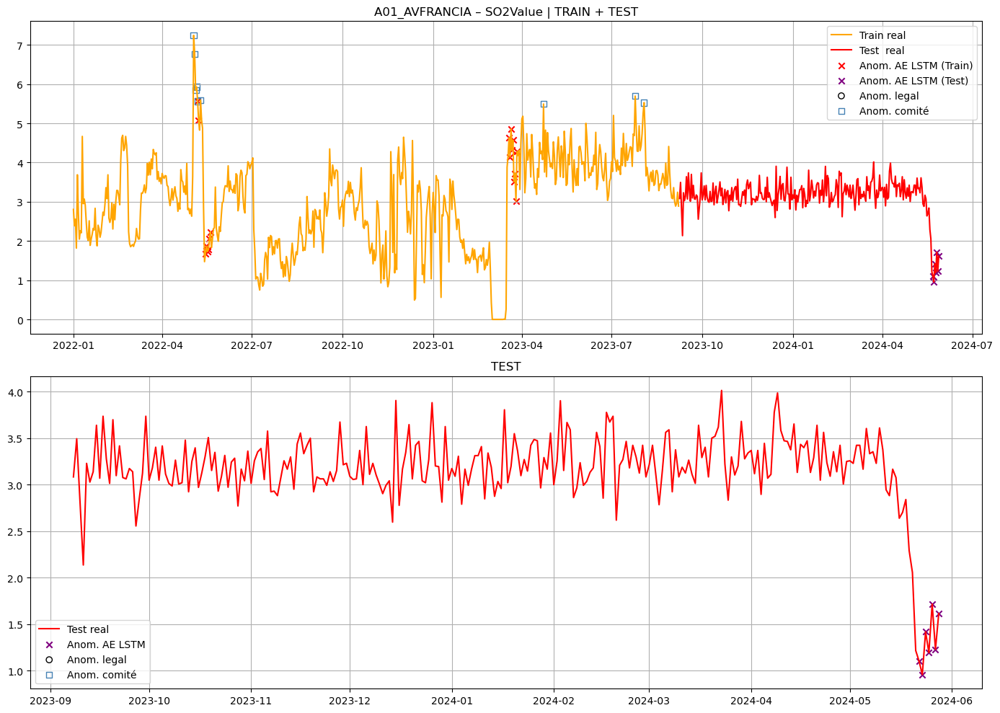

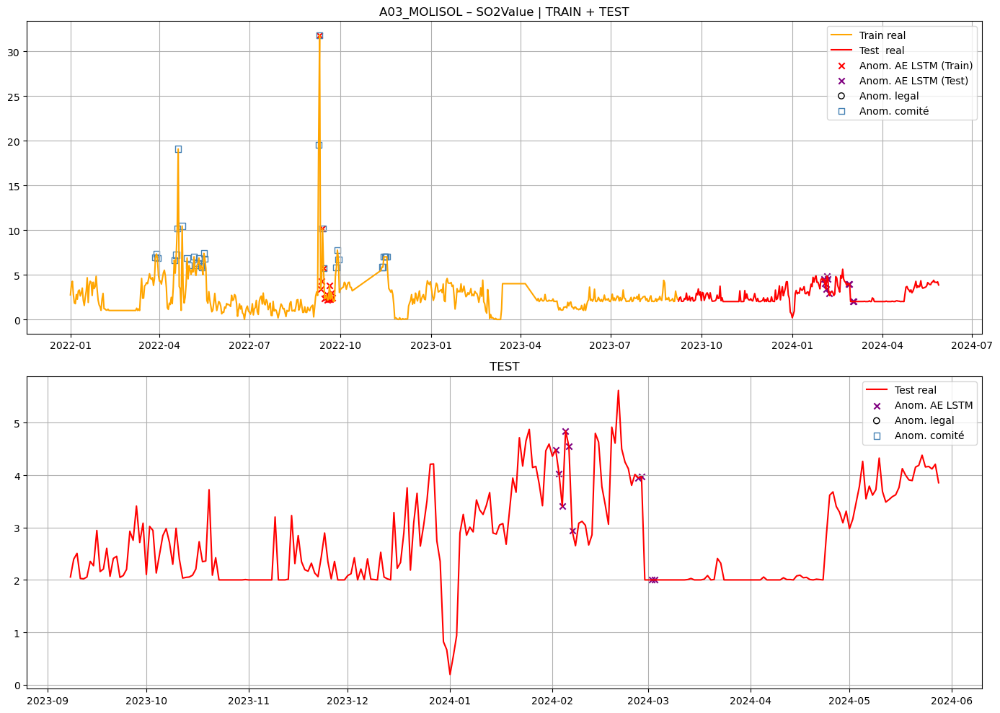

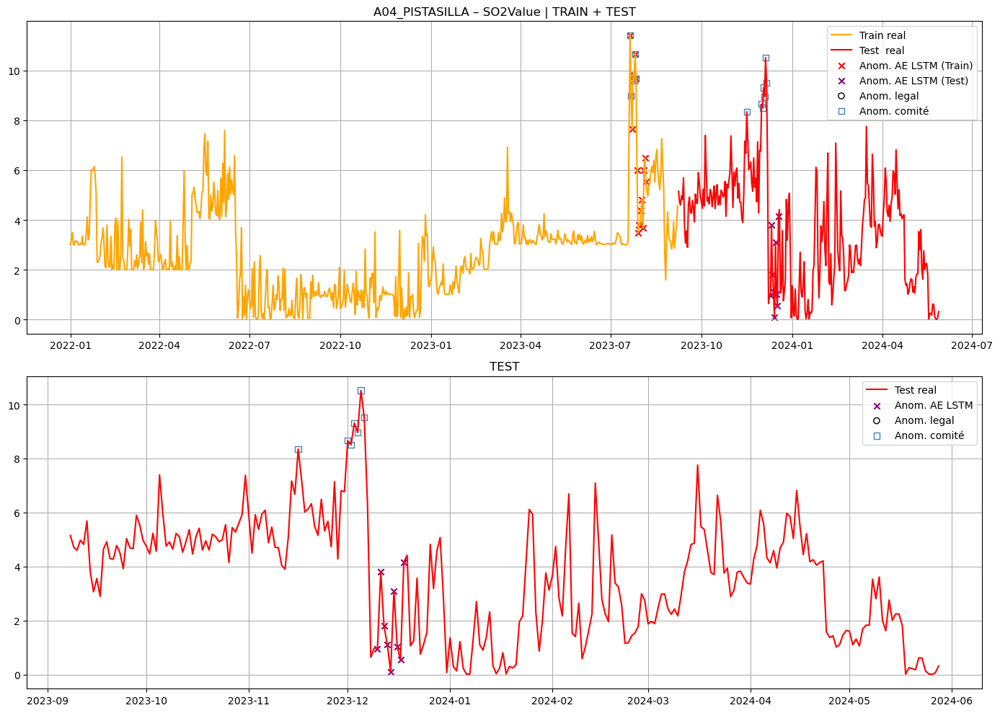

A09_CABANYAL – SO2Value: Worksheet named 'A09_CABANYAL_SO2_train' not found
A07_VALENCIACENTRE – SO2Value: Worksheet named 'A07_VALENCIACENTRE_SO2_train' not found


In [85]:
for cont in ['NO2Value','O3Value','PM25Value','SO2Value']:
    for est in estaciones_sel:
        est_short = est.replace('_10m','')
        try:
            visualizar_anomalias(
                ruta_excel="modelos/autoencoder/anomalias_AE_LSTM.xlsx",
                estacion=est_short,
                contaminante=cont,
                col_anom_modelo='anomaly_ae',
                modelo_label='AE LSTM'
            )
        except Exception as e:
            # si falta hoja o da error, lo saltamos
            print(f"{est_short} – {cont}: {e}")


PARA LAS ANOMALÍAS DEL COMITÉ

 A01_AVFRANCIA – NO2Value


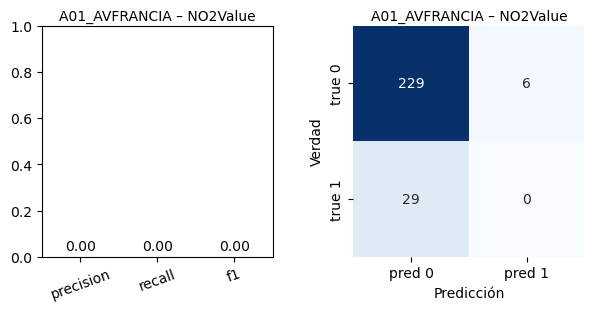


 A01_AVFRANCIA – O3Value


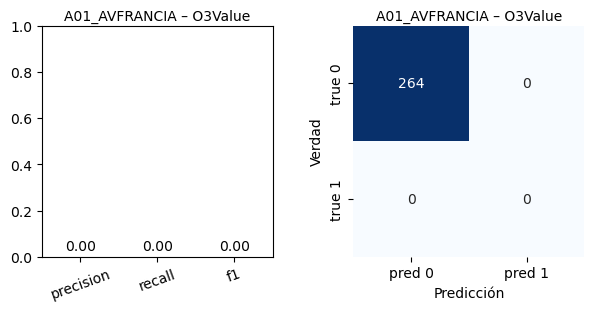


 A01_AVFRANCIA – PM25Value


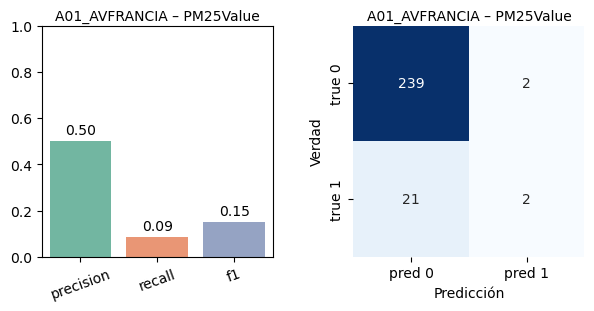


 A01_AVFRANCIA – SO2Value


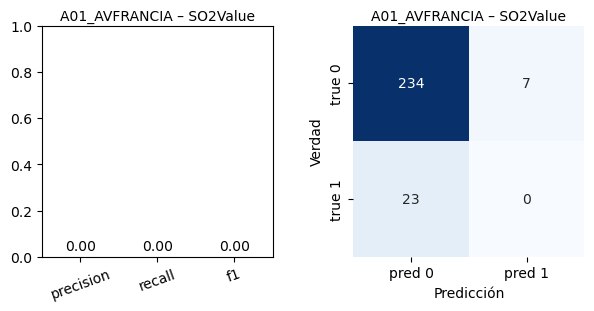


 A03_MOLISOL – NO2Value


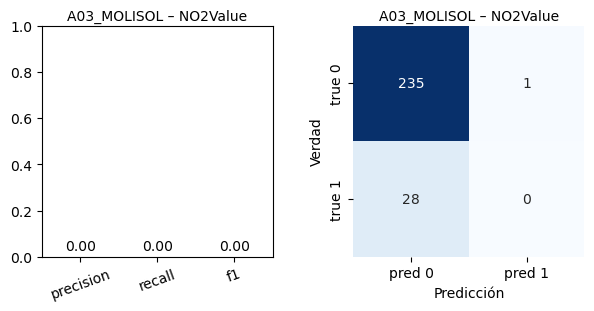


 A03_MOLISOL – O3Value


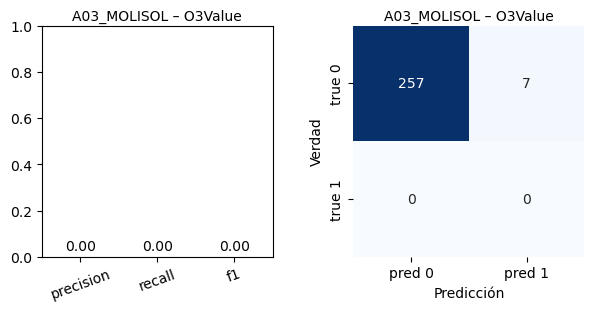


 A03_MOLISOL – PM25Value


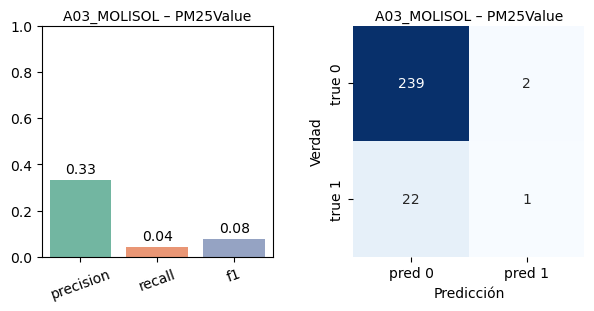


 A03_MOLISOL – SO2Value


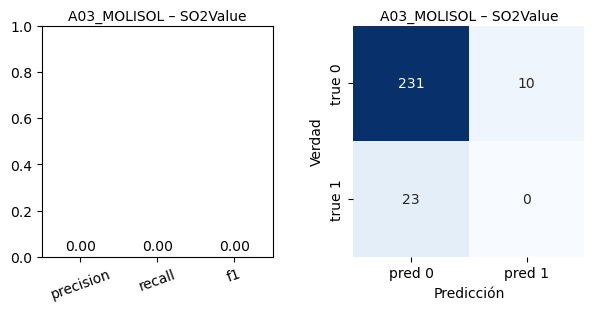


 A04_PISTASILLA – NO2Value


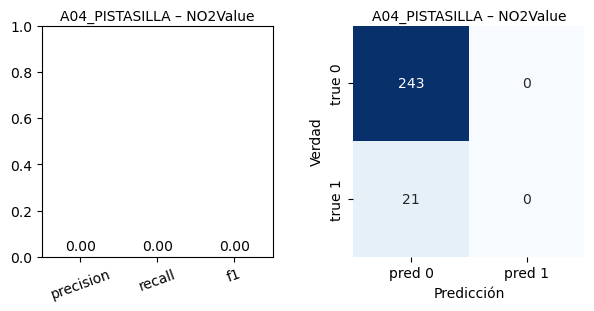


 A04_PISTASILLA – O3Value


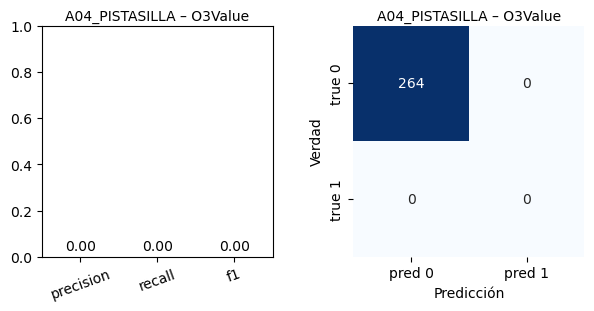


 A04_PISTASILLA – PM25Value


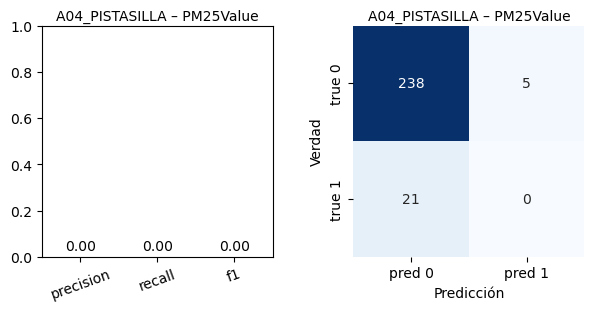


 A04_PISTASILLA – SO2Value


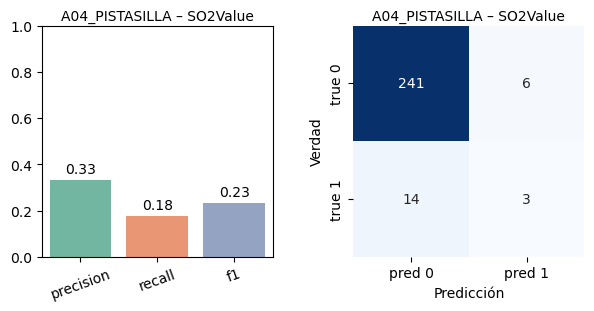


 A09_CABANYAL – NO2Value


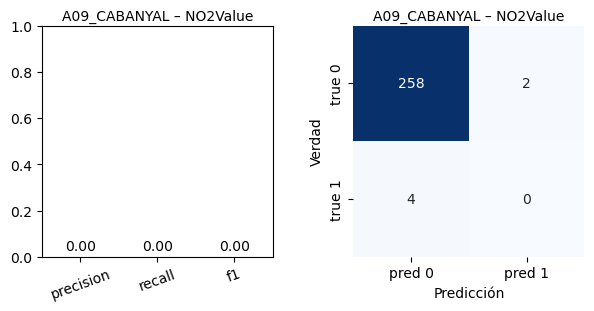


 A09_CABANYAL – PM25Value


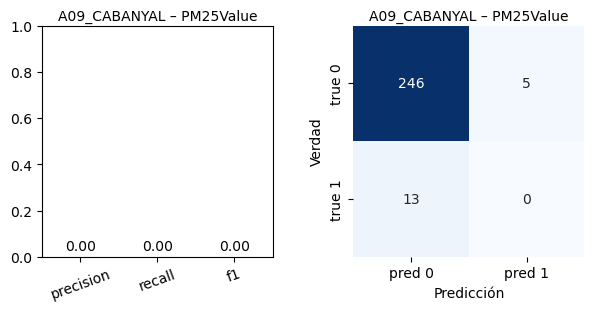


 A07_VALENCIACENTRE – NO2Value


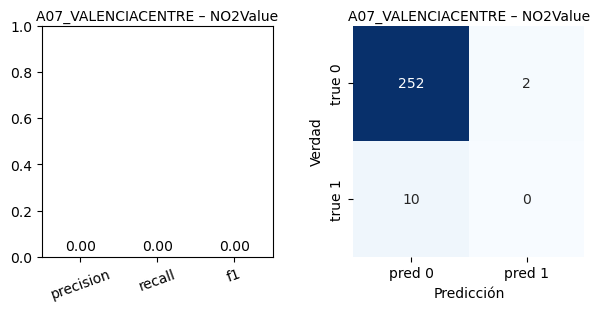


 A07_VALENCIACENTRE – PM25Value


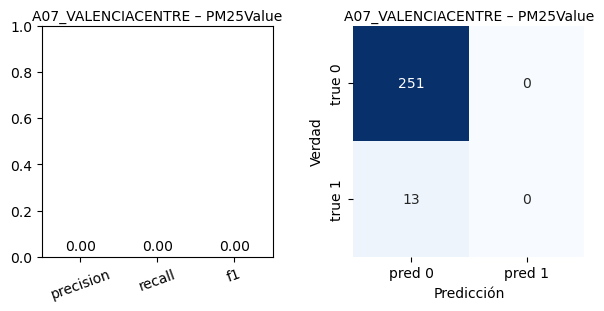

PARA LAS ANOMALÍAS LEGALES

 A01_AVFRANCIA – NO2Value


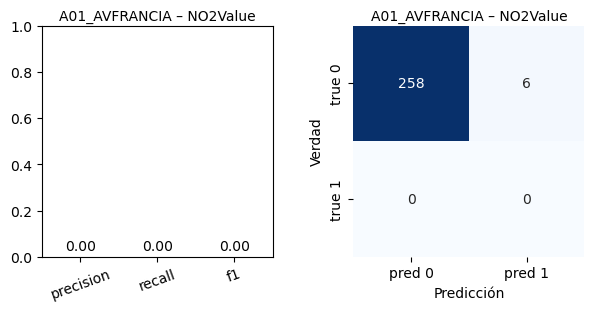


 A01_AVFRANCIA – O3Value


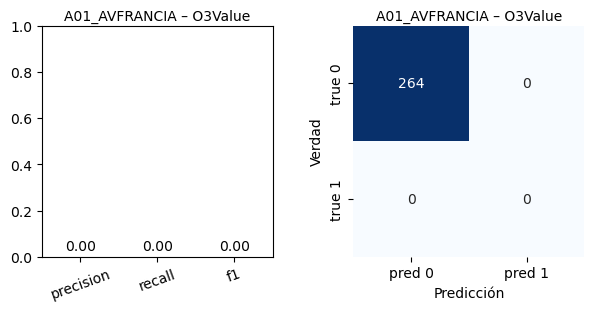


 A01_AVFRANCIA – PM25Value


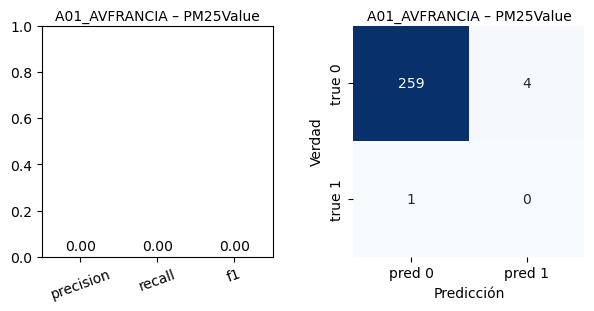


 A01_AVFRANCIA – SO2Value


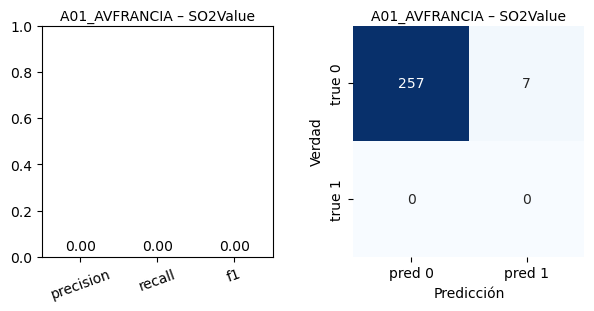


 A03_MOLISOL – NO2Value


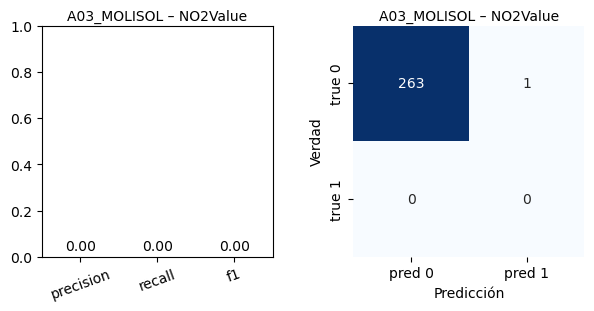


 A03_MOLISOL – O3Value


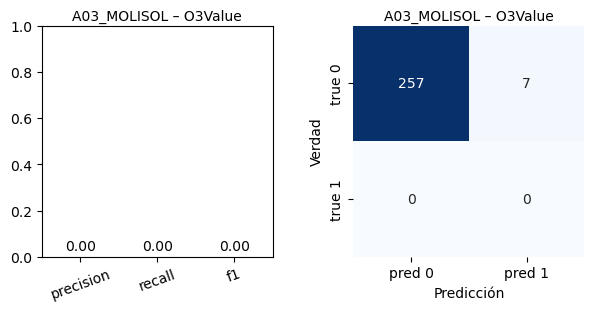


 A03_MOLISOL – PM25Value


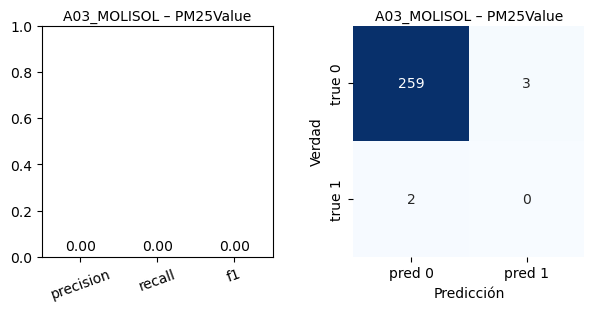


 A03_MOLISOL – SO2Value


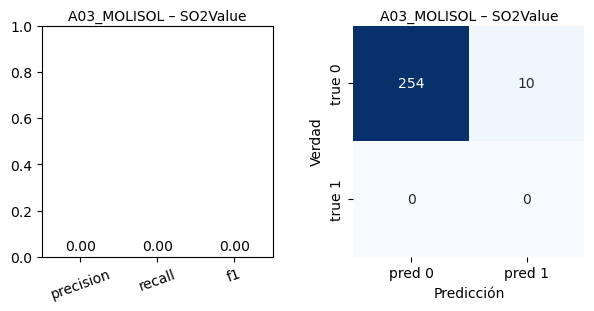


 A04_PISTASILLA – NO2Value


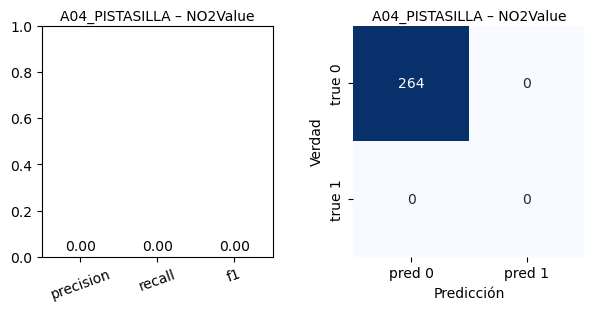


 A04_PISTASILLA – O3Value


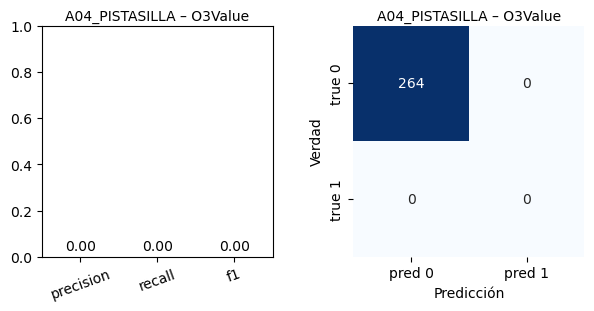


 A04_PISTASILLA – PM25Value


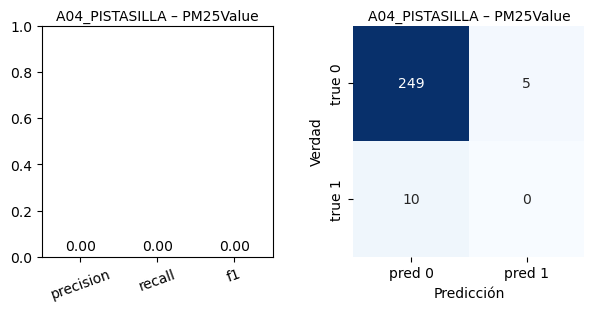


 A04_PISTASILLA – SO2Value


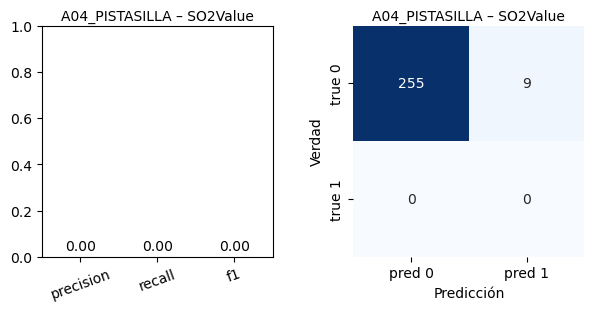


 A09_CABANYAL – NO2Value


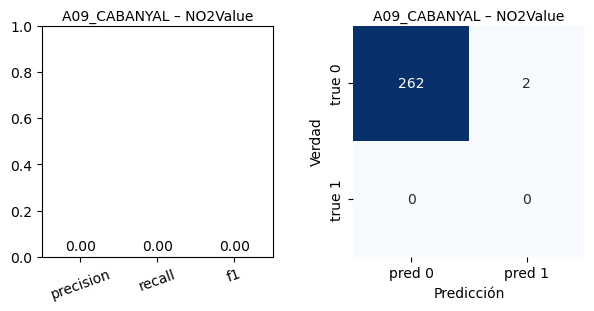


 A09_CABANYAL – PM25Value


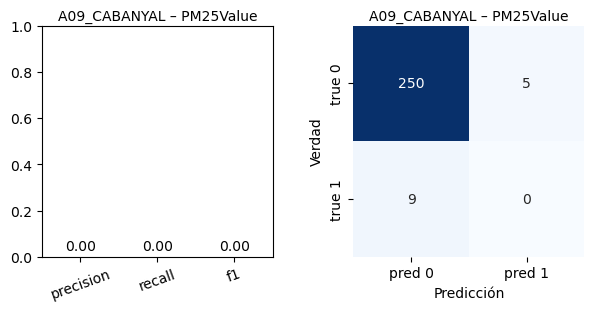


 A07_VALENCIACENTRE – NO2Value


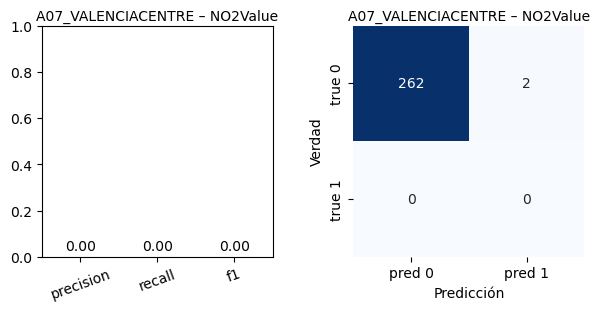


 A07_VALENCIACENTRE – PM25Value


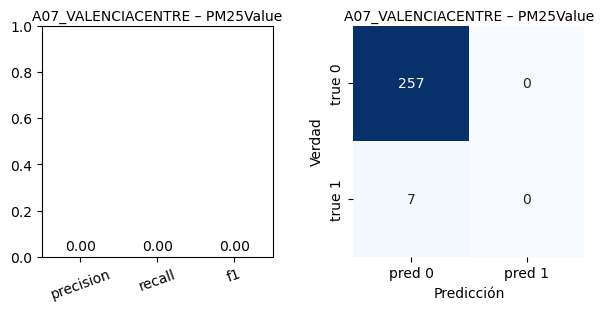

In [86]:
ruta = "modelos/autoencoder/anomalias_AE_LSTM.xlsx"
xlsx  = pd.ExcelFile(ruta)

print("PARA LAS ANOMALÍAS DEL COMITÉ")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_comite"
    col_modelo  = "anomaly_ae" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

print("PARA LAS ANOMALÍAS LEGALES")
for hoja in xlsx.sheet_names:
    # sólo nos interesan hojas *_test 
    if not hoja.endswith("_test"):
        continue

    df = xlsx.parse(hoja, index_col=0, parse_dates=True)
    partes = hoja.split("_")
    estacion = "_".join(partes[:2])
    cont_base = partes[2]
    contaminante = cont_base + "Value"
    etiqueta_ref = f"{contaminante}_anom_legal"
    col_modelo  = "anomaly_ae" 

    title_metrics = f"{estacion} – {contaminante}"
    print("\n", title_metrics)


    plot_metrics_confusion(df, etiqueta_ref, col_modelo, title_metrics)

### Tuning

In [87]:
def tune_autoencoder_lstm(
    df_train,
    etiqueta_ref,
    window_sizes=(14, 21, 28),
    latent_dims=(4, 8, 16),
    sigmas=(2, 2.5, 3),
    val_frac=0.2,
    epochs=40,
    batch_size=32,
    seed=42
):
    """
    Recorre combinaciones y elige la de mayor F1 en el bloque VAL.
    Devuelve:
      best_model, best_scaler, best_umbral, best_params, df_grid
    """
    # split temporal FIT / VAL
    split_idx = int(len(df_train) * (1 - val_frac))
    train_fit = df_train.iloc[:split_idx].copy()
    train_val = df_train.iloc[split_idx:].copy()

    grid_res = []

    for w, d, s in itertools.product(window_sizes, latent_dims, sigmas):

        # entrenamiento en FIT
        ae, scaler = entrenar_autoencoder_lstm(
            train_fit, window_size=w, latent_dim=d,
            epochs=epochs, batch_size=batch_size, seed=seed)

        # umbral en FIT
        X_fit, _ = crear_ventanas(train_fit, window_size=w,
                                  scaler=scaler, fit_scaler=False)
        err_fit = np.mean((ae.predict(X_fit, verbose=0) - X_fit) ** 2, axis=(1, 2))
        umbral = err_fit.mean() + s * err_fit.std()

        # evaluación en VAL
        X_val, _ = crear_ventanas(train_val, window_size=w,
                                  scaler=scaler, fit_scaler=False)
        err_val = np.mean((ae.predict(X_val, verbose=0) - X_val) ** 2, axis=(1, 2))
        idx_val = train_val.index[w - 1:]
        y_pred  = err_val > umbral
        y_true  = (train_val.loc[idx_val, etiqueta_ref]
                              .fillna(False).astype(int).values)
        f1 = 0.0 if y_true.sum() == 0 else f1_score(y_true, y_pred, zero_division=0)

        grid_res.append({
            'window_size': w, 'latent_dim': d, 'sigma': s,
            'f1_val': f1, 'umbral': umbral,
            'model': ae, 'scaler': scaler
        })

    df_grid = pd.DataFrame(grid_res).sort_values('f1_val', ascending=False)
    best = df_grid.iloc[0]

    return (
        best['model'],
        best['scaler'],
        best['umbral'],
        {'window_size': best['window_size'],
         'latent_dim':  best['latent_dim'],
         'sigma':       best['sigma'],
         'f1_val':      best['f1_val']},
        df_grid.drop(columns=['model', 'scaler'])
    )

In [93]:
resultados_ae = []

for (estacion, contaminante), df in st_anomalias.items():
    # Ground-truth para este contaminante
    col_ref = f"{contaminante}_anom_comite"
    if col_ref not in df.columns:
        continue        # no hay etiquetas Comité → saltamos

    # split TRAIN / TEST global
    df_train, _ = dividir_st(df)      

    # Grid-search interno (FIT / VAL) sobre el TRAIN
    best_ae, scaler, umbral, best_params, df_grid = tune_autoencoder_lstm(
        df_train,
        etiqueta_ref=col_ref,
        window_sizes=[14, 28],
        latent_dims=[4, 8, 16],
        sigmas=[2, 2.5, 3],
        epochs=40,
        batch_size=32,
        seed=42
    )

    # Añadimos contexto estación / contaminante a todas las filas del grid
    df_grid = df_grid.copy()
    df_grid["estacion"]     = estacion
    df_grid["contaminante"] = contaminante
    resultados_ae.append(df_grid)

# Concatenamos todos los resultados
df_all_ae = pd.concat(resultados_ae, ignore_index=True)

Epoch 1/40
15/15 [==============================] - 2s 7ms/step - loss: 0.1524
Epoch 2/40
15/15 [==============================] - 0s 6ms/step - loss: 0.1384
Epoch 3/40
15/15 [==============================] - 0s 7ms/step - loss: 0.1285
Epoch 4/40
15/15 [==============================] - 0s 5ms/step - loss: 0.1206
Epoch 5/40
15/15 [==============================] - 0s 6ms/step - loss: 0.1133
Epoch 6/40
15/15 [==============================] - 0s 5ms/step - loss: 0.1052
Epoch 7/40
15/15 [==============================] - 0s 6ms/step - loss: 0.0958
Epoch 8/40
15/15 [==============================] - 0s 7ms/step - loss: 0.0845
Epoch 9/40
15/15 [==============================] - 0s 5ms/step - loss: 0.0706
Epoch 10/40
15/15 [==============================] - 0s 6ms/step - loss: 0.0544
Epoch 11/40
15/15 [==============================] - 0s 6ms/step - loss: 0.0392
Epoch 12/40
15/15 [==============================] - 0s 7ms/step - loss: 0.0342
Epoch 13/40
15/15 [==============================

In [95]:
# Tomamos la mejor combinación (máx. f1_val) por serie
mejor_por_serie_ae = (
    df_all_ae
    .sort_values(["estacion", "contaminante", "f1_val"],
                 ascending=[True, True, False])
    .groupby(["estacion", "contaminante"], as_index=False)
    .first()
    [["estacion", "contaminante",
      "window_size", "latent_dim", "sigma",
      "f1_val"]]
)

print("Mejores parámetros AE por serie:")
print(mejor_por_serie_ae)

Mejores parámetros AE por serie:
                  estacion contaminante  window_size  latent_dim  sigma  \
0        A01_AVFRANCIA_10m     NO2Value           14           4    2.0   
1        A01_AVFRANCIA_10m      O3Value           14          16    3.0   
2        A01_AVFRANCIA_10m    PM25Value           14           4    2.0   
3        A01_AVFRANCIA_10m     SO2Value           14           4    2.0   
4          A03_MOLISOL_10m     NO2Value           14           4    2.0   
5          A03_MOLISOL_10m      O3Value           14           4    2.0   
6          A03_MOLISOL_10m    PM25Value           14           4    2.0   
7          A03_MOLISOL_10m     SO2Value           14           4    2.0   
8       A04_PISTASILLA_10m     NO2Value           14           4    2.0   
9       A04_PISTASILLA_10m      O3Value           14           4    2.0   
10      A04_PISTASILLA_10m    PM25Value           14           4    2.0   
11      A04_PISTASILLA_10m     SO2Value           28           4   